# CS5483 Data Warehousing & Data Mining
## Project 2
**Data Set:** Dry Bean Dataset Classification 
- https://www.kaggle.com/datasets/nimapourmoradi/dry-bean-dataset-classification/data
- Breif Summary: The project aimed at classify different types of beans using different measurements of the beans as feature


In [1]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn import *
from sklearn.metrics import *
from sklearn.multiclass import OneVsRestClassifier
from sklearn.preprocessing import label_binarize
from sklearn.preprocessing import LabelBinarizer, MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn import tree
import numpy as np
from itertools import cycle
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.express as px

## Reference
1. https://www.sciencedirect.com/science/article/pii/S2772375523000709#fig0002

# 1. Data Preprocessing

In [4]:
# Load the data from the CSV file
data = pd.read_csv("dataset/Dry_Bean_Dataset.csv")
data

,Area,Perimeter,MajorAxisLength,MinorAxisLength,AspectRation,Eccentricity,ConvexArea,EquivDiameter,Extent,Solidity,Roundness,Compactness,ShapeFactor1,ShapeFactor2,ShapeFactor3,ShapeFactor4,Class
0,28395,610.291,208.178117,173.888747,1.197191,0.549812,28715,190.141097,0.763923,0.988856,0.958027,0.913358,0.007332,0.003147,0.834222,0.998724,SEKER
1,28734,638.018,200.524796,182.734419,1.097356,0.411785,29172,191.272751,0.783968,0.984986,0.887034,0.953861,0.006979,0.003564,0.909851,0.998430,SEKER
2,29380,624.110,212.826130,175.931143,1.209713,0.562727,29690,193.410904,0.778113,0.989559,0.947849,0.908774,0.007244,0.003048,0.825871,0.999066,SEKER
3,30008,645.884,210.557999,182.516516,1.153638,0.498616,30724,195.467062,0.782681,0.976696,0.903936,0.928329,0.007017,0.003215,0.861794,0.994199,SEKER
4,30140,620.134,201.847882,190.279279,1.060798,0.333680,30417,195.896503,0.773098,0.990893,0.984877,0.970516,0.006697,0.003665,0.941900,0.999166,SEKER
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13606,42097,759.696,288.721612,185.944705,1.552728,0.765002,42508,231.515799,0.714574,0.990331,0.916603,0.801865,0.006858,0.001749,0.642988,0.998385,DERMASON
13607,42101,757.499,281.576392,190.713136,1.476439,0.735702,42494,231.526798,0.799943,0.990752,0.922015,0.822252,0.006688,0.001886,0.676099,0.998219,DERMASON
13608,42139,759.321,281.539928,191.187979,1.472582,0.734065,42569,231.631261,0.729932,0.989899,0.918424,0.822730,0.006681,0.001888,0.676884,0.996767,DERMASON
13609,42147,763.779,283.382636,190.275731,1.489326,0.741055,42667,231.653247,0.705389,0.987813,0.907906,0.817457,0.006724,0.001852,0.668237,0.995222,DERMASON


In [19]:
data.describe()

,Area,Perimeter,MajorAxisLength,MinorAxisLength,AspectRation,Eccentricity,ConvexArea,EquivDiameter,Extent,Solidity,Roundness,Compactness,ShapeFactor1,ShapeFactor2,ShapeFactor3,ShapeFactor4
count,13611.000000,13611.000000,13611.000000,13611.000000,13611.000000,13611.000000,13611.000000,13611.000000,13611.000000,13611.000000,13611.000000,13611.000000,13611.000000,13611.000000,13611.000000,13611.000000
mean,53048.284549,855.283459,320.141867,202.270714,1.583242,0.750895,53768.200206,253.064220,0.749733,0.987143,0.873282,0.799864,0.006564,0.001716,0.643590,0.995063
std,29324.095717,214.289696,85.694186,44.970091,0.246678,0.092002,29774.915817,59.177120,0.049086,0.004660,0.059520,0.061713,0.001128,0.000596,0.098996,0.004366
min,20420.000000,524.736000,183.601165,122.512653,1.024868,0.218951,20684.000000,161.243764,0.555315,0.919246,0.489618,0.640577,0.002778,0.000564,0.410339,0.947687
25%,36328.000000,703.523500,253.303633,175.848170,1.432307,0.715928,36714.500000,215.068003,0.718634,0.985670,0.832096,0.762469,0.005900,0.001154,0.581359,0.993703
50%,44652.000000,794.941000,296.883367,192.431733,1.551124,0.764441,45178.000000,238.438026,0.759859,0.988283,0.883157,0.801277,0.006645,0.001694,0.642044,0.996386
75%,61332.000000,977.213000,376.495012,217.031741,1.707109,0.810466,62294.000000,279.446467,0.786851,0.990013,0.916869,0.834270,0.007271,0.002170,0.696006,0.997883
max,254616.000000,1985.370000,738.860154,460.198497,2.430306,0.911423,263261.000000,569.374358,0.866195,0.994677,0.990685,0.987303,0.010451,0.003665,0.974767,0.999733


## 1.2. Data Representation

- There is total 7 kind of beans (Classes), and the class is not balanced.

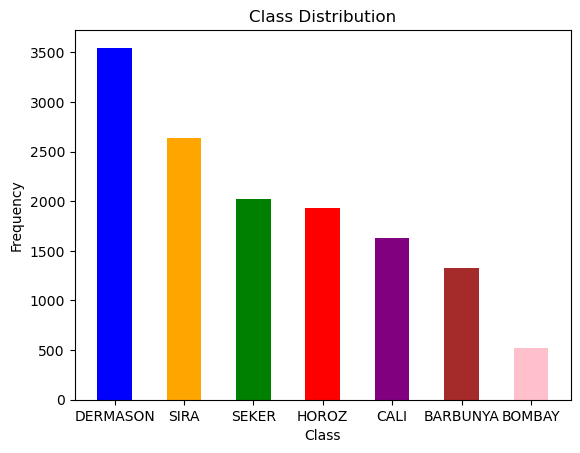

Class
DERMASON    3546
SIRA        2636
SEKER       2027
HOROZ       1928
CALI        1630
BARBUNYA    1322
BOMBAY       522
Name: count, dtype: int64


In [5]:
color_rgb = ["blue", "orange", "green", "red", "purple", "brown", "pink"]

class_dict = data['Class'].value_counts().to_dict()
colors = dict(zip(class_dict.keys(), color_rgb))


plt.bar(class_dict.keys(), class_dict.values(), width = 0.5, align='center', color=color_rgb)
plt.title("Class Distribution")
plt.xlabel('Class'); plt.ylabel('Frequency')
plt.show()

print(data['Class'].value_counts())

- Here are the different features optained from the dimention/weight/geotmetric shape of the bean 


![Beans](https://ars.els-cdn.com/content/image/1-s2.0-S2772375523000709-gr1.jpg) ![Attributes](https://ars.els-cdn.com/content/image/1-s2.0-S2772375523000709-gr2.jpg)

In [6]:
def plot_feature_distribution(data_plot, title = None):
    fig = make_subplots(rows=4, cols=4, subplot_titles = data_plot.columns)

    row = 1
    col = 1
    for classname in data_plot.columns:
        if classname != "Class":
            fig.add_trace(
                go.Histogram(x=data_plot[classname], name=classname),
                row=row, col=col
            )
            fig.update_xaxes(title_text='Values', row=row, col=col)
            fig.update_yaxes(title_text='Frequency', row=row, col=col)
            if col == 4:
                col = 1
                row += 1
            else:
                col += 1
    fig.update_annotations(font_size=14)
    fig.update_layout(
        autosize=True,
        width=1600,
        height=1000,
        showlegend=False,
        font=dict(
            size=8
        ), title= {'text':title, 'font_size':16})
    fig.show()

In [4]:
plot_feature_distribution(data, "Feature Distibution")

## 1.3. Normalization
- Trying to do normalization on the data, by both z-score and min-max

### 1.3.1. Z-score Normalization

In [5]:
scaler = StandardScaler()
data = pd.read_csv("dataset/Dry_Bean_Dataset.csv")
data.iloc[:,0:-1] = scaler.fit_transform(data.iloc[:,0:-1].to_numpy())
data

,Area,Perimeter,MajorAxisLength,MinorAxisLength,AspectRation,Eccentricity,ConvexArea,EquivDiameter,Extent,Solidity,Roundness,Compactness,ShapeFactor1,ShapeFactor2,ShapeFactor3,ShapeFactor4,Class
0,-0.840749,-1.143319,-1.306598,-0.631153,-1.565053,-2.185720,-0.841451,-1.063341,0.289087,0.367614,1.423867,1.839116,0.680786,2.402173,1.925723,0.838371,SEKER
1,-0.829188,-1.013924,-1.395911,-0.434445,-1.969784,-3.686040,-0.826102,-1.044217,0.697477,-0.462907,0.231054,2.495449,0.367967,3.100894,2.689702,0.771138,SEKER
2,-0.807157,-1.078829,-1.252357,-0.585735,-1.514291,-2.045336,-0.808704,-1.008084,0.578195,0.518417,1.252865,1.764843,0.603129,2.235091,1.841356,0.916755,SEKER
3,-0.785741,-0.977215,-1.278825,-0.439290,-1.741618,-2.742211,-0.773975,-0.973337,0.671260,-2.241767,0.515049,2.081715,0.401718,2.515075,2.204250,-0.197985,SEKER
4,-0.781239,-1.097384,-1.380471,-0.266663,-2.117993,-4.535028,-0.784286,-0.966080,0.476020,0.804772,1.874992,2.765330,0.118268,3.270983,3.013462,0.939640,SEKER
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13606,-0.373471,-0.446083,-0.366669,-0.363055,-0.123703,0.153343,-0.378191,-0.364148,-0.716284,0.684173,0.727872,0.032433,0.261424,0.055629,-0.006086,0.760813,DERMASON
13607,-0.373334,-0.456336,-0.450053,-0.257015,-0.432979,-0.165141,-0.378662,-0.363962,1.022933,0.774384,0.818807,0.362794,0.110383,0.285117,0.328393,0.722659,DERMASON
13608,-0.372038,-0.447833,-0.450478,-0.246456,-0.448618,-0.182940,-0.376143,-0.362197,-0.403392,0.591370,0.758468,0.370533,0.104270,0.289205,0.336328,0.390251,DERMASON
13609,-0.371765,-0.427029,-0.428974,-0.266742,-0.380735,-0.106960,-0.372851,-0.361825,-0.903414,0.143717,0.581753,0.285098,0.141907,0.228375,0.248973,0.036440,DERMASON


In [6]:
plot_feature_distribution(data, "Feature Distibution with Z-score Normalization")

In [7]:
data.to_csv('dataset/Dry_Bean_Dataset_z_score.csv', index=False)  

### 1.3.2. Min-max Normalization

In [8]:
scaler = MinMaxScaler()
data = pd.read_csv("dataset/Dry_Bean_Dataset.csv")
data.iloc[:,0:-1] = scaler.fit_transform(data.iloc[:,0:-1].to_numpy())
data

,Area,Perimeter,MajorAxisLength,MinorAxisLength,AspectRation,Eccentricity,ConvexArea,EquivDiameter,Extent,Solidity,Roundness,Compactness,ShapeFactor1,ShapeFactor2,ShapeFactor3,ShapeFactor4,Class
0,0.034053,0.058574,0.044262,0.152142,0.122612,0.477797,0.033107,0.070804,0.671024,0.922824,0.934823,0.786733,0.593432,0.833049,0.750996,0.980620,SEKER
1,0.035500,0.077557,0.030479,0.178337,0.051577,0.278472,0.034991,0.073577,0.735504,0.871514,0.793138,0.903549,0.547447,0.967316,0.884987,0.974979,SEKER
2,0.038259,0.068035,0.052633,0.158190,0.131521,0.496448,0.037126,0.078816,0.716671,0.932141,0.914511,0.773514,0.582016,0.800942,0.736200,0.987196,SEKER
3,0.040940,0.082942,0.048548,0.177691,0.091623,0.403864,0.041389,0.083854,0.731365,0.761614,0.826871,0.829912,0.552408,0.854744,0.799846,0.893675,SEKER
4,0.041504,0.065313,0.032862,0.200679,0.025565,0.165680,0.040123,0.084906,0.700538,0.949832,0.988408,0.951583,0.510741,1.000000,0.941770,0.989116,SEKER
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13606,0.092559,0.160862,0.189318,0.187843,0.375584,0.788553,0.089967,0.172180,0.512286,0.942381,0.852151,0.465175,0.531785,0.382135,0.412185,0.974113,DERMASON
13607,0.092576,0.159358,0.176450,0.201964,0.321303,0.746241,0.089910,0.172207,0.786890,0.947954,0.862952,0.523974,0.509582,0.426233,0.470848,0.970912,DERMASON
13608,0.092739,0.160605,0.176384,0.203370,0.318558,0.743877,0.090219,0.172463,0.561689,0.936648,0.855785,0.525351,0.508683,0.427019,0.472240,0.943025,DERMASON
13609,0.092773,0.163657,0.179703,0.200669,0.330472,0.753971,0.090623,0.172517,0.482741,0.908991,0.834795,0.510145,0.514216,0.415330,0.456919,0.913342,DERMASON


In [9]:
plot_feature_distribution(data, "Feature Distibution with Min-max Normalization")

In [10]:
data.to_csv('dataset/Dry_Bean_Dataset_min_max.csv', index=False)  

## 1.4. Feature Selection

### 1.4.1. Correlation-based Feature Selection
- https://www.cs.waikato.ac.nz/~mhall/thesis.pdf

From Weka

>
>```text
>== Run information ===  
>
>Evaluator:    weka.attributeSelection.CfsSubsetEval -P 1 -E 1  
>Search:       weka.attributeSelection.BestFirst -D 1 -N 5  
>Relation:     Dry_Bean_Dataset  
>Instances:    13611  
>Attributes:   17  
>              ﻿Area  
>              Perimeter  
>              MajorAxisLength  
>              MinorAxisLength  
>              AspectRation  
>              Eccentricity  
>              ConvexArea  
>              EquivDiameter  
>              Extent  
>              Solidity  
>              roundness  
>              Compactness  
>              ShapeFactor1  
>              ShapeFactor2  
>              ShapeFactor3  
>              ShapeFactor4  
>              Class  
>Evaluation mode:    evaluate on all training data
>=== Attribute Selection on all input data ===
>
>Search Method:
>	Best first.
>	Start set: no attributes
>	Search direction: forward
>	Stale search after 5 node expansions
>	Total number of subsets evaluated: 137
>	Merit of best subset found:    0.682
>
>Attribute Subset Evaluator (supervised, Class (nominal): 17 Class):
>	CFS Subset Evaluator
>	Including locally predictive attributes
>
>Selected attributes: 2,3,4,5,7,9,11,12,13,14,16 : 11
>                     Perimeter
>                     MajorAxisLength
>                     MinorAxisLength
>                     AspectRation
>                     ConvexArea
>                     Extent
>                     roundness
>                     Compactness
>                     ShapeFactor1
>                     ShapeFactor2
>                     ShapeFactor4
>
>```

In [4]:
col = data.columns.tolist()
col.remove('Class')
# Selected attributes: 2,3,4,5,7,9,11,12,13,14,16 : 11
attr_col = [2,3,4,5,7,9,11,12,13,14,16]
feature_sel_cfs = []
for i in attr_col:
    feature_sel_cfs.append(col[i-1])
    print(col[i-1])

Perimeter
MajorAxisLength
MinorAxisLength
AspectRation
ConvexArea
Extent
Roundness
Compactness
ShapeFactor1
ShapeFactor2
ShapeFactor4


### 1.4.2. Infomation Gain

>```text
>=== Run information ===
>
>Evaluator:    weka.attributeSelection.InfoGainAttributeEval 
>Search:       weka.attributeSelection.Ranker -T -1.7976931348623157E308 -N -1
>Relation:     Dry_Bean_Dataset
>Instances:    13611
>Attributes:   17
>              ﻿Area
>              Perimeter
>              MajorAxisLength
>              MinorAxisLength
>              AspectRation
>              Eccentricity
>              ConvexArea
>              EquivDiameter
>              Extent
>              Solidity
>              roundness
>              Compactness
>              ShapeFactor1
>              ShapeFactor2
>              ShapeFactor3
>              ShapeFactor4
>              Class
>Evaluation mode:    evaluate on all training data
>
>=== Attribute Selection on all input data ===
>
>Search Method:
>	Attribute ranking.
>
>Attribute Evaluator (supervised, Class (nominal): 17 Class):
>	Information Gain Ranking Filter
>
>Ranked attributes:
> 1.524   2 Perimeter
> 1.49    7 ConvexArea
> 1.484   1 ﻿Area
> 1.484   8 EquivDiameter
> 1.437   3 MajorAxisLength
> 1.376  14 ShapeFactor2
> 1.329  13 ShapeFactor1
> 1.328   4 MinorAxisLength
> 1.192  15 ShapeFactor3
> 1.192  12 Compactness
> 1.175   5 AspectRation
> 1.175   6 Eccentricity
> 1.147  11 roundness
> 0.533  16 ShapeFactor4
> 0.34   10 Solidity
> 0.284   9 Extent
>
>Selected attributes: 2,7,1,8,3,14,13,4,15,12,5,6,11,16,10,9 : 16
>


## 1.5. Nosie
- The idea is add noise to the data to make the classifier more robust

### 1.5.1. Gaussian Noise
- 10% Gaussian Noise is added to Z-score normalized Data

In [29]:
data_z_score = pd.read_csv('dataset/Dry_Bean_Dataset_z_score.csv')
col = data_z_score.columns.tolist()
col.remove('Class')
data_noise = data_z_score[col]
mu = 0.0
std = 0.1
noise = np.random.normal(mu, std, size = data_noise.shape)
fig = px.histogram(noise.flatten())
fig.update_layout(showlegend=False, title= {'text':"Gaussian Noise", 'font_size':16})
fig.show()

In [30]:
data_gaussian = data_noise + noise
data_gaussian['Class'] = data_z_score['Class']
data_gaussian

,Area,Perimeter,MajorAxisLength,MinorAxisLength,AspectRation,Eccentricity,ConvexArea,EquivDiameter,Extent,Solidity,Roundness,Compactness,ShapeFactor1,ShapeFactor2,ShapeFactor3,ShapeFactor4,Class
0,-0.790632,-1.022952,-1.345106,-0.681279,-1.429158,-2.257254,-0.911901,-1.152906,0.448227,0.383294,1.475867,1.719771,0.763696,2.509794,1.823227,0.783568,SEKER
1,-0.853324,-0.834244,-1.636460,-0.497684,-1.911337,-3.513635,-0.752249,-1.009076,0.707190,-0.454720,0.165202,2.556918,0.388995,3.189542,2.716807,0.567806,SEKER
2,-0.745727,-1.077677,-1.366690,-0.472065,-1.450097,-2.026648,-0.832583,-1.014504,0.515924,0.281409,1.246012,1.692650,0.559518,2.294116,1.964960,0.993335,SEKER
3,-0.747707,-1.171468,-1.350123,-0.431619,-1.799360,-2.668511,-0.835149,-0.851202,0.817115,-2.163952,0.659185,2.066685,0.459331,2.442743,2.172716,-0.093529,SEKER
4,-0.853782,-1.048789,-1.291522,-0.246779,-2.075170,-4.475348,-0.590132,-1.028464,0.514893,0.749887,1.846322,2.798064,0.123744,3.354325,2.928433,0.923329,SEKER
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13606,-0.245582,-0.401405,-0.364941,-0.340912,-0.149729,0.145118,-0.280071,-0.377529,-0.663848,0.521311,0.750832,0.135129,0.227610,0.017427,0.058635,0.650523,DERMASON
13607,-0.312533,-0.379365,-0.394735,-0.178669,-0.533749,-0.202455,-0.265878,-0.299320,1.042796,0.755439,0.758709,0.457025,0.059310,0.183321,0.193010,0.782856,DERMASON
13608,-0.362323,-0.398363,-0.528168,-0.025133,-0.489793,-0.213448,-0.508837,-0.389950,-0.352650,0.505547,0.734071,0.424368,0.219414,0.268623,0.239307,0.145392,DERMASON
13609,-0.374945,-0.439968,-0.388948,-0.215859,-0.347612,-0.159439,-0.358140,-0.379568,-0.818665,-0.013434,0.510626,0.219796,0.265100,0.203342,0.348757,0.221612,DERMASON


In [31]:
plot_feature_distribution(data_gaussian, "Feature Distibution with Gaussian Noise")

In [32]:
data_gaussian.to_csv('dataset/Dry_Bean_Dataset_gaussian.csv', index=False)  

## 1.6 Imbalanced data

### 1.6.1 SMOTE

In [ ]:
# install imblanced
!pip install imbalanced

# if failed to run, plz use the following
#!conda install -c conda-forge imbalanced-learn

In [13]:
from collections import Counter
data_norm = pd.read_csv("dataset/Dry_Bean_Dataset_z_score.csv")
x = data_z_score[feature_sel_cfs]
y = data_z_score['Class']
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2)
X_test = X_test.to_numpy()
X_train = X_train.to_numpy()
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()


In [14]:
# Before SMOTE
print(Counter(y))

Counter({'DERMASON': 3546, 'SIRA': 2636, 'SEKER': 2027, 'HOROZ': 1928, 'CALI': 1630, 'BARBUNYA': 1322, 'BOMBAY': 522})


In [17]:
from imblearn.over_sampling import SMOTE

smo = SMOTE(random_state=42, k_neighbors=10)
X_smo, y_smo = smo.fit_resample(x, y)
smo_xy = X_smo.join(y_smo)

Counter({'SEKER': 3546, 'BARBUNYA': 3546, 'BOMBAY': 3546, 'CALI': 3546, 'HOROZ': 3546, 'SIRA': 3546, 'DERMASON': 3546})


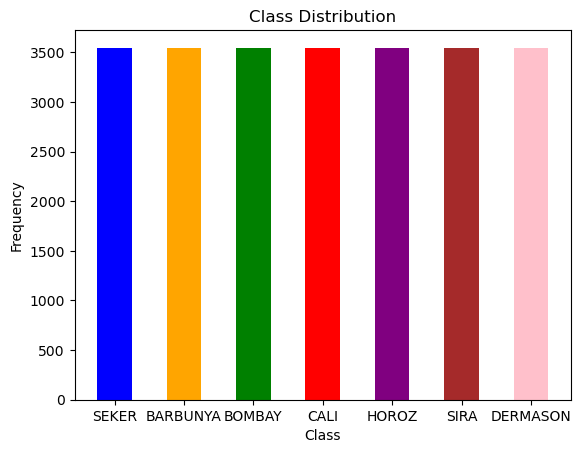

Class
SEKER       3546
BARBUNYA    3546
BOMBAY      3546
CALI        3546
HOROZ       3546
SIRA        3546
DERMASON    3546
Name: count, dtype: int64


In [18]:
print(Counter(y_smo))
color_rgb = ["blue", "orange", "green", "red", "purple", "brown", "pink"]

class_dict = smo_xy['Class'].value_counts().to_dict()
colors = dict(zip(class_dict.keys(), color_rgb))


plt.bar(class_dict.keys(), class_dict.values(), width = 0.5, align='center', color=color_rgb)
plt.title("Class Distribution")
plt.xlabel('Class'); plt.ylabel('Frequency')
plt.show()

print(smo_xy['Class'].value_counts())

In [19]:
smo_xy.to_csv('dataset/Dry_Bean_Dataset_smote.csv', index=False)

# 2. Classification

In [2]:
# Reload the data
data = pd.read_csv("dataset/Dry_Bean_Dataset.csv")
data_z_score = pd.read_csv('dataset/Dry_Bean_Dataset_z_score.csv')
data_min_max = pd.read_csv('dataset/Dry_Bean_Dataset_min_max.csv')
data_gaussian = pd.read_csv('dataset/Dry_Bean_Dataset_gaussian.csv')
data_smote = pd.read_csv("dataset/Dry_Bean_Dataset_smote.csv")
data_norm = pd.read_csv("dataset/Dry_Bean_Dataset_z_score.csv")

col = data.columns.tolist()
col.remove('Class')
# Selected attributes: 2,3,4,5,7,9,11,12,13,14,16 : 11
attr_col = [2,3,4,5,7,9,11,12,13,14,16]
feature_sel_cfs = []
for i in attr_col:
    feature_sel_cfs.append(col[i-1])

col = data.columns.tolist()
col.remove('Class')
# deselect the attributes with negative info gain
attr_col = [2,7,1,8,3,14,13,4,15,12,5,6,11]
feature_sel_info_gain = []
for i in attr_col:
    feature_sel_info_gain.append(col[i-1])

# Use one-hot encoding for class labels
encoder = LabelBinarizer()
y_1hot = encoder.fit_transform(data['Class'])

class_1hot = np.array([[1,0,0,0,0,0,0], [0,1,0,0,0,0,0], [0,0,1,0,0,0,0], [0,0,0,1,0,0,0], [0,0,0,0,1,0,0], [0,0,0,0,0,1,0], [0,0,0,0,0,0,1]])
class_label_order = encoder.inverse_transform(class_1hot)

col = data.columns.tolist()
col.remove('Class')

- Helper Functions


- Plot ROC Reference: https://scikit-learn.org/1.1/auto_examples/model_selection/plot_roc.html
- Plot PRC Reference: https://scikit-learn.org/stable/auto_examples/model_selection/plot_precision_recall.html#sphx-glr-auto-examples-model-selection-plot-precision-recall-py
- Another alternative: https://stackoverflow.com/questions/56090541/how-to-plot-precision-and-recall-of-multiclass-classifier

In [3]:
def plot_prc_roc_curve(y_score, y_test, class_label_order, title):
    title_fontsize = 18
    # For each class
    y = label_binarize(y_test, classes=[0, 1, 2, 3, 4, 5 ,6])
    n_classes = y.shape[1]
    precision = dict()
    recall = dict()
    average_precision = dict()
    for i in range(n_classes):
        precision[i], recall[i], _ = precision_recall_curve(y_test[:, i], y_score[:, i])
        average_precision[i] = average_precision_score(y_test[:, i], y_score[:, i])

    # A "micro-average": quantifying score on all classes jointly
    precision["micro"], recall["micro"], _ = precision_recall_curve(
        y_test.ravel(), y_score.ravel()
    )
    average_precision["micro"] = average_precision_score(y_test, y_score, average="micro")
    print("average:", average_precision["micro"])
    colors = cycle(["blue", "orange", "green", "red", "purple", "brown", "pink"])

    _, ax = plt.subplots(1,2,figsize=(20, 10))

    f_scores = np.linspace(0.2, 0.8, num=4)
    lines, labels = [], []
    display = PrecisionRecallDisplay(
        recall=recall["micro"],
        precision=precision["micro"],
        average_precision=average_precision["micro"],
    )
    display.plot(ax=ax[0], name="Micro-average precision-recall", color="deeppink", linewidth=4,)

    for i, color in zip(range(n_classes), colors):
        display = PrecisionRecallDisplay(
            recall=recall[i],
            precision=precision[i],
            average_precision=average_precision[i]
        )
        display.plot(ax=ax[0], name=f"Precision-recall for class {class_label_order[i]}", color=color,  linestyle=":",)

    # set the legend and the axes
    ax[0].set_title(title + "\nPrecision-Recall Curve", fontsize = title_fontsize)
    ax[0].set_xlim([0.0, 1.1])

    # ROC
    #plt.subplot(1,2,2)
    n_classes = y.shape[1]
    # Compute ROC curve and ROC area for each class
    fpr = dict()
    tpr = dict()
    roc_auc = dict()
    for i in range(n_classes):
        fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_score[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])

    # Compute micro-average ROC curve and ROC area
    fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), y_score.ravel())
    roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

    all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))

    # Then interpolate all ROC curves at this points
    mean_tpr = np.zeros_like(all_fpr)
    for i in range(n_classes):
        mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])

    # Finally average it and compute AUC
    mean_tpr /= n_classes

    fpr["macro"] = all_fpr
    tpr["macro"] = mean_tpr
    roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

    # Plot all ROC curves
    ax[1].plot(
        fpr["micro"],
        tpr["micro"],
        label="Micro-average ROC curve (area = {0:0.2f})".format(roc_auc["micro"]),
        color="deeppink",
        linewidth=4,
    )
    print("average2:", roc_auc["micro"])
    lw = 2
    colors = cycle(["blue", "orange", "green", "red", "purple", "brown", "pink"])
    for i, color in zip(range(n_classes), colors):
        ax[1].plot(
            fpr[i],
            tpr[i],
            color=color,
            lw=lw,
            label="ROC curve of class {0} (area = {1:0.2f})".format(class_label_order[i], roc_auc[i]),
            linestyle=":",
        )
        
    ax[1].plot([0, 1], [0, 1], "k--", lw=lw)
    ax[1].set(xlabel="False Positive Rate", ylabel="True Positive Rate")
    ax[1].set_title(title + "\nReceiver Operating Characteristic", fontsize = title_fontsize)
    ax[1].legend(loc="lower right")
    plt.show()

## 2.1. Ensemble: Random Forest

### 2.1.1. Classification with Original Data

In [93]:
params = {
    "n_estimators": [10, 50, 100, 200]
}
X_train, X_test, y_train, y_test = train_test_split(data[col], y_1hot,test_size=0.2)
rf = OneVsRestClassifier(model_selection.GridSearchCV(ensemble.RandomForestClassifier(random_state=9099, n_jobs=-1),
                                 params, cv=10, n_jobs=-1))
rf.fit(X_train, y_train)

# predict from the model
predY = rf.predict(X_test)

# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))
y_score = rf.predict_proba(X_test)

print("=== Best Parameter ===")
for i in range(len(rf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + rf.estimators_[i].best_params_.__str__())


/Users/tanhaofeng/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.96      0.90      0.93       277
           1       0.99      1.00      0.99        99
           2       0.96      0.92      0.94       364
           3       0.93      0.92      0.93       714
           4       0.95      0.97      0.96       403
           5       0.97      0.96      0.97       368
           6       0.88      0.85      0.87       498

   micro avg       0.94      0.92      0.93      2723
   macro avg       0.95      0.93      0.94      2723
weighted avg       0.94      0.92      0.93      2723
 samples avg       0.92      0.92      0.92      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'n_estimators': 200}
Classifier for class BOMBAY: {'n_estimators': 10}
Classifier for class CALI: {'n_estimators': 50}
Classifier for class DERMASON: {'n_estimators': 100}
Classifier for class HOROZ: {'n_estimators': 200}
Classifier for class SEKER: {'n_estimators': 50}
Classifier for class SI

average: 0.9791446985143193
average2: 0.9954215229354079


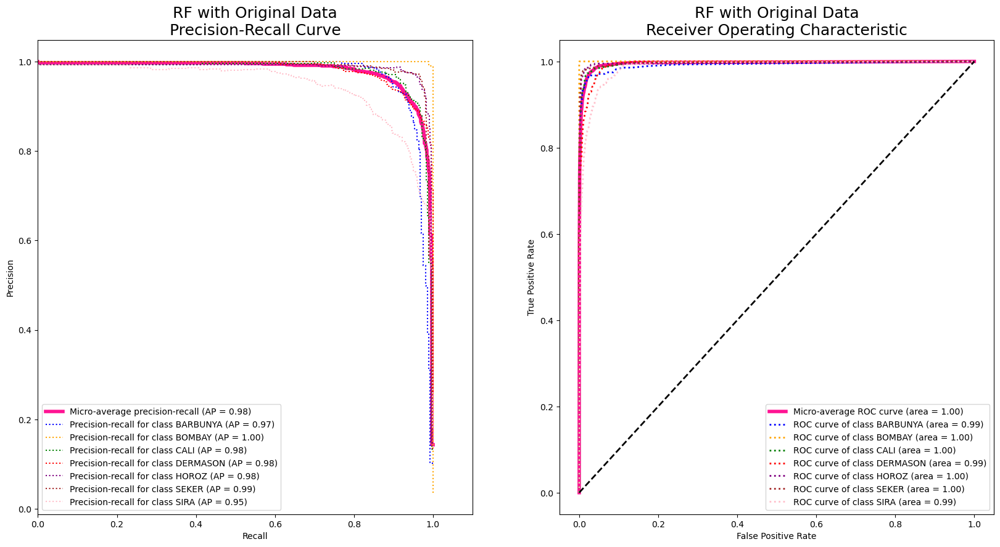

In [94]:
plot_prc_roc_curve(y_score, y_test, class_label_order, "RF with Original Data")

### 2.1.2. Classification with Normalized Data

- Z-score Normalization

In [95]:
col = data_z_score.columns.tolist()
col.remove('Class')
params = {
    "n_estimators": [10, 50, 100, 200]
}
X_train, X_test, y_train, y_test = train_test_split(data_z_score[col], y_1hot,test_size=0.2)
rf = OneVsRestClassifier(model_selection.GridSearchCV(ensemble.RandomForestClassifier(random_state=9099, n_jobs=-1),
                                 params, cv=10, n_jobs=-1))
rf.fit(X_train, y_train)

# predict from the model
predY = rf.predict(X_test)

# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))
y_score = rf.predict_proba(X_test)

print("=== Best Parameter ===")
for i in range(len(rf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + rf.estimators_[i].best_params_.__str__())


/Users/tanhaofeng/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.96      0.88      0.92       282
           1       1.00      1.00      1.00        86
           2       0.95      0.93      0.94       356
           3       0.94      0.93      0.93       708
           4       0.97      0.96      0.97       376
           5       0.97      0.95      0.96       408
           6       0.89      0.87      0.88       507

   micro avg       0.94      0.92      0.93      2723
   macro avg       0.95      0.93      0.94      2723
weighted avg       0.94      0.92      0.93      2723
 samples avg       0.92      0.92      0.92      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'n_estimators': 200}
Classifier for class BOMBAY: {'n_estimators': 10}
Classifier for class CALI: {'n_estimators': 200}
Classifier for class DERMASON: {'n_estimators': 50}
Classifier for class HOROZ: {'n_estimators': 200}
Classifier for class SEKER: {'n_estimators': 50}
Classifier for class SI

average: 0.9804876703348604
average2: 0.9951791337664982


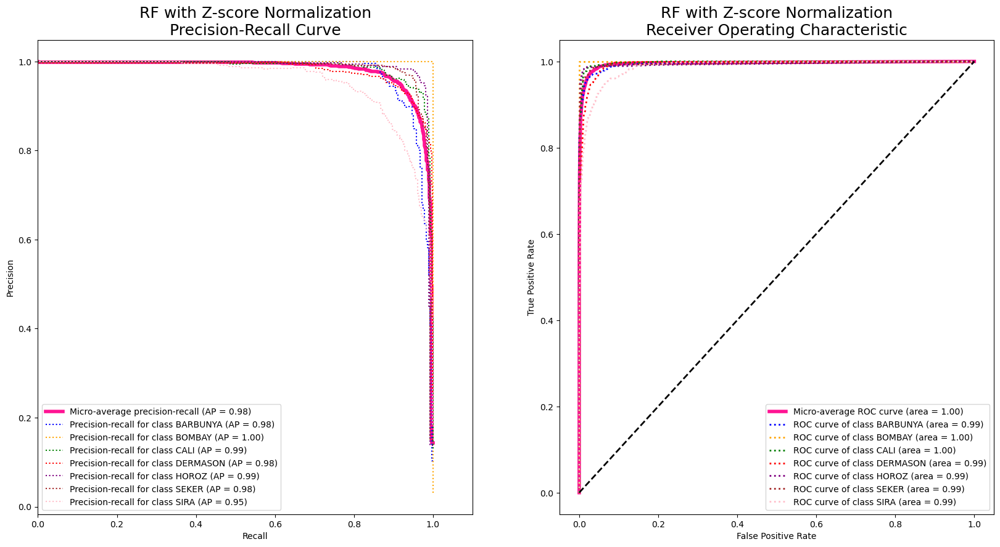

In [96]:
plot_prc_roc_curve(y_score, y_test, class_label_order, "RF with Z-score Normalization")

- Min-max Normalization

In [97]:
col = data_min_max.columns.tolist()
col.remove('Class')
params = {
    "n_estimators": [10, 50, 100, 200]
}
X_train, X_test, y_train, y_test = train_test_split(data_min_max[col], y_1hot,test_size=0.2)
rf = OneVsRestClassifier(model_selection.GridSearchCV(ensemble.RandomForestClassifier(random_state=9099, n_jobs=-1),
                                 params, cv=10, n_jobs=-1))
rf.fit(X_train, y_train)

# predict from the model
predY = rf.predict(X_test)

# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))
y_score = rf.predict_proba(X_test)

print("=== Best Parameter ===")
for i in range(len(rf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + rf.estimators_[i].best_params_.__str__())


/Users/tanhaofeng/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.95      0.90      0.92       266
           1       0.99      1.00      1.00       105
           2       0.94      0.91      0.92       338
           3       0.92      0.92      0.92       699
           4       0.98      0.91      0.94       397
           5       0.96      0.95      0.96       395
           6       0.89      0.87      0.88       523

   micro avg       0.94      0.91      0.93      2723
   macro avg       0.95      0.92      0.94      2723
weighted avg       0.94      0.91      0.93      2723
 samples avg       0.91      0.91      0.91      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'n_estimators': 50}
Classifier for class BOMBAY: {'n_estimators': 10}
Classifier for class CALI: {'n_estimators': 200}
Classifier for class DERMASON: {'n_estimators': 100}
Classifier for class HOROZ: {'n_estimators': 200}
Classifier for class SEKER: {'n_estimators': 100}
Classifier for class S

average: 0.97350925990968
average2: 0.993082934431364


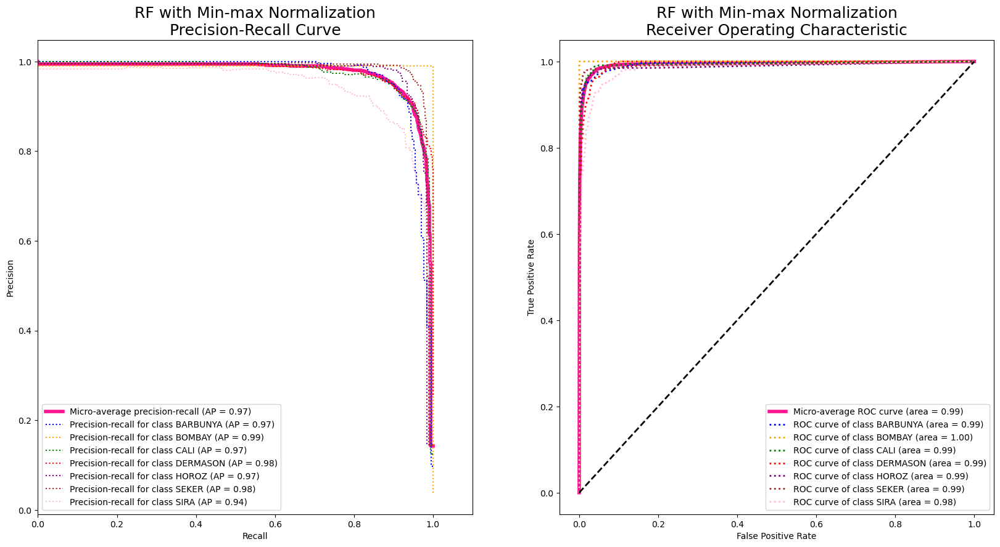

In [98]:
plot_prc_roc_curve(y_score, y_test, class_label_order, "RF with Min-max Normalization")

### 2.1.3. Classification with Feature Selection
- CfsSubsetEval

In [99]:
params = {
    "n_estimators": [10, 50, 100, 200]
}
X_train, X_test, y_train, y_test = train_test_split(data[feature_sel_cfs], y_1hot,test_size=0.2)
rf = OneVsRestClassifier(model_selection.GridSearchCV(ensemble.RandomForestClassifier(random_state=9099, n_jobs=-1),
                                 params, cv=10, n_jobs=-1))
rf.fit(X_train, y_train)

# predict from the model
predY = rf.predict(X_test)

# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))
y_score = rf.predict_proba(X_test)

print("=== Best Parameter ===")
for i in range(len(rf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + rf.estimators_[i].best_params_.__str__())


/Users/tanhaofeng/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.97      0.90      0.93       287
           1       0.99      1.00      1.00       114
           2       0.94      0.95      0.95       324
           3       0.91      0.93      0.92       715
           4       0.97      0.94      0.96       364
           5       0.97      0.92      0.95       420
           6       0.89      0.85      0.87       499

   micro avg       0.94      0.92      0.93      2723
   macro avg       0.95      0.93      0.94      2723
weighted avg       0.94      0.92      0.93      2723
 samples avg       0.92      0.92      0.92      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'n_estimators': 50}
Classifier for class BOMBAY: {'n_estimators': 10}
Classifier for class CALI: {'n_estimators': 200}
Classifier for class DERMASON: {'n_estimators': 200}
Classifier for class HOROZ: {'n_estimators': 200}
Classifier for class SEKER: {'n_estimators': 100}
Classifier for class S

average: 0.9795858288319814
average2: 0.9955911065664032


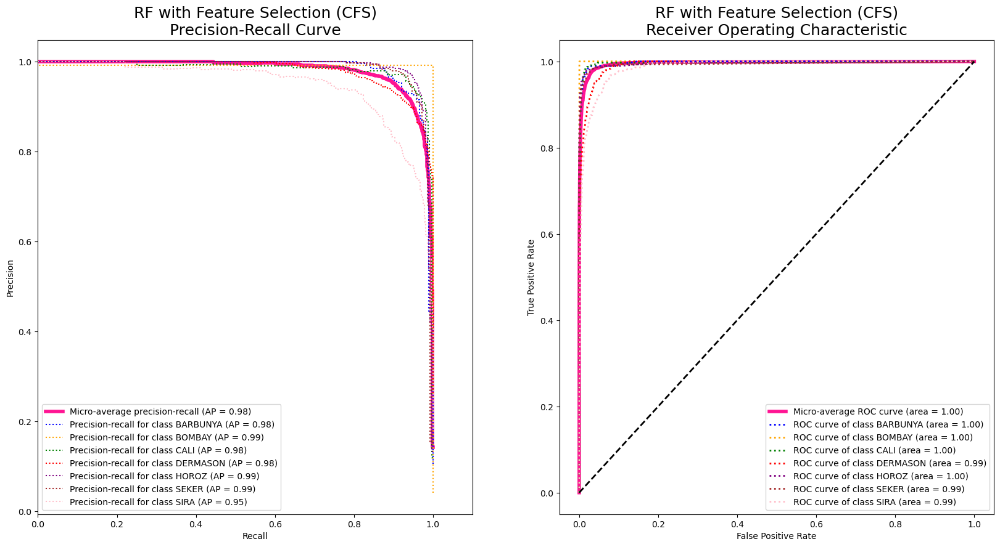

In [100]:
plot_prc_roc_curve(y_score, y_test, class_label_order, "RF with Feature Selection (CFS)")

- InfoGainAttributeEval

In [101]:
params = {
    "n_estimators": [10, 50, 100, 200]
}
X_train, X_test, y_train, y_test = train_test_split(data[feature_sel_info_gain], y_1hot,test_size=0.2)
rf = OneVsRestClassifier(model_selection.GridSearchCV(ensemble.RandomForestClassifier(random_state=9099, n_jobs=-1),
                                 params, cv=10, n_jobs=-1))
rf.fit(X_train, y_train)

# predict from the model
predY = rf.predict(X_test)

# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))
y_score = rf.predict_proba(X_test)

print("=== Best Parameter ===")
for i in range(len(rf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + rf.estimators_[i].best_params_.__str__())


/Users/tanhaofeng/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.92      0.84      0.87       232
           1       1.00      1.00      1.00        96
           2       0.93      0.91      0.92       346
           3       0.91      0.91      0.91       709
           4       0.95      0.95      0.95       381
           5       0.94      0.94      0.94       431
           6       0.88      0.85      0.86       528

   micro avg       0.92      0.90      0.91      2723
   macro avg       0.93      0.91      0.92      2723
weighted avg       0.92      0.90      0.91      2723
 samples avg       0.90      0.90      0.90      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'n_estimators': 50}
Classifier for class BOMBAY: {'n_estimators': 10}
Classifier for class CALI: {'n_estimators': 200}
Classifier for class DERMASON: {'n_estimators': 100}
Classifier for class HOROZ: {'n_estimators': 200}
Classifier for class SEKER: {'n_estimators': 100}
Classifier for class S

average: 0.9698006886378434
average2: 0.9929373008777529


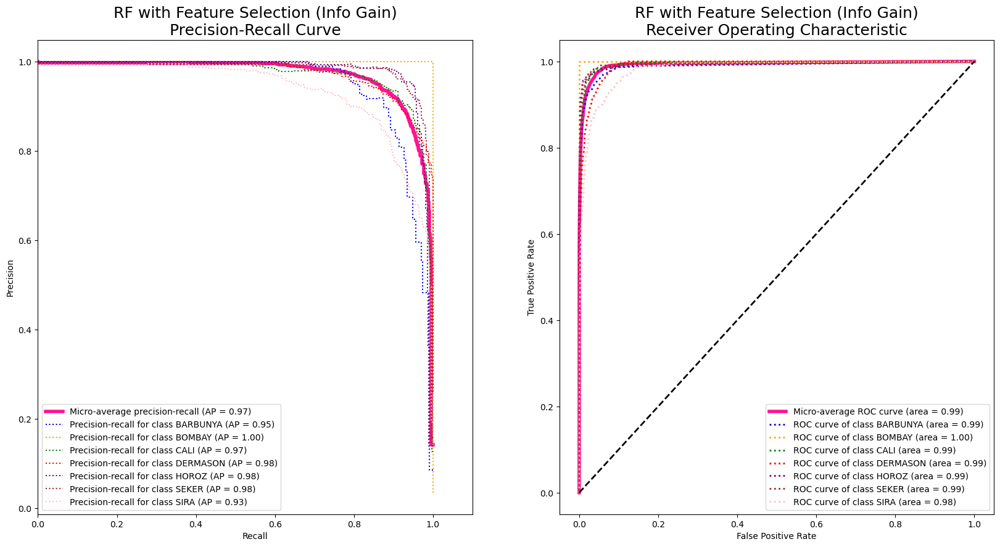

In [102]:
plot_prc_roc_curve(y_score, y_test, class_label_order, "RF with Feature Selection (Info Gain)")

### 2.1.4. Classification with Noisy Data

In [103]:
params = {
    "n_estimators": [10, 50, 100, 200]
}
X_train, X_test, y_train, y_test = train_test_split(data_gaussian[col], y_1hot,test_size=0.2)
rf = OneVsRestClassifier(model_selection.GridSearchCV(ensemble.RandomForestClassifier(random_state=9099, n_jobs=-1),
                                 params, cv=10, n_jobs=-1))
rf.fit(X_train, y_train)

# predict from the model
predY = rf.predict(X_test)

# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))
y_score = rf.predict_proba(X_test)

print("=== Best Parameter ===")
for i in range(len(rf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + rf.estimators_[i].best_params_.__str__())


/Users/tanhaofeng/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.96      0.89      0.92       243
           1       1.00      0.99      1.00       105
           2       0.94      0.91      0.93       318
           3       0.93      0.92      0.93       741
           4       0.97      0.93      0.95       379
           5       0.97      0.93      0.95       401
           6       0.89      0.86      0.87       536

   micro avg       0.94      0.91      0.93      2723
   macro avg       0.95      0.92      0.94      2723
weighted avg       0.94      0.91      0.93      2723
 samples avg       0.91      0.91      0.91      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'n_estimators': 200}
Classifier for class BOMBAY: {'n_estimators': 10}
Classifier for class CALI: {'n_estimators': 200}
Classifier for class DERMASON: {'n_estimators': 50}
Classifier for class HOROZ: {'n_estimators': 50}
Classifier for class SEKER: {'n_estimators': 100}
Classifier for class SI

average: 0.977489563347999
average2: 0.9948215459616484


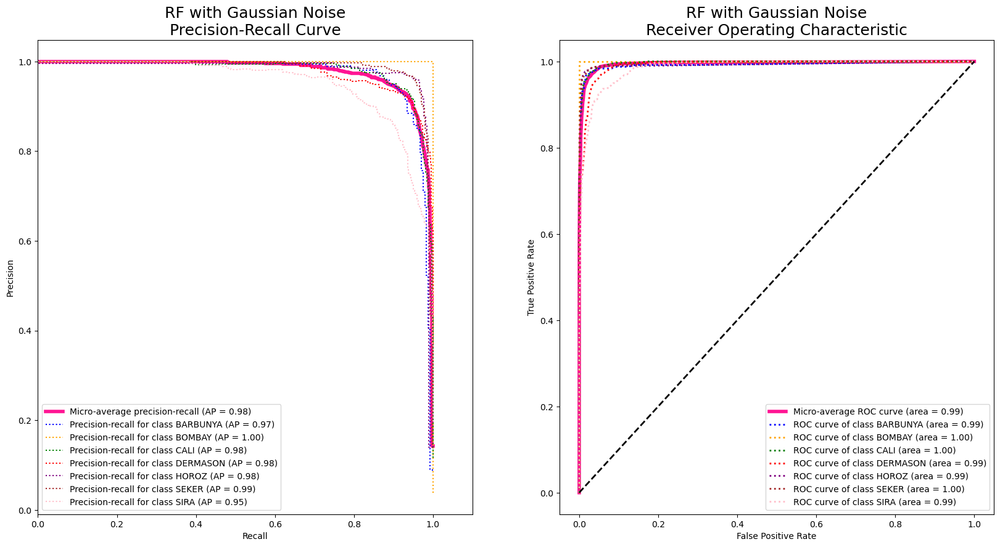

In [104]:
plot_prc_roc_curve(y_score, y_test, class_label_order, "RF with Gaussian Noise")

### 2.1.5. Classification with Combined Data Preprocessing Techniques

/Users/tanhaofeng/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.96      0.88      0.92       252
           1       1.00      0.99      0.99        93
           2       0.95      0.94      0.94       313
           3       0.93      0.91      0.92       749
           4       0.99      0.93      0.96       390
           5       0.96      0.92      0.94       391
           6       0.86      0.87      0.86       535

   micro avg       0.93      0.91      0.92      2723
   macro avg       0.95      0.92      0.93      2723
weighted avg       0.93      0.91      0.92      2723
 samples avg       0.91      0.91      0.91      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'n_estimators': 50}
Classifier for class BOMBAY: {'n_estimators': 10}
Classifier for class CALI: {'n_estimators': 200}
Classifier for class DERMASON: {'n_estimators': 200}
Classifier for class HOROZ: {'n_estimators': 200}
Classifier for class SEKER: {'n_estimators': 200}
Classifier for class S

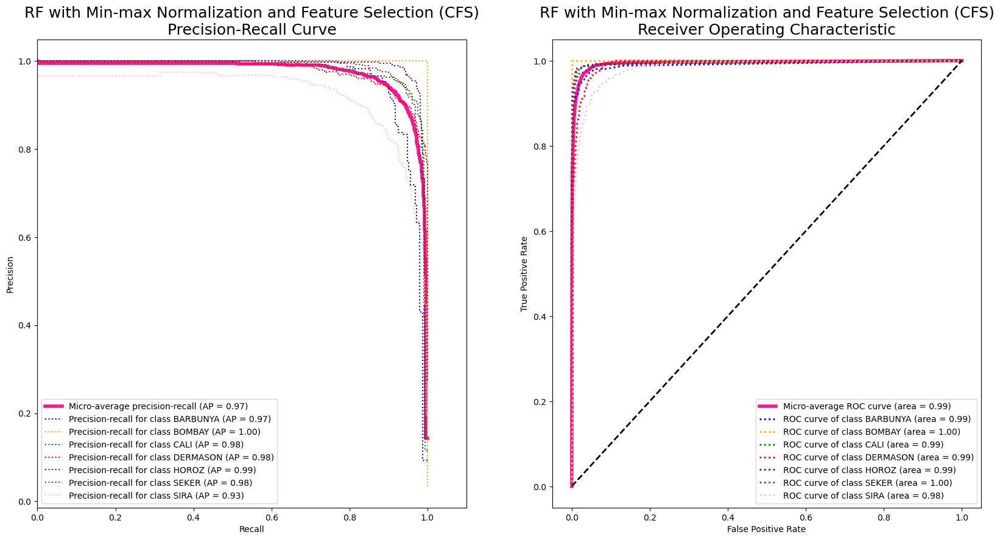

In [105]:
params = {
    "n_estimators": [10, 50, 100, 200]
}
X_train, X_test, y_train, y_test = train_test_split(data_min_max[feature_sel_cfs], y_1hot,test_size=0.2)
rf = OneVsRestClassifier(model_selection.GridSearchCV(ensemble.RandomForestClassifier(random_state=9099, n_jobs=-1),
                                 params, cv=10, n_jobs=-1))
rf.fit(X_train, y_train)

# predict from the model
predY = rf.predict(X_test)

# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))
y_score = rf.predict_proba(X_test)

print("=== Best Parameter ===")
for i in range(len(rf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + rf.estimators_[i].best_params_.__str__())

plot_prc_roc_curve(y_score, y_test, class_label_order, "RF with Min-max Normalization and Feature Selection (CFS)")

/Users/tanhaofeng/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.94      0.89      0.92       253
           1       0.99      1.00      0.99        97
           2       0.96      0.91      0.94       326
           3       0.92      0.92      0.92       714
           4       0.98      0.94      0.96       411
           5       0.95      0.95      0.95       397
           6       0.88      0.85      0.86       525

   micro avg       0.93      0.91      0.92      2723
   macro avg       0.94      0.92      0.93      2723
weighted avg       0.93      0.91      0.92      2723
 samples avg       0.91      0.91      0.91      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'n_estimators': 200}
Classifier for class BOMBAY: {'n_estimators': 10}
Classifier for class CALI: {'n_estimators': 200}
Classifier for class DERMASON: {'n_estimators': 100}
Classifier for class HOROZ: {'n_estimators': 200}
Classifier for class SEKER: {'n_estimators': 50}
Classifier for class S

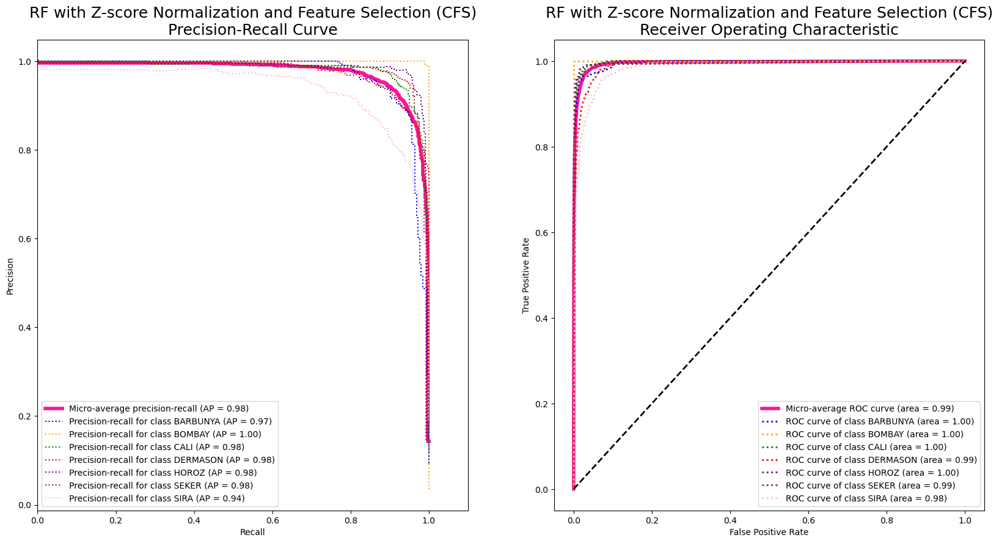

In [106]:
params = {
    "n_estimators": [10, 50, 100, 200]
}
X_train, X_test, y_train, y_test = train_test_split(data_z_score[feature_sel_cfs], y_1hot,test_size=0.2)
rf = OneVsRestClassifier(model_selection.GridSearchCV(ensemble.RandomForestClassifier(random_state=9099, n_jobs=-1),
                                 params, cv=10, n_jobs=-1))
rf.fit(X_train, y_train)

# predict from the model
predY = rf.predict(X_test)

# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))
y_score = rf.predict_proba(X_test)

print("=== Best Parameter ===")
for i in range(len(rf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + rf.estimators_[i].best_params_.__str__())

plot_prc_roc_curve(y_score, y_test, class_label_order, "RF with Z-score Normalization and Feature Selection (CFS)")

/Users/tanhaofeng/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.96      0.89      0.92       274
           1       1.00      0.99      1.00       104
           2       0.95      0.93      0.94       326
           3       0.91      0.93      0.92       677
           4       0.97      0.93      0.95       401
           5       0.94      0.92      0.93       386
           6       0.91      0.84      0.88       555

   micro avg       0.94      0.91      0.92      2723
   macro avg       0.95      0.92      0.93      2723
weighted avg       0.94      0.91      0.92      2723
 samples avg       0.91      0.91      0.91      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'n_estimators': 200}
Classifier for class BOMBAY: {'n_estimators': 10}
Classifier for class CALI: {'n_estimators': 200}
Classifier for class DERMASON: {'n_estimators': 200}
Classifier for class HOROZ: {'n_estimators': 200}
Classifier for class SEKER: {'n_estimators': 200}
Classifier for class 

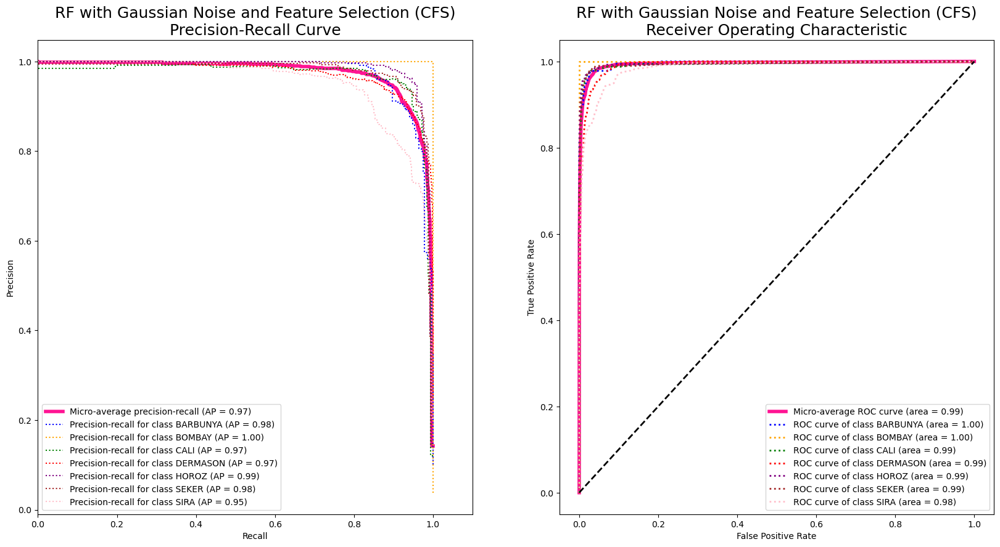

In [107]:
params = {
    "n_estimators": [10, 50, 100, 200]
}
X_train, X_test, y_train, y_test = train_test_split(data_gaussian[feature_sel_cfs], y_1hot,test_size=0.2)
rf = OneVsRestClassifier(model_selection.GridSearchCV(ensemble.RandomForestClassifier(random_state=9099, n_jobs=-1),
                                 params, cv=10, n_jobs=-1))
rf.fit(X_train, y_train)

# predict from the model
predY = rf.predict(X_test)

# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))
y_score = rf.predict_proba(X_test)

print("=== Best Parameter ===")
for i in range(len(rf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + rf.estimators_[i].best_params_.__str__())

plot_prc_roc_curve(y_score, y_test, class_label_order, "RF with Gaussian Noise and Feature Selection (CFS)")

/Users/tanhaofeng/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.92      0.83      0.87       270
           1       1.00      0.99      1.00       106
           2       0.92      0.88      0.90       322
           3       0.93      0.91      0.92       693
           4       0.94      0.94      0.94       383
           5       0.96      0.92      0.94       397
           6       0.86      0.88      0.87       552

   micro avg       0.92      0.90      0.91      2723
   macro avg       0.93      0.91      0.92      2723
weighted avg       0.92      0.90      0.91      2723
 samples avg       0.90      0.90      0.90      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'n_estimators': 100}
Classifier for class BOMBAY: {'n_estimators': 10}
Classifier for class CALI: {'n_estimators': 100}
Classifier for class DERMASON: {'n_estimators': 200}
Classifier for class HOROZ: {'n_estimators': 10}
Classifier for class SEKER: {'n_estimators': 200}
Classifier for class S

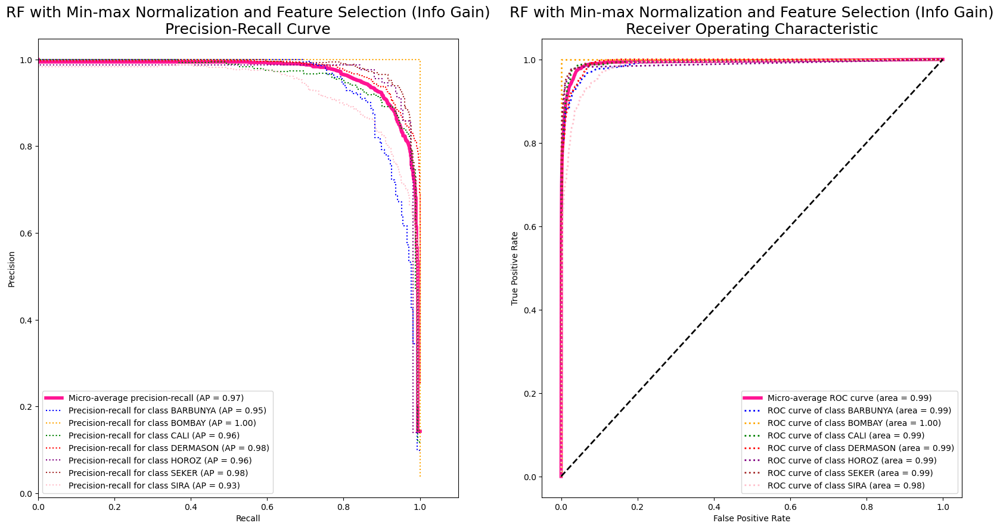

In [108]:
params = {
    "n_estimators": [10, 50, 100, 200]
}
X_train, X_test, y_train, y_test = train_test_split(data_min_max[feature_sel_info_gain], y_1hot,test_size=0.2)
rf = OneVsRestClassifier(model_selection.GridSearchCV(ensemble.RandomForestClassifier(random_state=9099, n_jobs=-1),
                                 params, cv=10, n_jobs=-1))
rf.fit(X_train, y_train)

# predict from the model
predY = rf.predict(X_test)

# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))
y_score = rf.predict_proba(X_test)

print("=== Best Parameter ===")
for i in range(len(rf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + rf.estimators_[i].best_params_.__str__())

plot_prc_roc_curve(y_score, y_test, class_label_order, "RF with Min-max Normalization and Feature Selection (Info Gain)")

/Users/tanhaofeng/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.93      0.89      0.91       264
           1       1.00      1.00      1.00        96
           2       0.95      0.90      0.93       314
           3       0.90      0.90      0.90       725
           4       0.96      0.93      0.95       410
           5       0.95      0.93      0.94       403
           6       0.86      0.84      0.85       511

   micro avg       0.92      0.90      0.91      2723
   macro avg       0.94      0.91      0.93      2723
weighted avg       0.92      0.90      0.91      2723
 samples avg       0.90      0.90      0.90      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'n_estimators': 100}
Classifier for class BOMBAY: {'n_estimators': 10}
Classifier for class CALI: {'n_estimators': 100}
Classifier for class DERMASON: {'n_estimators': 50}
Classifier for class HOROZ: {'n_estimators': 200}
Classifier for class SEKER: {'n_estimators': 200}
Classifier for class S

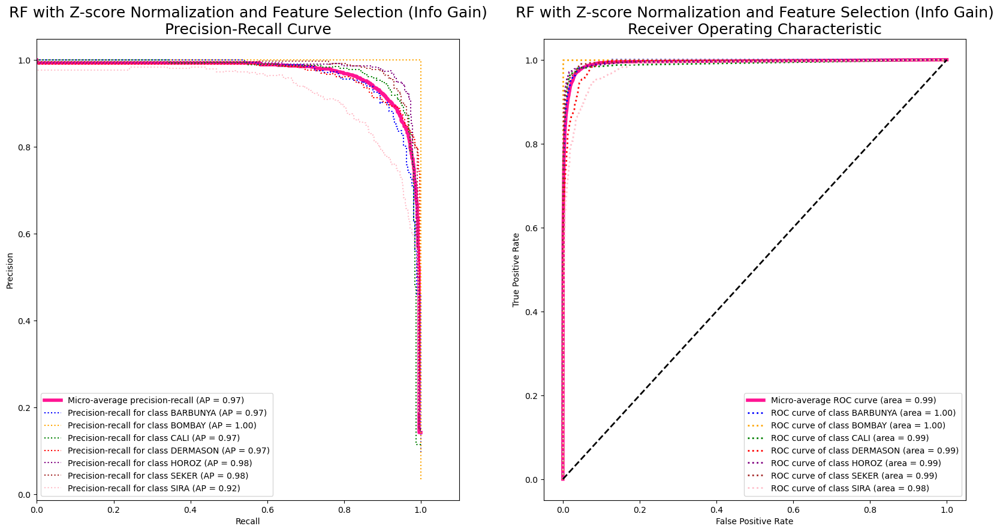

In [109]:
params = {
    "n_estimators": [10, 50, 100, 200]
}
X_train, X_test, y_train, y_test = train_test_split(data_z_score[feature_sel_info_gain], y_1hot,test_size=0.2)
rf = OneVsRestClassifier(model_selection.GridSearchCV(ensemble.RandomForestClassifier(random_state=9099, n_jobs=-1),
                                 params, cv=10, n_jobs=-1))
rf.fit(X_train, y_train)

# predict from the model
predY = rf.predict(X_test)

# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))
y_score = rf.predict_proba(X_test)

print("=== Best Parameter ===")
for i in range(len(rf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + rf.estimators_[i].best_params_.__str__())

plot_prc_roc_curve(y_score, y_test, class_label_order, "RF with Z-score Normalization and Feature Selection (Info Gain)")

/Users/tanhaofeng/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.92      0.83      0.87       282
           1       1.00      0.99      0.99        93
           2       0.91      0.89      0.90       333
           3       0.91      0.92      0.92       705
           4       0.96      0.94      0.95       362
           5       0.96      0.94      0.95       419
           6       0.89      0.83      0.86       529

   micro avg       0.93      0.90      0.91      2723
   macro avg       0.94      0.91      0.92      2723
weighted avg       0.93      0.90      0.91      2723
 samples avg       0.90      0.90      0.90      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'n_estimators': 200}
Classifier for class BOMBAY: {'n_estimators': 10}
Classifier for class CALI: {'n_estimators': 200}
Classifier for class DERMASON: {'n_estimators': 200}
Classifier for class HOROZ: {'n_estimators': 200}
Classifier for class SEKER: {'n_estimators': 200}
Classifier for class 

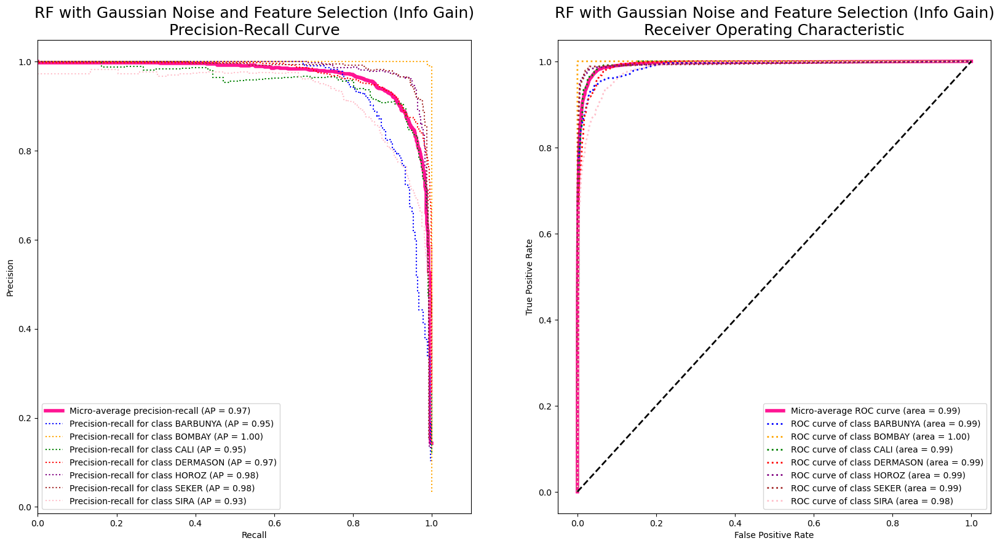

In [110]:
params = {
    "n_estimators": [10, 50, 100, 200]
}
X_train, X_test, y_train, y_test = train_test_split(data_gaussian[feature_sel_info_gain], y_1hot,test_size=0.2)
rf = OneVsRestClassifier(model_selection.GridSearchCV(ensemble.RandomForestClassifier(random_state=9099, n_jobs=-1),
                                 params, cv=10, n_jobs=-1))
rf.fit(X_train, y_train)

# predict from the model
predY = rf.predict(X_test)

# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))
y_score = rf.predict_proba(X_test)

print("=== Best Parameter ===")
for i in range(len(rf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + rf.estimators_[i].best_params_.__str__())

plot_prc_roc_curve(y_score, y_test, class_label_order, "RF with Gaussian Noise and Feature Selection (Info Gain)")

### 2.1.6 Classication with SMOTE and feature selection / z-score

['BARBUNYA' 'BOMBAY' 'CALI' 'DERMASON' 'HOROZ' 'SEKER' 'SIRA']


/Users/nomoney/opt/anaconda3/envs/tf/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.98      0.97      0.98       708
           1       1.00      1.00      1.00       692
           2       0.98      0.96      0.97       710
           3       0.91      0.91      0.91       676
           4       0.98      0.96      0.97       739
           5       0.98      0.96      0.97       701
           6       0.91      0.89      0.90       739

   micro avg       0.96      0.95      0.96      4965
   macro avg       0.96      0.95      0.96      4965
weighted avg       0.96      0.95      0.96      4965
 samples avg       0.95      0.95      0.95      4965

=== Best Parameter ===
Classifier for class BARBUNYA: {'n_estimators': 100}
Classifier for class BOMBAY: {'n_estimators': 10}
Classifier for class CALI: {'n_estimators': 100}
Classifier for class DERMASON: {'n_estimators': 50}
Classifier for class HOROZ: {'n_estimators': 100}
Classifier for class SEKER: {'n_estimators': 50}
Classifier for class SI

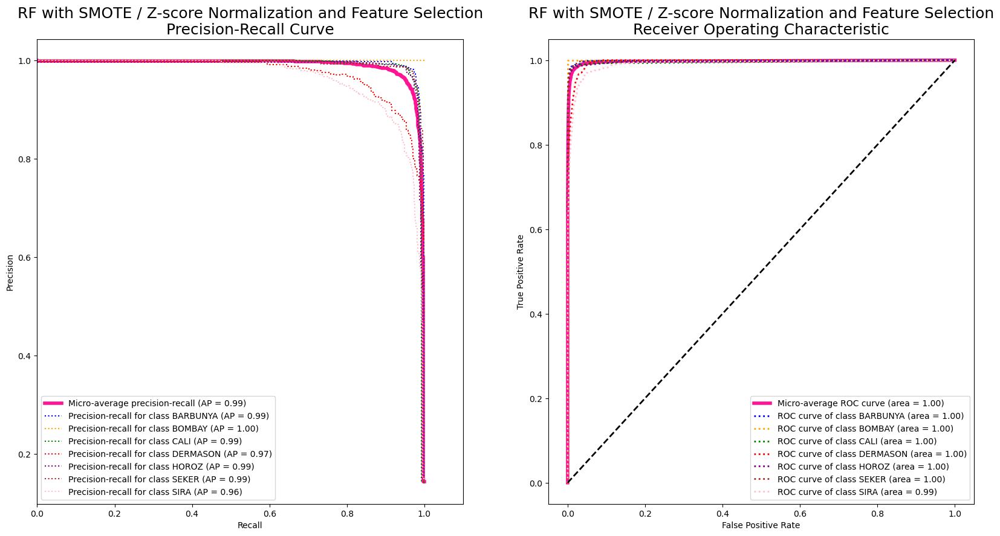

In [7]:
x = data_smote.drop('Class', axis= 1)
y = data_smote['Class']

encoder = LabelBinarizer()
y_1hot2 = encoder.fit_transform(y)
class_1hot = np.array([[1,0,0,0,0,0,0], 
         [0,1,0,0,0,0,0], 
         [0,0,1,0,0,0,0], 
         [0,0,0,1,0,0,0], 
         [0,0,0,0,1,0,0], 
         [0,0,0,0,0,1,0], 
         [0,0,0,0,0,0,1]])
class_label_order = encoder.inverse_transform(class_1hot)
print(class_label_order)

params = {
    "n_estimators": [10, 50, 100, 200]
}
X_train, X_test, y_train, y_test = train_test_split(x, y_1hot2,test_size=0.2)
rf = OneVsRestClassifier(model_selection.GridSearchCV(ensemble.RandomForestClassifier(random_state=9099, n_jobs=-1),
                                 params, cv=10, n_jobs=-1))
rf.fit(X_train, y_train)

# predict from the model
predY = rf.predict(X_test)

# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))
y_score = rf.predict_proba(X_test)

print("=== Best Parameter ===")
for i in range(len(rf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + rf.estimators_[i].best_params_.__str__())

plot_prc_roc_curve(y_score, y_test, class_label_order, "RF with SMOTE / Z-score Normalization and Feature Selection")

In [9]:
acc = metrics.accuracy_score(y_test, predY)
print('accuracy = ', acc)

accuracy =  0.9470292044310171


## 2.2. Boosting: AdaBoost

### 2.2.1. Classification with Original Data

In [189]:
params = {
    "n_estimators": [10, 20, 50, 100]
}
X_train, X_test, y_train, y_test = train_test_split(data[col], y_1hot,test_size=0.2)
clf = OneVsRestClassifier(model_selection.GridSearchCV(ensemble.AdaBoostClassifier(random_state=9099),
                                 params, cv=10, n_jobs=-1))
clf.fit(X_train, y_train)

# predict from the model
predY = clf.predict(X_test)

# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))
y_score = clf.predict_proba(X_test)

print("=== Best Parameter ===")
for i in range(len(clf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + clf.estimators_[i].best_params_.__str__())


/Users/tanhaofeng/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.94      0.90      0.92       278
           1       1.00      1.00      1.00        97
           2       0.92      0.93      0.93       334
           3       0.90      0.92      0.91       718
           4       0.96      0.95      0.95       387
           5       0.93      0.97      0.95       392
           6       0.85      0.82      0.83       517

   micro avg       0.91      0.91      0.91      2723
   macro avg       0.93      0.93      0.93      2723
weighted avg       0.91      0.91      0.91      2723
 samples avg       0.90      0.91      0.90      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'n_estimators': 100}
Classifier for class BOMBAY: {'n_estimators': 50}
Classifier for class CALI: {'n_estimators': 100}
Classifier for class DERMASON: {'n_estimators': 50}
Classifier for class HOROZ: {'n_estimators': 100}
Classifier for class SEKER: {'n_estimators': 50}
Classifier for class SI

average: 0.973678675501199
average2: 0.994497955803015


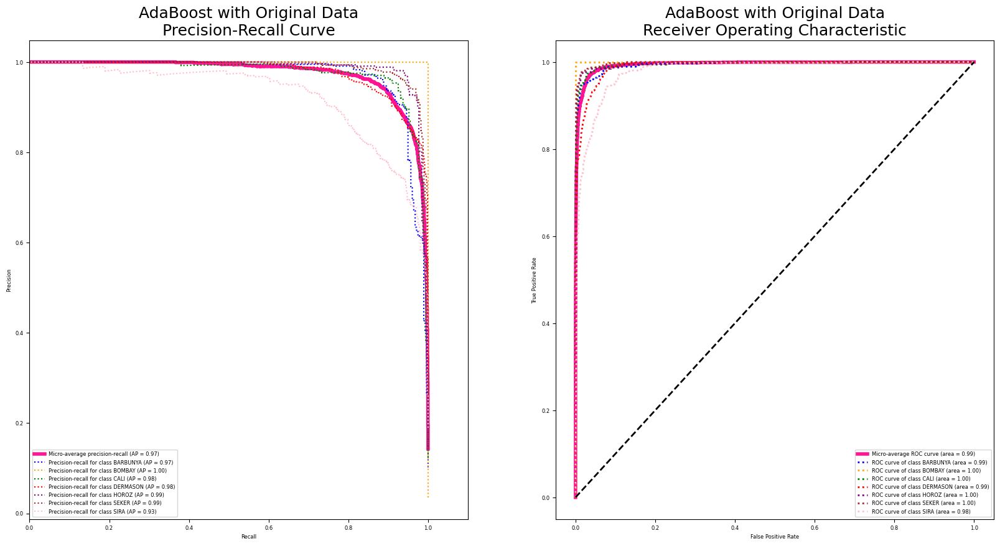

In [190]:
plot_prc_roc_curve(y_score, y_test, class_label_order, "AdaBoost with Original Data")

### 2.2.2. Classification with Normalized Data

In [191]:
params = {
    "n_estimators": [10, 20, 50, 100]
}
X_train, X_test, y_train, y_test = train_test_split(data_z_score[col], y_1hot,test_size=0.2)
clf = OneVsRestClassifier(model_selection.GridSearchCV(ensemble.AdaBoostClassifier(random_state=9099),
                                 params, cv=10, n_jobs=-1))
clf.fit(X_train, y_train)

# predict from the model
predY = clf.predict(X_test)

# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))
y_score = clf.predict_proba(X_test)

print("=== Best Parameter ===")
for i in range(len(clf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + clf.estimators_[i].best_params_.__str__())


/Users/tanhaofeng/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.96      0.88      0.92       255
           1       1.00      0.99      1.00       110
           2       0.90      0.94      0.92       313
           3       0.91      0.93      0.92       720
           4       0.97      0.93      0.95       384
           5       0.96      0.95      0.96       437
           6       0.87      0.85      0.86       504

   micro avg       0.93      0.92      0.92      2723
   macro avg       0.94      0.93      0.93      2723
weighted avg       0.93      0.92      0.92      2723
 samples avg       0.91      0.92      0.91      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'n_estimators': 100}
Classifier for class BOMBAY: {'n_estimators': 10}
Classifier for class CALI: {'n_estimators': 100}
Classifier for class DERMASON: {'n_estimators': 100}
Classifier for class HOROZ: {'n_estimators': 100}
Classifier for class SEKER: {'n_estimators': 100}
Classifier for class 

average: 0.9769136387007454
average2: 0.9948443833887928


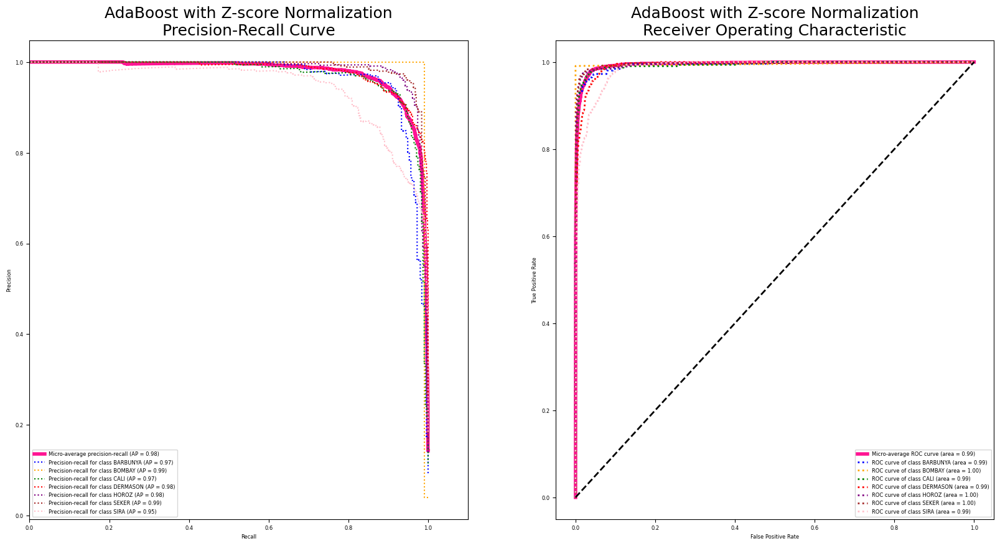

In [193]:
plot_prc_roc_curve(y_score, y_test, class_label_order, "AdaBoost with Z-score Normalization")

/Users/tanhaofeng/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.96      0.91      0.94       259
           1       0.99      1.00      1.00       108
           2       0.92      0.94      0.93       339
           3       0.90      0.90      0.90       689
           4       0.97      0.96      0.96       405
           5       0.97      0.96      0.96       394
           6       0.89      0.87      0.88       529

   micro avg       0.93      0.92      0.93      2723
   macro avg       0.94      0.93      0.94      2723
weighted avg       0.93      0.92      0.93      2723
 samples avg       0.91      0.92      0.91      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'n_estimators': 100}
Classifier for class BOMBAY: {'n_estimators': 10}
Classifier for class CALI: {'n_estimators': 100}
Classifier for class DERMASON: {'n_estimators': 50}
Classifier for class HOROZ: {'n_estimators': 100}
Classifier for class SEKER: {'n_estimators': 100}
Classifier for class S

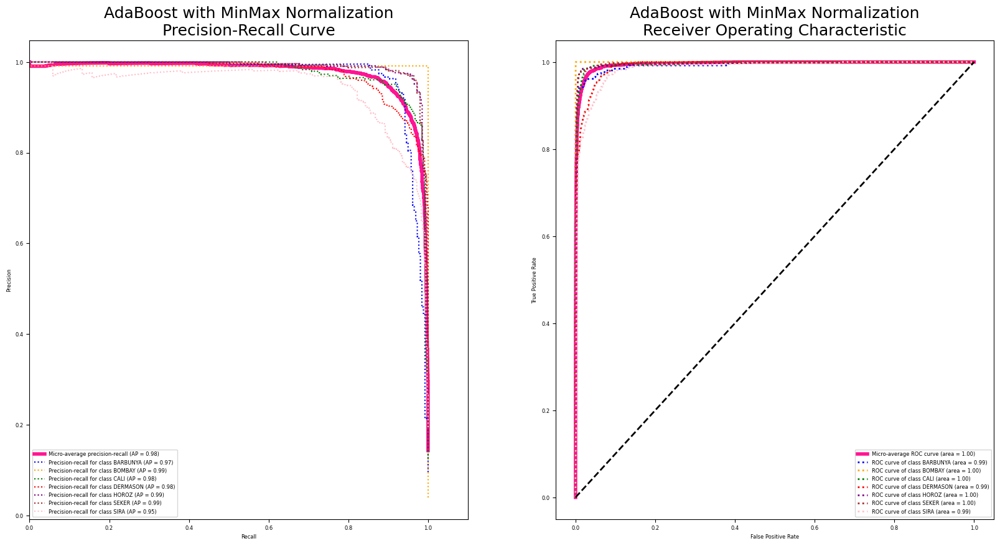

In [201]:
params = {
    "n_estimators": [10, 20, 50, 100]
}

col = data_min_max.columns.tolist()
col.remove('Class')

X_train, X_test, y_train, y_test = train_test_split(data_min_max[col], y_1hot,test_size=0.2)
clf = OneVsRestClassifier(model_selection.GridSearchCV(ensemble.AdaBoostClassifier(random_state=9099),
                                 params, cv=10, n_jobs=-1))
clf.fit(X_train, y_train)

# predict from the model
predY = clf.predict(X_test)

# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))
y_score = clf.predict_proba(X_test)

print("=== Best Parameter ===")
for i in range(len(clf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + clf.estimators_[i].best_params_.__str__())
plot_prc_roc_curve(y_score, y_test, class_label_order, "AdaBoost with MinMax Normalization")

### 2.1.3. Classification with Feature Selection
- CfsSubsetEval

In [194]:
params = {
    "n_estimators": [10, 20, 50, 100]
}
X_train, X_test, y_train, y_test = train_test_split(data_norm[feature_sel_cfs], y_1hot,test_size=0.2)
clf = OneVsRestClassifier(model_selection.GridSearchCV(ensemble.AdaBoostClassifier(random_state=9099),
                                 params, cv=10, n_jobs=-1))
clf.fit(X_train, y_train)

# predict from the model
predY = clf.predict(X_test)

# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))
y_score = clf.predict_proba(X_test)

print("=== Best Parameter ===")
for i in range(len(clf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + clf.estimators_[i].best_params_.__str__())


/Users/tanhaofeng/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.92      0.88      0.90       265
           1       1.00      1.00      1.00        94
           2       0.93      0.91      0.92       336
           3       0.92      0.90      0.91       723
           4       0.95      0.94      0.95       406
           5       0.95      0.94      0.94       370
           6       0.82      0.86      0.84       529

   micro avg       0.91      0.91      0.91      2723
   macro avg       0.93      0.92      0.92      2723
weighted avg       0.91      0.91      0.91      2723
 samples avg       0.89      0.91      0.90      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'n_estimators': 100}
Classifier for class BOMBAY: {'n_estimators': 10}
Classifier for class CALI: {'n_estimators': 100}
Classifier for class DERMASON: {'n_estimators': 50}
Classifier for class HOROZ: {'n_estimators': 100}
Classifier for class SEKER: {'n_estimators': 100}
Classifier for class S

average: 0.9697811907012779
average2: 0.9935274213438325


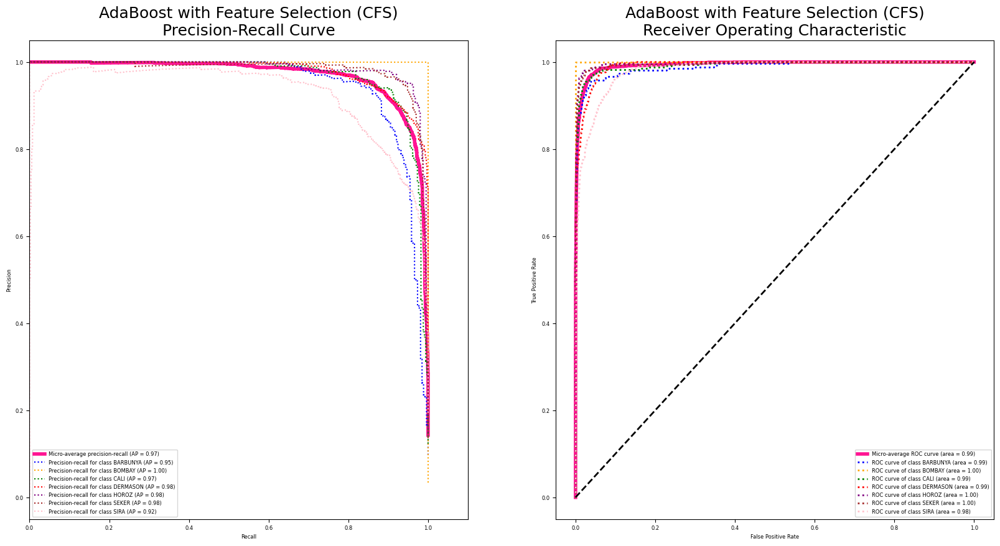

In [195]:
plot_prc_roc_curve(y_score, y_test, class_label_order, "AdaBoost with Feature Selection (CFS)")

- InfoGainAttributeEval

In [196]:
params = {
    "n_estimators": [10, 20, 50, 100]
}
X_train, X_test, y_train, y_test = train_test_split(data_norm[feature_sel_info_gain], y_1hot,test_size=0.2)
clf = OneVsRestClassifier(model_selection.GridSearchCV(ensemble.AdaBoostClassifier(random_state=9099),
                                 params, cv=10, n_jobs=-1))
clf.fit(X_train, y_train)

# predict from the model
predY = clf.predict(X_test)

# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))
y_score = clf.predict_proba(X_test)

print("=== Best Parameter ===")
for i in range(len(clf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + clf.estimators_[i].best_params_.__str__())


/Users/tanhaofeng/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.91      0.88      0.90       259
           1       1.00      1.00      1.00        97
           2       0.90      0.92      0.91       347
           3       0.92      0.91      0.92       696
           4       0.97      0.92      0.94       387
           5       0.96      0.95      0.95       417
           6       0.88      0.87      0.88       520

   micro avg       0.93      0.91      0.92      2723
   macro avg       0.93      0.92      0.93      2723
weighted avg       0.93      0.91      0.92      2723
 samples avg       0.90      0.91      0.91      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'n_estimators': 100}
Classifier for class BOMBAY: {'n_estimators': 10}
Classifier for class CALI: {'n_estimators': 100}
Classifier for class DERMASON: {'n_estimators': 100}
Classifier for class HOROZ: {'n_estimators': 100}
Classifier for class SEKER: {'n_estimators': 100}
Classifier for class 

average: 0.9780436184574137
average2: 0.995626958629686


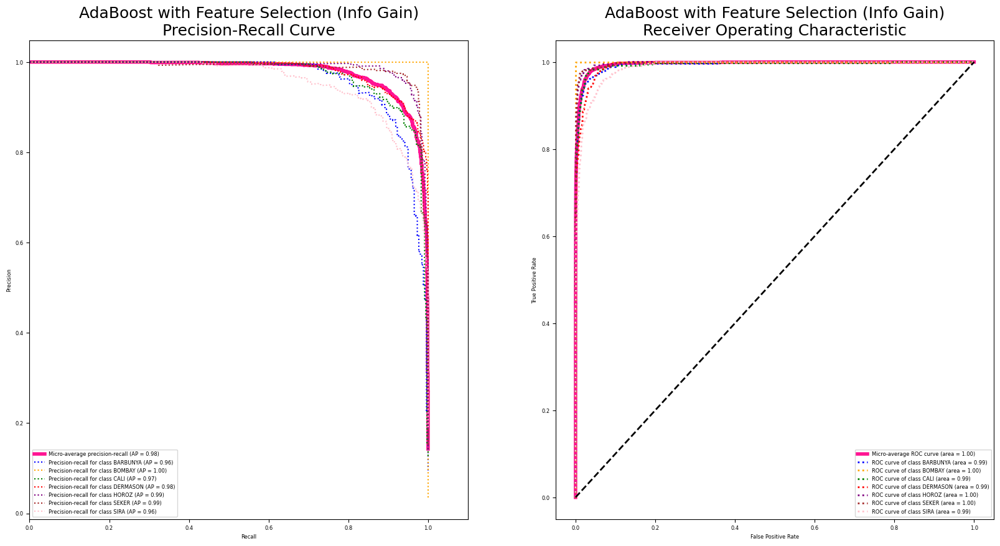

In [197]:
plot_prc_roc_curve(y_score, y_test, class_label_order, "AdaBoost with Feature Selection (Info Gain)")

### 2.2.4. Classification with Noisy Data

In [198]:
params = {
    "n_estimators": [10, 50, 100, 200]
}
X_train, X_test, y_train, y_test = train_test_split(data_gaussian[col], y_1hot,test_size=0.2)
clf = OneVsRestClassifier(model_selection.GridSearchCV(ensemble.AdaBoostClassifier(random_state=9099),
                                 params, cv=10, n_jobs=-1))
clf.fit(X_train, y_train)

# predict from the model
predY = clf.predict(X_test)

# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))
y_score = clf.predict_proba(X_test)

print("=== Best Parameter ===")
for i in range(len(clf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + clf.estimators_[i].best_params_.__str__())


/Users/tanhaofeng/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.91      0.91      0.91       284
           1       1.00      1.00      1.00       103
           2       0.93      0.90      0.92       330
           3       0.93      0.91      0.92       704
           4       0.94      0.94      0.94       386
           5       0.97      0.93      0.95       408
           6       0.83      0.88      0.86       508

   micro avg       0.92      0.91      0.92      2723
   macro avg       0.93      0.92      0.93      2723
weighted avg       0.92      0.91      0.92      2723
 samples avg       0.90      0.91      0.91      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'n_estimators': 200}
Classifier for class BOMBAY: {'n_estimators': 10}
Classifier for class CALI: {'n_estimators': 200}
Classifier for class DERMASON: {'n_estimators': 100}
Classifier for class HOROZ: {'n_estimators': 100}
Classifier for class SEKER: {'n_estimators': 50}
Classifier for class S

average: 0.9704877149344576
average2: 0.9936350674448114


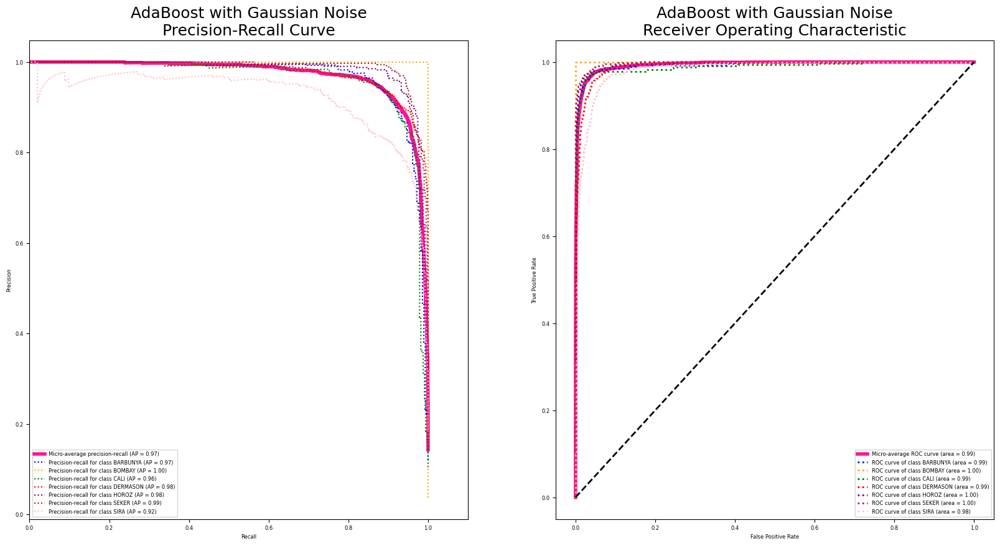

In [199]:
plot_prc_roc_curve(y_score, y_test, class_label_order, "AdaBoost with Gaussian Noise")

### 2.2.5. Classification with Combined Data Preprocessing Techniques

/Users/tanhaofeng/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.94      0.90      0.92       258
           1       1.00      1.00      1.00        98
           2       0.90      0.90      0.90       324
           3       0.91      0.91      0.91       729
           4       0.95      0.94      0.95       407
           5       0.95      0.96      0.95       389
           6       0.86      0.84      0.85       518

   micro avg       0.92      0.91      0.91      2723
   macro avg       0.93      0.92      0.93      2723
weighted avg       0.92      0.91      0.91      2723
 samples avg       0.90      0.91      0.90      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'n_estimators': 100}
Classifier for class BOMBAY: {'n_estimators': 10}
Classifier for class CALI: {'n_estimators': 100}
Classifier for class DERMASON: {'n_estimators': 50}
Classifier for class HOROZ: {'n_estimators': 100}
Classifier for class SEKER: {'n_estimators': 100}
Classifier for class S

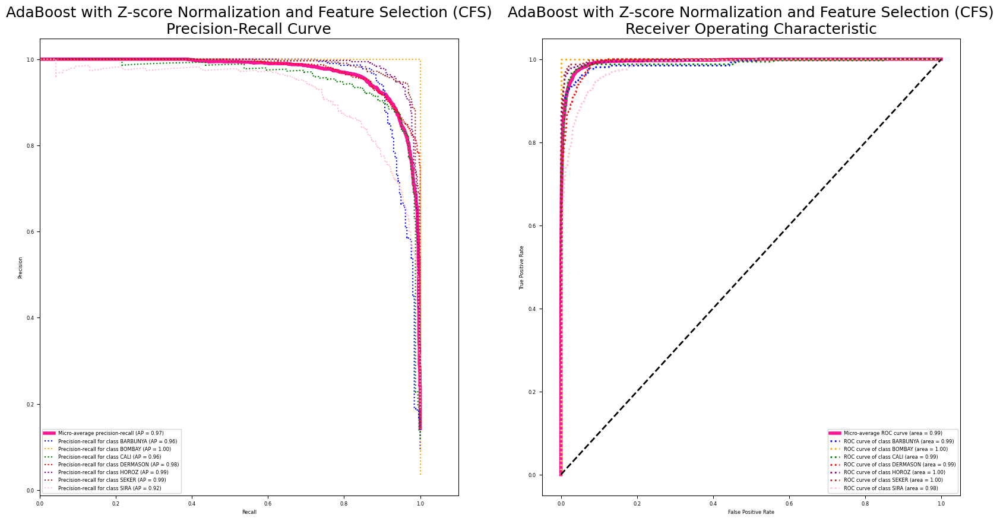

In [202]:
params = {
    "n_estimators": [10, 20, 50, 100]
}
X_train, X_test, y_train, y_test = train_test_split(data_z_score[feature_sel_cfs], y_1hot,test_size=0.2)
clf = OneVsRestClassifier(model_selection.GridSearchCV(ensemble.AdaBoostClassifier(random_state=9099),
                                 params, cv=10, n_jobs=-1))
clf.fit(X_train, y_train)

# predict from the model
predY = clf.predict(X_test)

# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))
y_score = clf.predict_proba(X_test)

print("=== Best Parameter ===")
for i in range(len(clf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + clf.estimators_[i].best_params_.__str__())
plot_prc_roc_curve(y_score, y_test, class_label_order, "AdaBoost with Z-score Normalization and Feature Selection (CFS)")

/Users/tanhaofeng/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.93      0.92      0.93       238
           1       0.99      1.00      1.00       113
           2       0.93      0.93      0.93       339
           3       0.90      0.93      0.91       709
           4       0.96      0.93      0.95       390
           5       0.98      0.96      0.97       416
           6       0.87      0.84      0.86       518

   micro avg       0.93      0.92      0.92      2723
   macro avg       0.94      0.93      0.93      2723
weighted avg       0.93      0.92      0.92      2723
 samples avg       0.91      0.92      0.91      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'n_estimators': 100}
Classifier for class BOMBAY: {'n_estimators': 10}
Classifier for class CALI: {'n_estimators': 100}
Classifier for class DERMASON: {'n_estimators': 50}
Classifier for class HOROZ: {'n_estimators': 50}
Classifier for class SEKER: {'n_estimators': 20}
Classifier for class SIR

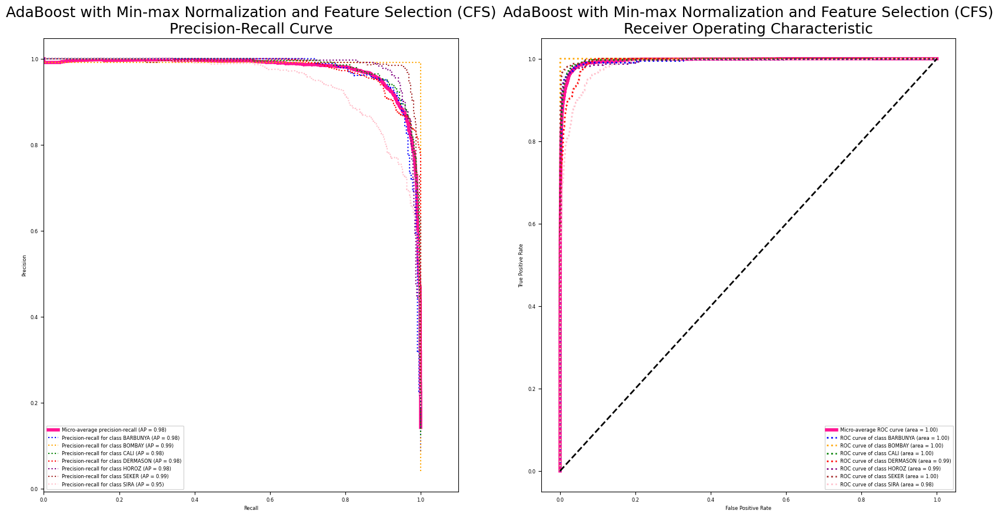

In [203]:
params = {
    "n_estimators": [10, 20, 50, 100]
}
X_train, X_test, y_train, y_test = train_test_split(data_min_max[feature_sel_cfs], y_1hot,test_size=0.2)
clf = OneVsRestClassifier(model_selection.GridSearchCV(ensemble.AdaBoostClassifier(random_state=9099),
                                 params, cv=10, n_jobs=-1))
clf.fit(X_train, y_train)

# predict from the model
predY = clf.predict(X_test)

# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))
y_score = clf.predict_proba(X_test)

print("=== Best Parameter ===")
for i in range(len(clf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + clf.estimators_[i].best_params_.__str__())
plot_prc_roc_curve(y_score, y_test, class_label_order, "AdaBoost with Min-max Normalization and Feature Selection (CFS)")

/Users/tanhaofeng/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.89      0.89      0.89       257
           1       1.00      1.00      1.00       112
           2       0.91      0.91      0.91       329
           3       0.88      0.92      0.90       675
           4       0.97      0.93      0.95       352
           5       0.96      0.93      0.94       421
           6       0.86      0.85      0.85       577

   micro avg       0.91      0.90      0.91      2723
   macro avg       0.93      0.92      0.92      2723
weighted avg       0.91      0.90      0.91      2723
 samples avg       0.89      0.90      0.90      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'n_estimators': 100}
Classifier for class BOMBAY: {'n_estimators': 10}
Classifier for class CALI: {'n_estimators': 100}
Classifier for class DERMASON: {'n_estimators': 100}
Classifier for class HOROZ: {'n_estimators': 100}
Classifier for class SEKER: {'n_estimators': 50}
Classifier for class S

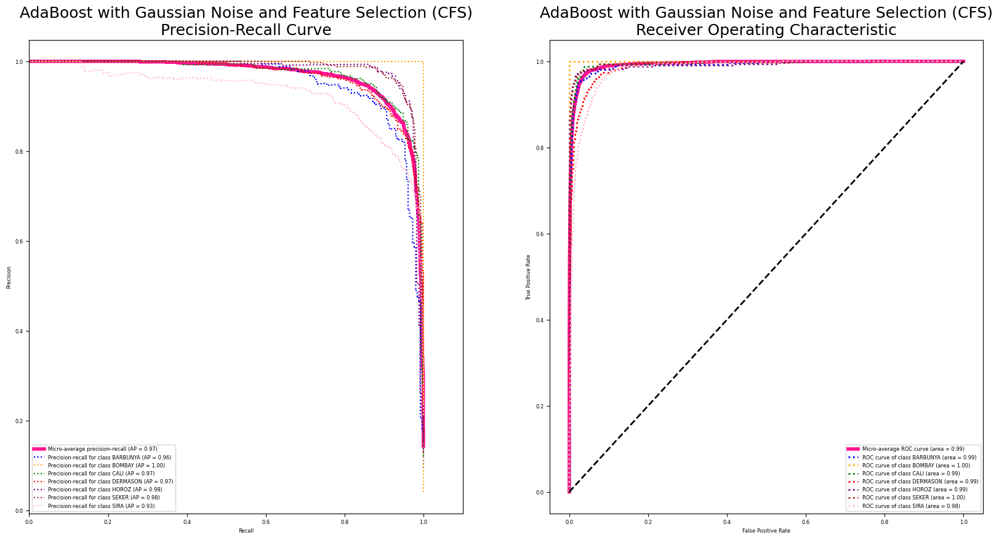

In [204]:
params = {
    "n_estimators": [10, 20, 50, 100]
}
X_train, X_test, y_train, y_test = train_test_split(data_gaussian[feature_sel_cfs], y_1hot,test_size=0.2)
clf = OneVsRestClassifier(model_selection.GridSearchCV(ensemble.AdaBoostClassifier(random_state=9099),
                                 params, cv=10, n_jobs=-1))
clf.fit(X_train, y_train)

# predict from the model
predY = clf.predict(X_test)

# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))
y_score = clf.predict_proba(X_test)

print("=== Best Parameter ===")
for i in range(len(clf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + clf.estimators_[i].best_params_.__str__())
plot_prc_roc_curve(y_score, y_test, class_label_order, "AdaBoost with Gaussian Noise and Feature Selection (CFS)")

/Users/tanhaofeng/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.92      0.86      0.89       249
           1       0.99      1.00      1.00       117
           2       0.93      0.93      0.93       330
           3       0.90      0.93      0.92       700
           4       0.95      0.93      0.94       367
           5       0.93      0.92      0.93       411
           6       0.90      0.85      0.88       549

   micro avg       0.92      0.91      0.91      2723
   macro avg       0.93      0.92      0.92      2723
weighted avg       0.92      0.91      0.91      2723
 samples avg       0.90      0.91      0.90      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'n_estimators': 100}
Classifier for class BOMBAY: {'n_estimators': 10}
Classifier for class CALI: {'n_estimators': 100}
Classifier for class DERMASON: {'n_estimators': 50}
Classifier for class HOROZ: {'n_estimators': 100}
Classifier for class SEKER: {'n_estimators': 100}
Classifier for class S

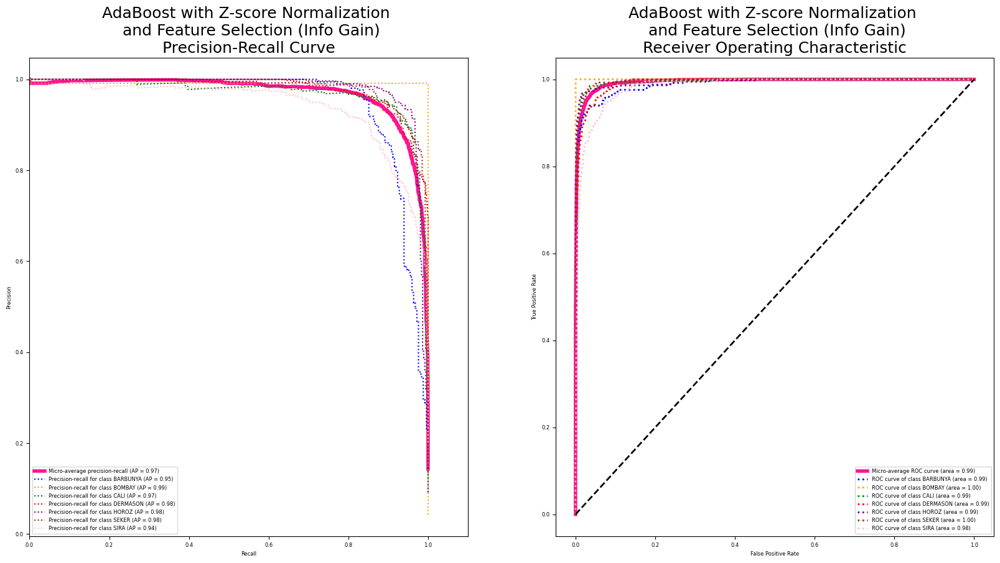

In [205]:
params = {
    "n_estimators": [10, 20, 50, 100]
}
X_train, X_test, y_train, y_test = train_test_split(data_z_score[feature_sel_info_gain], y_1hot,test_size=0.2)
clf = OneVsRestClassifier(model_selection.GridSearchCV(ensemble.AdaBoostClassifier(random_state=9099),
                                 params, cv=10, n_jobs=-1))
clf.fit(X_train, y_train)

# predict from the model
predY = clf.predict(X_test)

# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))
y_score = clf.predict_proba(X_test)

print("=== Best Parameter ===")
for i in range(len(clf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + clf.estimators_[i].best_params_.__str__())
plot_prc_roc_curve(y_score, y_test, class_label_order, "AdaBoost with Z-score Normalization \n and Feature Selection (Info Gain)")

/Users/tanhaofeng/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.91      0.89      0.90       289
           1       1.00      0.99      1.00       119
           2       0.91      0.91      0.91       339
           3       0.89      0.93      0.91       708
           4       0.96      0.92      0.94       377
           5       0.95      0.93      0.94       389
           6       0.87      0.83      0.85       502

   micro avg       0.91      0.90      0.91      2723
   macro avg       0.93      0.91      0.92      2723
weighted avg       0.91      0.90      0.91      2723
 samples avg       0.90      0.90      0.90      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'n_estimators': 100}
Classifier for class BOMBAY: {'n_estimators': 10}
Classifier for class CALI: {'n_estimators': 50}
Classifier for class DERMASON: {'n_estimators': 100}
Classifier for class HOROZ: {'n_estimators': 50}
Classifier for class SEKER: {'n_estimators': 100}
Classifier for class SI

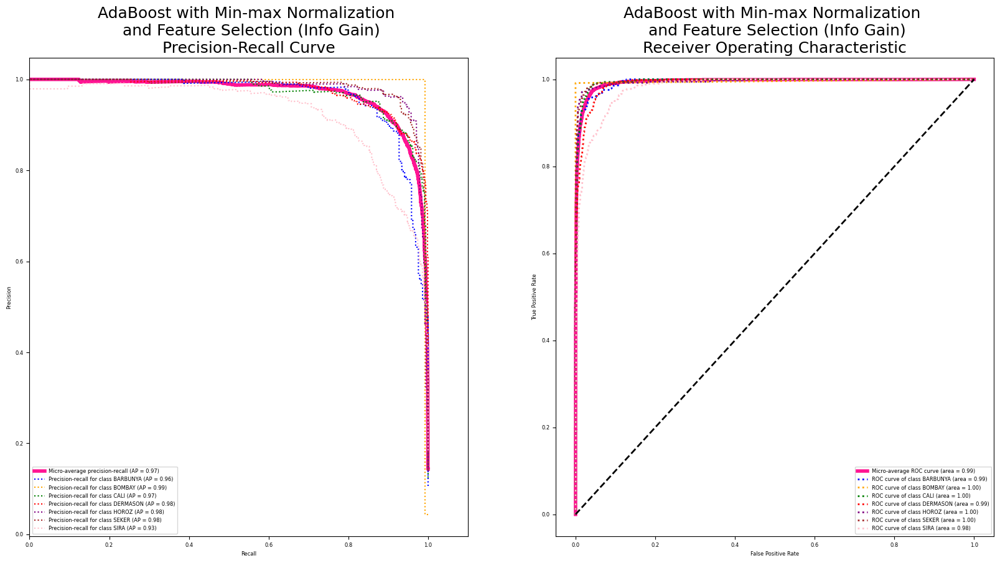

In [206]:
params = {
    "n_estimators": [10, 20, 50, 100]
}
X_train, X_test, y_train, y_test = train_test_split(data_min_max[feature_sel_info_gain], y_1hot,test_size=0.2)
clf = OneVsRestClassifier(model_selection.GridSearchCV(ensemble.AdaBoostClassifier(random_state=9099),
                                 params, cv=10, n_jobs=-1))
clf.fit(X_train, y_train)

# predict from the model
predY = clf.predict(X_test)

# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))
y_score = clf.predict_proba(X_test)

print("=== Best Parameter ===")
for i in range(len(clf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + clf.estimators_[i].best_params_.__str__())
plot_prc_roc_curve(y_score, y_test, class_label_order, "AdaBoost with Min-max Normalization \n and Feature Selection (Info Gain)")

/Users/tanhaofeng/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.92      0.82      0.86       287
           1       1.00      1.00      1.00       119
           2       0.89      0.90      0.90       357
           3       0.91      0.90      0.91       677
           4       0.96      0.92      0.94       381
           5       0.94      0.92      0.93       392
           6       0.84      0.85      0.85       510

   micro avg       0.91      0.89      0.90      2723
   macro avg       0.92      0.90      0.91      2723
weighted avg       0.91      0.89      0.90      2723
 samples avg       0.88      0.89      0.89      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'n_estimators': 50}
Classifier for class BOMBAY: {'n_estimators': 10}
Classifier for class CALI: {'n_estimators': 100}
Classifier for class DERMASON: {'n_estimators': 50}
Classifier for class HOROZ: {'n_estimators': 100}
Classifier for class SEKER: {'n_estimators': 50}
Classifier for class SIR

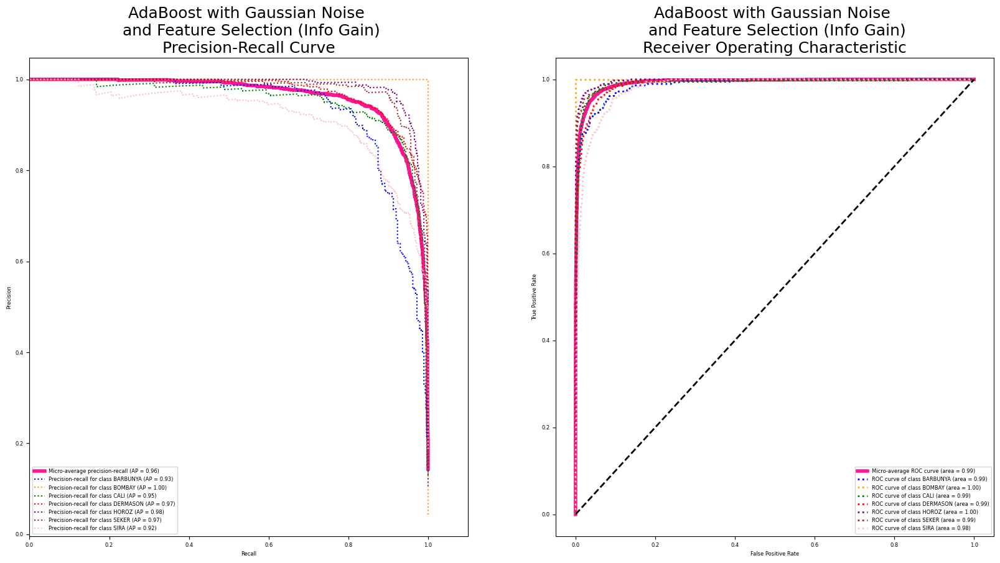

In [207]:
params = {
    "n_estimators": [10, 20, 50, 100]
}
X_train, X_test, y_train, y_test = train_test_split(data_gaussian[feature_sel_info_gain], y_1hot,test_size=0.2)
clf = OneVsRestClassifier(model_selection.GridSearchCV(ensemble.AdaBoostClassifier(random_state=9099),
                                 params, cv=10, n_jobs=-1))
clf.fit(X_train, y_train)

# predict from the model
predY = clf.predict(X_test)

# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))
y_score = clf.predict_proba(X_test)

print("=== Best Parameter ===")
for i in range(len(clf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + clf.estimators_[i].best_params_.__str__())
plot_prc_roc_curve(y_score, y_test, class_label_order, "AdaBoost with Gaussian Noise \n and Feature Selection (Info Gain)")

### 2.2.6 Classication with SMOTE and feature selection / z-score

['BARBUNYA' 'BOMBAY' 'CALI' 'DERMASON' 'HOROZ' 'SEKER' 'SIRA']


/Users/tanhaofeng/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.96      0.92      0.94       691
           1       1.00      1.00      1.00       675
           2       0.93      0.94      0.93       738
           3       0.92      0.87      0.90       729
           4       0.96      0.96      0.96       691
           5       0.97      0.96      0.96       737
           6       0.85      0.87      0.86       704

   micro avg       0.94      0.93      0.94      4965
   macro avg       0.94      0.93      0.94      4965
weighted avg       0.94      0.93      0.94      4965
 samples avg       0.92      0.93      0.93      4965

=== Best Parameter ===
Classifier for class BARBUNYA: {'n_estimators': 100}
Classifier for class BOMBAY: {'n_estimators': 100}
Classifier for class CALI: {'n_estimators': 100}
Classifier for class DERMASON: {'n_estimators': 100}
Classifier for class HOROZ: {'n_estimators': 100}
Classifier for class SEKER: {'n_estimators': 100}
Classifier for class

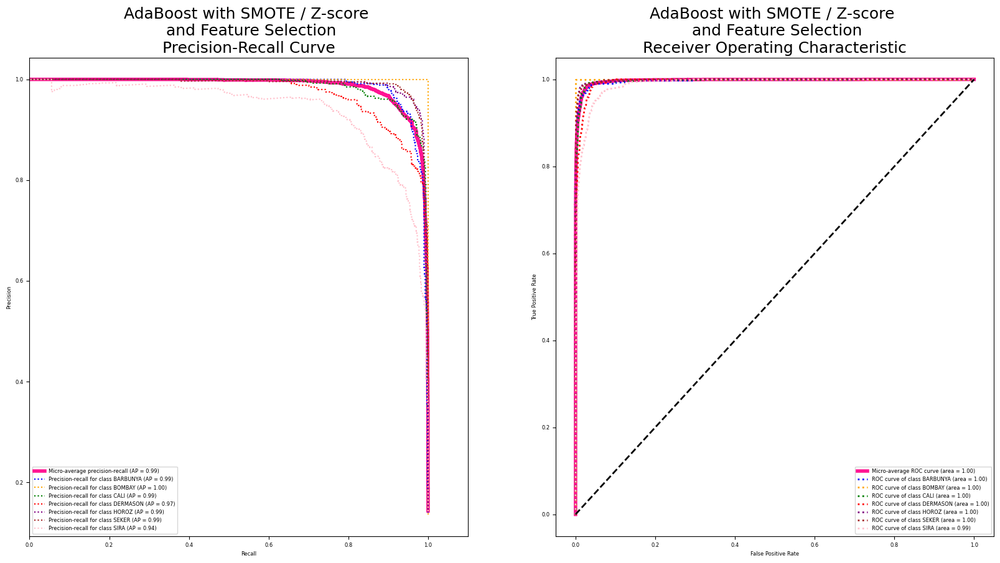

In [208]:
x = data_smote.drop('Class', axis= 1)
y = data_smote['Class']

encoder = LabelBinarizer()
y_1hot2 = encoder.fit_transform(y)
class_1hot = np.array([[1,0,0,0,0,0,0], 
         [0,1,0,0,0,0,0], 
         [0,0,1,0,0,0,0], 
         [0,0,0,1,0,0,0], 
         [0,0,0,0,1,0,0], 
         [0,0,0,0,0,1,0], 
         [0,0,0,0,0,0,1]])
class_label_order = encoder.inverse_transform(class_1hot)
print(class_label_order)


params = {
    "n_estimators": [10, 20, 50, 100]
}
X_train, X_test, y_train, y_test = train_test_split(x, y_1hot2,test_size=0.2)
clf = OneVsRestClassifier(model_selection.GridSearchCV(ensemble.AdaBoostClassifier(random_state=9099),
                                 params, cv=10, n_jobs=-1))
clf.fit(X_train, y_train)

# predict from the model
predY = clf.predict(X_test)

# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))
y_score = clf.predict_proba(X_test)

print("=== Best Parameter ===")
for i in range(len(clf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + clf.estimators_[i].best_params_.__str__())
plot_prc_roc_curve(y_score, y_test, class_label_order, "AdaBoost with SMOTE / Z-score \n and Feature Selection")

## 2.3. Clustering: KNN

### 2.3.1. Classification with Original Data

In [10]:
x = data.drop('Class', axis= 1)
y = data['Class']
x.head(3)
y.head(3)

0    SEKER
1    SEKER
2    SEKER
Name: Class, dtype: object

In [11]:
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2)

In [12]:
X_test = X_test.to_numpy()
X_train = X_train.to_numpy()
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()

In [13]:
encoder = LabelBinarizer()
y_1hot2 = encoder.fit_transform(y_test)
class_1hot = np.array([[1,0,0,0,0,0,0], 
         [0,1,0,0,0,0,0], 
         [0,0,1,0,0,0,0], 
         [0,0,0,1,0,0,0], 
         [0,0,0,0,1,0,0], 
         [0,0,0,0,0,1,0], 
         [0,0,0,0,0,0,1]])
class_label_order = encoder.inverse_transform(class_1hot)
print(class_label_order)

['BARBUNYA' 'BOMBAY' 'CALI' 'DERMASON' 'HOROZ' 'SEKER' 'SIRA']


In [14]:
rf = OneVsRestClassifier(model_selection.GridSearchCV(KNeighborsClassifier(n_jobs=-1),
                                 {"n_neighbors": [2,4,8,16]}, cv=10, n_jobs=-1))
rf.fit(X_train,y_train)
rf.predict(X_test)[0:10]
rf.score(X_test,y_test)
# predict from the model
predY = rf.predict(X_test)

# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))



y_score = rf.predict_proba(X_test)
y = label_binarize(y_test, classes=[0, 1, 2, 3, 4, 5 ,6])
n_classes = y.shape[1]

print("=== Best Parameter ===")
for i in range(len(rf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + rf.estimators_[i].best_params_.__str__())

              precision    recall  f1-score   support

    BARBUNYA       0.56      0.41      0.48       260
      BOMBAY       1.00      0.99      1.00       114
        CALI       0.66      0.69      0.68       313
    DERMASON       0.86      0.85      0.86       678
       HOROZ       0.74      0.73      0.73       409
       SEKER       0.78      0.68      0.73       419
        SIRA       0.65      0.80      0.72       530

    accuracy                           0.74      2723
   macro avg       0.75      0.74      0.74      2723
weighted avg       0.75      0.74      0.74      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'n_neighbors': 2}
Classifier for class BOMBAY: {'n_neighbors': 2}
Classifier for class CALI: {'n_neighbors': 8}
Classifier for class DERMASON: {'n_neighbors': 4}
Classifier for class HOROZ: {'n_neighbors': 2}
Classifier for class SEKER: {'n_neighbors': 2}
Classifier for class SIRA: {'n_neighbors': 4}


average: 0.7343420297206935
average2: 0.9180680889798309


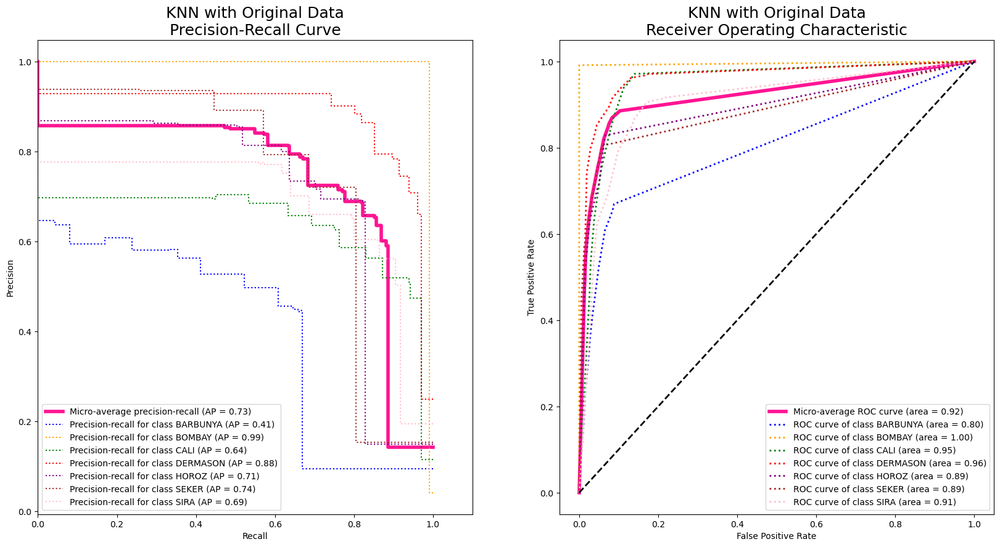

In [15]:
y_test = y_1hot2
plot_prc_roc_curve(y_score, y_test, class_label_order, "KNN with Original Data")

### 2.3.2. Classification with Normalized Data


In [17]:
x = data_z_score.drop('Class', axis= 1)
y = data_z_score['Class']
x.head(3)
y.head(3)

0    SEKER
1    SEKER
2    SEKER
Name: Class, dtype: object

In [18]:
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2)
X_test = X_test.to_numpy()
X_train = X_train.to_numpy()
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()

In [19]:
encoder = LabelBinarizer()
y_1hot2 = encoder.fit_transform(y_test)
class_1hot = np.array([[1,0,0,0,0,0,0], 
         [0,1,0,0,0,0,0], 
         [0,0,1,0,0,0,0], 
         [0,0,0,1,0,0,0], 
         [0,0,0,0,1,0,0], 
         [0,0,0,0,0,1,0], 
         [0,0,0,0,0,0,1]])
class_label_order = encoder.inverse_transform(class_1hot)
print(class_label_order)

['BARBUNYA' 'BOMBAY' 'CALI' 'DERMASON' 'HOROZ' 'SEKER' 'SIRA']


In [20]:
rf = OneVsRestClassifier(model_selection.GridSearchCV(KNeighborsClassifier(n_jobs=-1),
                                 {"n_neighbors": [2,4,8,16]}, cv=10, n_jobs=-1))
rf.fit(X_train,y_train)
rf.predict(X_test)[0:10]
rf.score(X_test,y_test)
# predict from the model
predY = rf.predict(X_test)

# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))



y_score = rf.predict_proba(X_test)
y = label_binarize(y_test, classes=[0, 1, 2, 3, 4, 5 ,6])
n_classes = y.shape[1]

print("=== Best Parameter ===")
for i in range(len(rf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + rf.estimators_[i].best_params_.__str__())

              precision    recall  f1-score   support

    BARBUNYA       0.97      0.90      0.93       270
      BOMBAY       1.00      1.00      1.00        94
        CALI       0.91      0.95      0.93       316
    DERMASON       0.93      0.92      0.93       741
       HOROZ       0.96      0.94      0.95       375
       SEKER       0.96      0.94      0.95       408
        SIRA       0.85      0.91      0.88       519

    accuracy                           0.93      2723
   macro avg       0.94      0.94      0.94      2723
weighted avg       0.93      0.93      0.93      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'n_neighbors': 16}
Classifier for class BOMBAY: {'n_neighbors': 2}
Classifier for class CALI: {'n_neighbors': 8}
Classifier for class DERMASON: {'n_neighbors': 16}
Classifier for class HOROZ: {'n_neighbors': 16}
Classifier for class SEKER: {'n_neighbors': 8}
Classifier for class SIRA: {'n_neighbors': 8}


average: 0.9649429688628344
average2: 0.9896298862260059


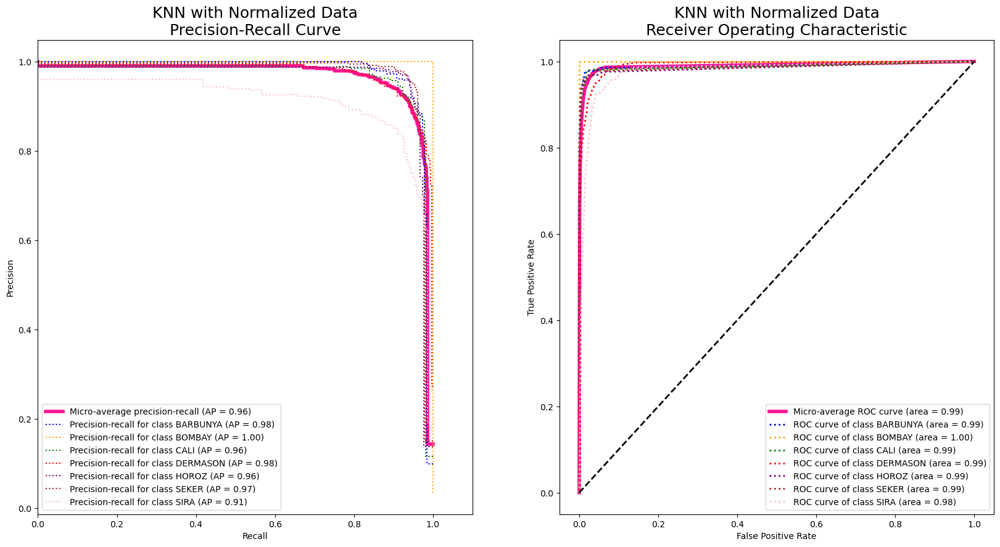

In [21]:
y_test = y_1hot2
plot_prc_roc_curve(y_score, y_test, class_label_order, "KNN with Normalized Data")

#### MinMax

In [22]:
x = data_min_max.drop('Class', axis= 1)
y = data_min_max['Class']
x.head(3)
y.head(3)
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2)
X_test = X_test.to_numpy()
X_train = X_train.to_numpy()
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()
encoder = LabelBinarizer()
y_1hot2 = encoder.fit_transform(y_test)
class_1hot = np.array([[1,0,0,0,0,0,0], 
         [0,1,0,0,0,0,0], 
         [0,0,1,0,0,0,0], 
         [0,0,0,1,0,0,0], 
         [0,0,0,0,1,0,0], 
         [0,0,0,0,0,1,0], 
         [0,0,0,0,0,0,1]])
class_label_order = encoder.inverse_transform(class_1hot)
print(class_label_order)
rf = OneVsRestClassifier(model_selection.GridSearchCV(KNeighborsClassifier(n_jobs=-1),
                                 {"n_neighbors": [2,4,8,16]}, cv=10, n_jobs=-1))
rf.fit(X_train,y_train)
rf.predict(X_test)[0:10]
rf.score(X_test,y_test)
# predict from the model
predY = rf.predict(X_test)

# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))



y_score = rf.predict_proba(X_test)
y = label_binarize(y_test, classes=[0, 1, 2, 3, 4, 5 ,6])
n_classes = y.shape[1]

print("=== Best Parameter ===")
for i in range(len(rf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + rf.estimators_[i].best_params_.__str__())

['BARBUNYA' 'BOMBAY' 'CALI' 'DERMASON' 'HOROZ' 'SEKER' 'SIRA']
              precision    recall  f1-score   support

    BARBUNYA       0.94      0.87      0.91       252
      BOMBAY       1.00      1.00      1.00       102
        CALI       0.91      0.95      0.93       328
    DERMASON       0.92      0.92      0.92       722
       HOROZ       0.97      0.94      0.95       404
       SEKER       0.95      0.95      0.95       403
        SIRA       0.84      0.87      0.86       512

    accuracy                           0.92      2723
   macro avg       0.93      0.93      0.93      2723
weighted avg       0.92      0.92      0.92      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'n_neighbors': 4}
Classifier for class BOMBAY: {'n_neighbors': 2}
Classifier for class CALI: {'n_neighbors': 8}
Classifier for class DERMASON: {'n_neighbors': 16}
Classifier for class HOROZ: {'n_neighbors': 8}
Classifier for class SEKER: {'n_neighbors': 16}
Classifier for class SIRA: 

average: 0.9693696727687897
average2: 0.9917634436358587


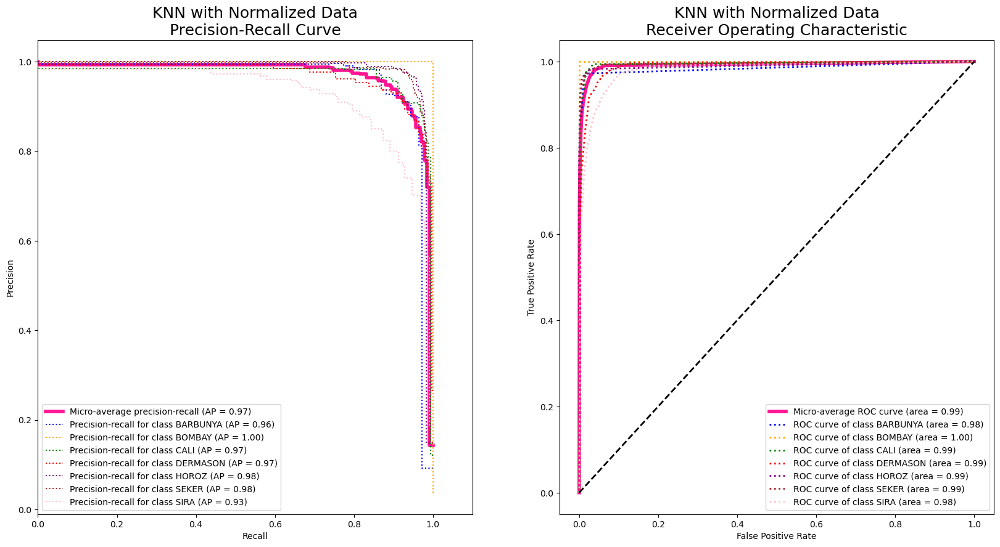

In [23]:
y_test = y_1hot2
plot_prc_roc_curve(y_score, y_test, class_label_order, "KNN with Normalized Data")

### 2.3.3. Classification with Feature Selection
- CfsSubsetEval

In [26]:
x = data_norm[feature_sel_cfs]
y = data_norm['Class']
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2)
X_test = X_test.to_numpy()
X_train = X_train.to_numpy()
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()

In [27]:
encoder = LabelBinarizer()
y_1hot2 = encoder.fit_transform(y_test)
class_1hot = np.array([[1,0,0,0,0,0,0], 
         [0,1,0,0,0,0,0], 
         [0,0,1,0,0,0,0], 
         [0,0,0,1,0,0,0], 
         [0,0,0,0,1,0,0], 
         [0,0,0,0,0,1,0], 
         [0,0,0,0,0,0,1]])
class_label_order = encoder.inverse_transform(class_1hot)
print(class_label_order)

['BARBUNYA' 'BOMBAY' 'CALI' 'DERMASON' 'HOROZ' 'SEKER' 'SIRA']


In [28]:
rf = OneVsRestClassifier(model_selection.GridSearchCV(KNeighborsClassifier(n_jobs=-1),
                                 {"n_neighbors": [2,4,8,16]}, cv=10, n_jobs=-1))
rf.fit(X_train,y_train)
rf.predict(X_test)[0:10]
rf.score(X_test,y_test)
# predict from the model
predY = rf.predict(X_test)

# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))



y_score = rf.predict_proba(X_test)
y = label_binarize(y_test, classes=[0, 1, 2, 3, 4, 5 ,6])
n_classes = y.shape[1]


print("=== Best Parameter ===")
for i in range(len(rf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + rf.estimators_[i].best_params_.__str__())

              precision    recall  f1-score   support

    BARBUNYA       0.95      0.88      0.91       262
      BOMBAY       1.00      1.00      1.00       100
        CALI       0.92      0.95      0.94       328
    DERMASON       0.92      0.92      0.92       681
       HOROZ       0.97      0.95      0.96       371
       SEKER       0.97      0.96      0.96       427
        SIRA       0.87      0.90      0.88       554

    accuracy                           0.93      2723
   macro avg       0.94      0.94      0.94      2723
weighted avg       0.93      0.93      0.93      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'n_neighbors': 8}
Classifier for class BOMBAY: {'n_neighbors': 2}
Classifier for class CALI: {'n_neighbors': 8}
Classifier for class DERMASON: {'n_neighbors': 16}
Classifier for class HOROZ: {'n_neighbors': 16}
Classifier for class SEKER: {'n_neighbors': 16}
Classifier for class SIRA: {'n_neighbors': 16}


average: 0.9700414879445998
average2: 0.9916952572822733


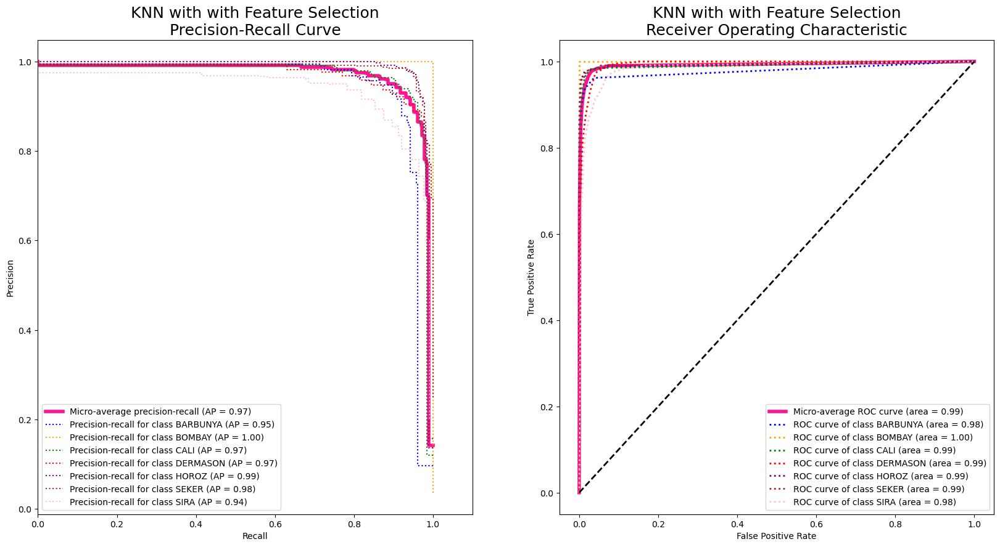

In [29]:
y_test = y_1hot2
plot_prc_roc_curve(y_score, y_test, class_label_order, "KNN with with Feature Selection")

- InfoGainAttributeEval

In [30]:
x = data_norm[feature_sel_info_gain]
y = data_norm['Class']
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2)
X_test = X_test.to_numpy()
X_train = X_train.to_numpy()
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()

In [31]:
encoder = LabelBinarizer()
y_1hot2 = encoder.fit_transform(y_test)
class_1hot = np.array([[1,0,0,0,0,0,0], 
         [0,1,0,0,0,0,0], 
         [0,0,1,0,0,0,0], 
         [0,0,0,1,0,0,0], 
         [0,0,0,0,1,0,0], 
         [0,0,0,0,0,1,0], 
         [0,0,0,0,0,0,1]])
class_label_order = encoder.inverse_transform(class_1hot)
print(class_label_order)

['BARBUNYA' 'BOMBAY' 'CALI' 'DERMASON' 'HOROZ' 'SEKER' 'SIRA']


In [32]:
rf = OneVsRestClassifier(model_selection.GridSearchCV(KNeighborsClassifier(n_jobs=-1),
                                 {"n_neighbors": [2,4,8,16]}, cv=10, n_jobs=-1))
rf.fit(X_train,y_train)
rf.predict(X_test)[0:10]
rf.score(X_test,y_test)
# predict from the model
predY = rf.predict(X_test)

# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))



y_score = rf.predict_proba(X_test)
y = label_binarize(y_test, classes=[0, 1, 2, 3, 4, 5 ,6])
n_classes = y.shape[1]

print("=== Best Parameter ===")
for i in range(len(rf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + rf.estimators_[i].best_params_.__str__())

              precision    recall  f1-score   support

    BARBUNYA       0.96      0.84      0.90       260
      BOMBAY       1.00      1.00      1.00       105
        CALI       0.90      0.95      0.93       358
    DERMASON       0.92      0.91      0.91       706
       HOROZ       0.94      0.94      0.94       369
       SEKER       0.94      0.94      0.94       396
        SIRA       0.85      0.88      0.87       529

    accuracy                           0.92      2723
   macro avg       0.93      0.92      0.93      2723
weighted avg       0.92      0.92      0.92      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'n_neighbors': 16}
Classifier for class BOMBAY: {'n_neighbors': 2}
Classifier for class CALI: {'n_neighbors': 8}
Classifier for class DERMASON: {'n_neighbors': 16}
Classifier for class HOROZ: {'n_neighbors': 16}
Classifier for class SEKER: {'n_neighbors': 16}
Classifier for class SIRA: {'n_neighbors': 16}


average: 0.9649883690493881
average2: 0.9907560680909577


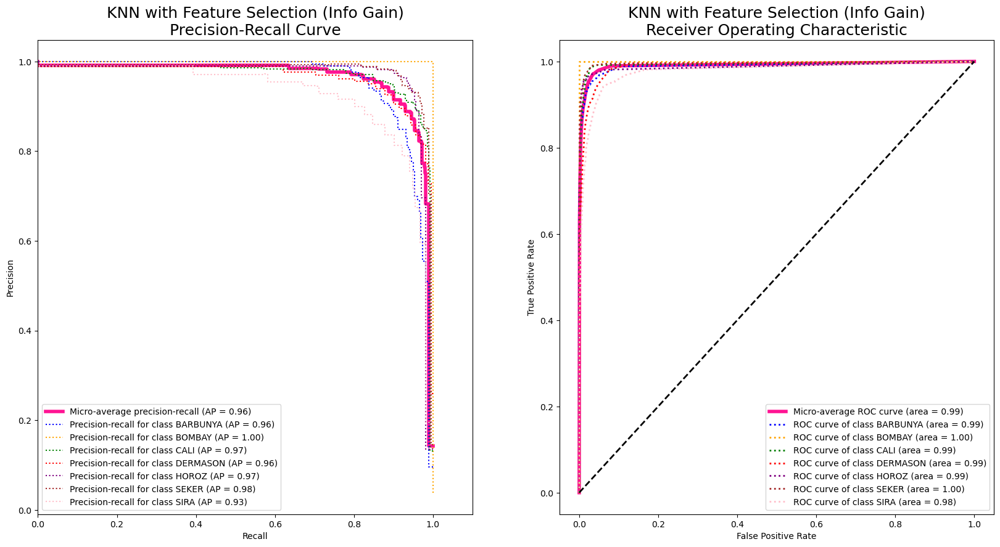

In [33]:
y_test = y_1hot2
plot_prc_roc_curve(y_score, y_test, class_label_order, "KNN with Feature Selection (Info Gain)")

### 2.3.4 Classification with Noisy Data

In [34]:
x = data_gaussian[col]
y = data_gaussian['Class']
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2)
X_test = X_test.to_numpy()
X_train = X_train.to_numpy()
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()

encoder = LabelBinarizer()
y_1hot2 = encoder.fit_transform(y_test)
class_1hot = np.array([[1,0,0,0,0,0,0], 
         [0,1,0,0,0,0,0], 
         [0,0,1,0,0,0,0], 
         [0,0,0,1,0,0,0], 
         [0,0,0,0,1,0,0], 
         [0,0,0,0,0,1,0], 
         [0,0,0,0,0,0,1]])
class_label_order = encoder.inverse_transform(class_1hot)
print(class_label_order)

rf = OneVsRestClassifier(model_selection.GridSearchCV(KNeighborsClassifier(n_jobs=-1),
                                 {"n_neighbors": [2,4,8,16]}, cv=10, n_jobs=-1))
rf.fit(X_train,y_train)
rf.predict(X_test)[0:10]
rf.score(X_test,y_test)
# predict from the model
predY = rf.predict(X_test)

# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))



y_score = rf.predict_proba(X_test)
y = label_binarize(y_test, classes=[0, 1, 2, 3, 4, 5 ,6])
n_classes = y.shape[1]

print("=== Best Parameter ===")
for i in range(len(rf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + rf.estimators_[i].best_params_.__str__())

['BARBUNYA' 'BOMBAY' 'CALI' 'DERMASON' 'HOROZ' 'SEKER' 'SIRA']


              precision    recall  f1-score   support

    BARBUNYA       0.95      0.90      0.92       235
      BOMBAY       1.00      1.00      1.00        96
        CALI       0.93      0.94      0.94       330
    DERMASON       0.92      0.90      0.91       779
       HOROZ       0.96      0.95      0.95       365
       SEKER       0.93      0.96      0.95       386
        SIRA       0.84      0.86      0.85       532

    accuracy                           0.92      2723
   macro avg       0.93      0.93      0.93      2723
weighted avg       0.92      0.92      0.92      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'n_neighbors': 8}
Classifier for class BOMBAY: {'n_neighbors': 2}
Classifier for class CALI: {'n_neighbors': 16}
Classifier for class DERMASON: {'n_neighbors': 16}
Classifier for class HOROZ: {'n_neighbors': 16}
Classifier for class SEKER: {'n_neighbors': 8}
Classifier for class SIRA: {'n_neighbors': 16}


average: 0.9613254316423374
average2: 0.9894143804851129


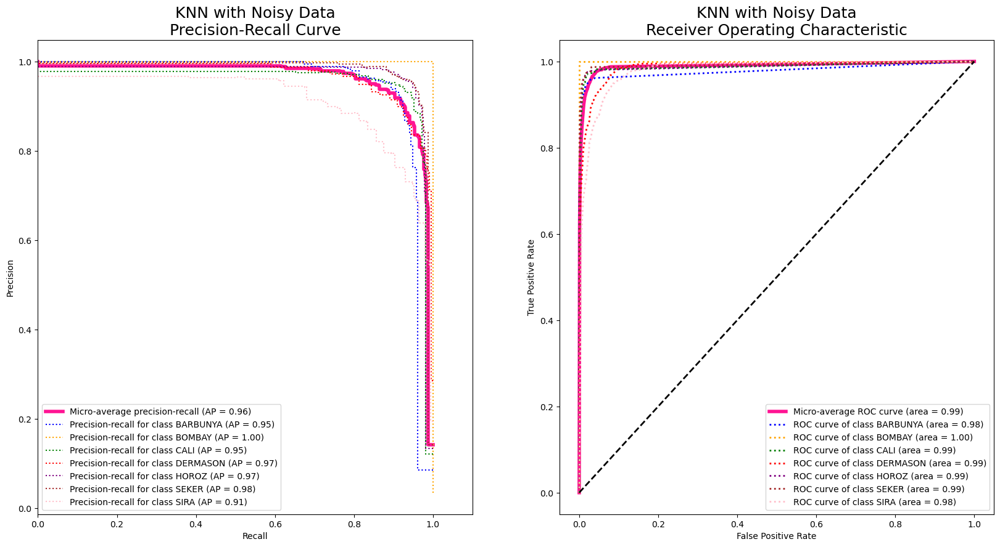

In [35]:
y_test = y_1hot2
plot_prc_roc_curve(y_score, y_test, class_label_order, "KNN with Noisy Data")

### 2.3.5 Classification with Combined Data Preprocessing Techniques

['BARBUNYA' 'BOMBAY' 'CALI' 'DERMASON' 'HOROZ' 'SEKER' 'SIRA']
              precision    recall  f1-score   support

    BARBUNYA       0.96      0.84      0.90       262
      BOMBAY       1.00      1.00      1.00        98
        CALI       0.90      0.97      0.93       340
    DERMASON       0.92      0.89      0.91       696
       HOROZ       0.96      0.94      0.95       375
       SEKER       0.95      0.94      0.94       439
        SIRA       0.83      0.89      0.86       513

    accuracy                           0.92      2723
   macro avg       0.93      0.93      0.93      2723
weighted avg       0.92      0.92      0.92      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'n_neighbors': 16}
Classifier for class BOMBAY: {'n_neighbors': 4}
Classifier for class CALI: {'n_neighbors': 16}
Classifier for class DERMASON: {'n_neighbors': 8}
Classifier for class HOROZ: {'n_neighbors': 16}
Classifier for class SEKER: {'n_neighbors': 16}
Classifier for class SIRA

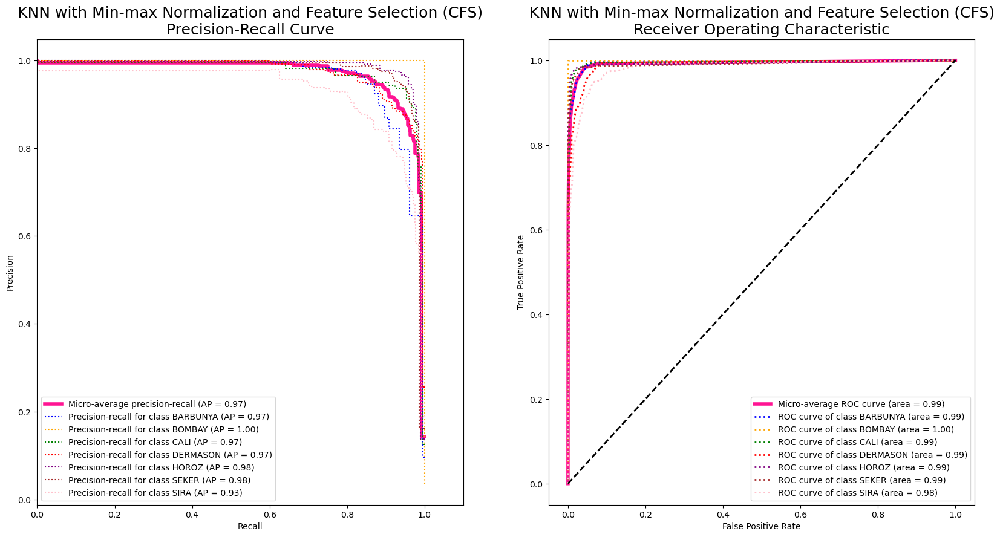

In [36]:
x = data_min_max[feature_sel_cfs]
y = data_min_max['Class']
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2)
X_test = X_test.to_numpy()
X_train = X_train.to_numpy()
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()

encoder = LabelBinarizer()
y_1hot2 = encoder.fit_transform(y_test)
class_1hot = np.array([[1,0,0,0,0,0,0], 
         [0,1,0,0,0,0,0], 
         [0,0,1,0,0,0,0], 
         [0,0,0,1,0,0,0], 
         [0,0,0,0,1,0,0], 
         [0,0,0,0,0,1,0], 
         [0,0,0,0,0,0,1]])
class_label_order = encoder.inverse_transform(class_1hot)
print(class_label_order)

rf = OneVsRestClassifier(model_selection.GridSearchCV(KNeighborsClassifier(n_jobs=-1),
                                 {"n_neighbors": [2,4,8,16]}, cv=10, n_jobs=-1))
rf.fit(X_train,y_train)
rf.predict(X_test)[0:10]
rf.score(X_test,y_test)
# predict from the model
predY = rf.predict(X_test)

# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))



y_score = rf.predict_proba(X_test)
y = label_binarize(y_test, classes=[0, 1, 2, 3, 4, 5 ,6])
n_classes = y.shape[1]

print("=== Best Parameter ===")
for i in range(len(rf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + rf.estimators_[i].best_params_.__str__())

y_test = y_1hot2
plot_prc_roc_curve(y_score, y_test, class_label_order, "KNN with Min-max Normalization and Feature Selection (CFS)")

['BARBUNYA' 'BOMBAY' 'CALI' 'DERMASON' 'HOROZ' 'SEKER' 'SIRA']
              precision    recall  f1-score   support

    BARBUNYA       0.98      0.89      0.93       274
      BOMBAY       1.00      1.00      1.00       112
        CALI       0.91      0.96      0.94       296
    DERMASON       0.91      0.91      0.91       698
       HOROZ       0.97      0.96      0.97       400
       SEKER       0.95      0.95      0.95       396
        SIRA       0.86      0.88      0.87       547

    accuracy                           0.92      2723
   macro avg       0.94      0.93      0.94      2723
weighted avg       0.92      0.92      0.92      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'n_neighbors': 8}
Classifier for class BOMBAY: {'n_neighbors': 4}
Classifier for class CALI: {'n_neighbors': 8}
Classifier for class DERMASON: {'n_neighbors': 16}
Classifier for class HOROZ: {'n_neighbors': 16}
Classifier for class SEKER: {'n_neighbors': 16}
Classifier for class SIRA:

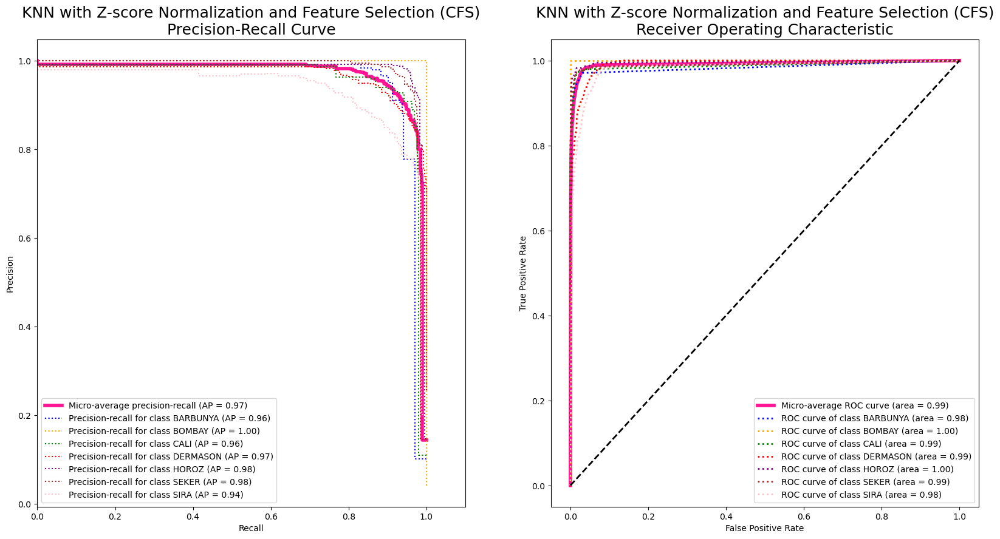

In [37]:
x = data_z_score[feature_sel_cfs]
y = data_z_score['Class']
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2)
X_test = X_test.to_numpy()
X_train = X_train.to_numpy()
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()

encoder = LabelBinarizer()
y_1hot2 = encoder.fit_transform(y_test)
class_1hot = np.array([[1,0,0,0,0,0,0], 
         [0,1,0,0,0,0,0], 
         [0,0,1,0,0,0,0], 
         [0,0,0,1,0,0,0], 
         [0,0,0,0,1,0,0], 
         [0,0,0,0,0,1,0], 
         [0,0,0,0,0,0,1]])
class_label_order = encoder.inverse_transform(class_1hot)
print(class_label_order)

rf = OneVsRestClassifier(model_selection.GridSearchCV(KNeighborsClassifier(n_jobs=-1),
                                 {"n_neighbors": [2,4,8,16]}, cv=10, n_jobs=-1))
rf.fit(X_train,y_train)
rf.predict(X_test)[0:10]
rf.score(X_test,y_test)
# predict from the model
predY = rf.predict(X_test)

# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))



y_score = rf.predict_proba(X_test)
y = label_binarize(y_test, classes=[0, 1, 2, 3, 4, 5 ,6])
n_classes = y.shape[1]

print("=== Best Parameter ===")
for i in range(len(rf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + rf.estimators_[i].best_params_.__str__())

y_test = y_1hot2
plot_prc_roc_curve(y_score, y_test, class_label_order, "KNN with Z-score Normalization and Feature Selection (CFS)")

['BARBUNYA' 'BOMBAY' 'CALI' 'DERMASON' 'HOROZ' 'SEKER' 'SIRA']


              precision    recall  f1-score   support

    BARBUNYA       0.94      0.93      0.93       255
      BOMBAY       1.00      1.00      1.00       106
        CALI       0.93      0.93      0.93       316
    DERMASON       0.91      0.91      0.91       688
       HOROZ       0.97      0.94      0.96       392
       SEKER       0.95      0.94      0.95       438
        SIRA       0.85      0.89      0.87       528

    accuracy                           0.92      2723
   macro avg       0.94      0.93      0.94      2723
weighted avg       0.92      0.92      0.92      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'n_neighbors': 8}
Classifier for class BOMBAY: {'n_neighbors': 4}
Classifier for class CALI: {'n_neighbors': 8}
Classifier for class DERMASON: {'n_neighbors': 16}
Classifier for class HOROZ: {'n_neighbors': 8}
Classifier for class SEKER: {'n_neighbors': 16}
Classifier for class SIRA: {'n_neighbors': 8}
average: 0.9661937008698572
average2: 0.9911

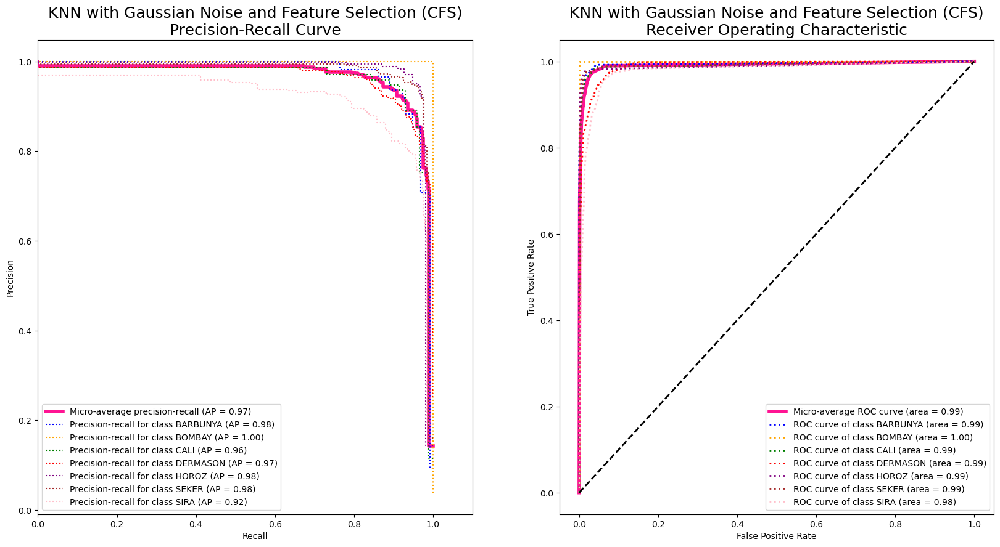

In [38]:
x = data_gaussian[feature_sel_cfs]
y = data_gaussian['Class']
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2)
X_test = X_test.to_numpy()
X_train = X_train.to_numpy()
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()

encoder = LabelBinarizer()
y_1hot2 = encoder.fit_transform(y_test)
class_1hot = np.array([[1,0,0,0,0,0,0], 
         [0,1,0,0,0,0,0], 
         [0,0,1,0,0,0,0], 
         [0,0,0,1,0,0,0], 
         [0,0,0,0,1,0,0], 
         [0,0,0,0,0,1,0], 
         [0,0,0,0,0,0,1]])
class_label_order = encoder.inverse_transform(class_1hot)
print(class_label_order)

rf = OneVsRestClassifier(model_selection.GridSearchCV(KNeighborsClassifier(n_jobs=-1),
                                 {"n_neighbors": [2,4,8,16]}, cv=10, n_jobs=-1))
rf.fit(X_train,y_train)
rf.predict(X_test)[0:10]
rf.score(X_test,y_test)
# predict from the model
predY = rf.predict(X_test)

# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))



y_score = rf.predict_proba(X_test)
y = label_binarize(y_test, classes=[0, 1, 2, 3, 4, 5 ,6])
n_classes = y.shape[1]

print("=== Best Parameter ===")
for i in range(len(rf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + rf.estimators_[i].best_params_.__str__())

y_test = y_1hot2
plot_prc_roc_curve(y_score, y_test, class_label_order, "KNN with Gaussian Noise and Feature Selection (CFS)")

['BARBUNYA' 'BOMBAY' 'CALI' 'DERMASON' 'HOROZ' 'SEKER' 'SIRA']


              precision    recall  f1-score   support

    BARBUNYA       0.91      0.86      0.89       238
      BOMBAY       1.00      1.00      1.00       101
        CALI       0.92      0.92      0.92       331
    DERMASON       0.93      0.90      0.92       741
       HOROZ       0.94      0.94      0.94       386
       SEKER       0.94      0.93      0.93       388
        SIRA       0.84      0.89      0.86       538

    accuracy                           0.91      2723
   macro avg       0.93      0.92      0.92      2723
weighted avg       0.91      0.91      0.91      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'n_neighbors': 8}
Classifier for class BOMBAY: {'n_neighbors': 2}
Classifier for class CALI: {'n_neighbors': 16}
Classifier for class DERMASON: {'n_neighbors': 16}
Classifier for class HOROZ: {'n_neighbors': 16}
Classifier for class SEKER: {'n_neighbors': 8}
Classifier for class SIRA: {'n_neighbors': 16}
average: 0.9593381119229734
average2: 0.98

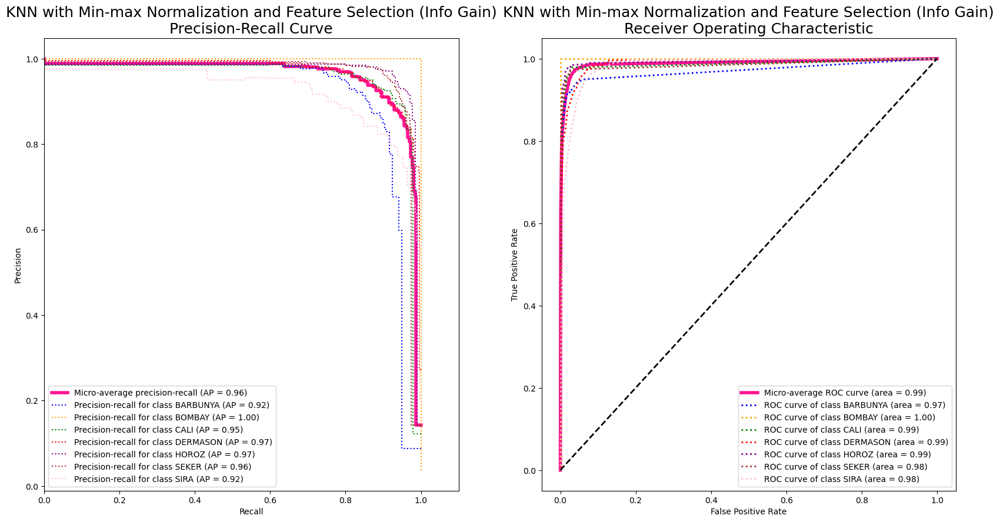

In [39]:
x = data_min_max[feature_sel_info_gain]
y = data_min_max['Class']
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2)
X_test = X_test.to_numpy()
X_train = X_train.to_numpy()
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()

encoder = LabelBinarizer()
y_1hot2 = encoder.fit_transform(y_test)
class_1hot = np.array([[1,0,0,0,0,0,0], 
         [0,1,0,0,0,0,0], 
         [0,0,1,0,0,0,0], 
         [0,0,0,1,0,0,0], 
         [0,0,0,0,1,0,0], 
         [0,0,0,0,0,1,0], 
         [0,0,0,0,0,0,1]])
class_label_order = encoder.inverse_transform(class_1hot)
print(class_label_order)

rf = OneVsRestClassifier(model_selection.GridSearchCV(KNeighborsClassifier(n_jobs=-1),
                                 {"n_neighbors": [2,4,8,16]}, cv=10, n_jobs=-1))
rf.fit(X_train,y_train)
rf.predict(X_test)[0:10]
rf.score(X_test,y_test)
# predict from the model
predY = rf.predict(X_test)

# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))



y_score = rf.predict_proba(X_test)
y = label_binarize(y_test, classes=[0, 1, 2, 3, 4, 5 ,6])
n_classes = y.shape[1]

print("=== Best Parameter ===")
for i in range(len(rf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + rf.estimators_[i].best_params_.__str__())

y_test = y_1hot2
plot_prc_roc_curve(y_score, y_test, class_label_order, "KNN with Min-max Normalization and Feature Selection (Info Gain)")

['BARBUNYA' 'BOMBAY' 'CALI' 'DERMASON' 'HOROZ' 'SEKER' 'SIRA']


              precision    recall  f1-score   support

    BARBUNYA       0.96      0.85      0.90       259
      BOMBAY       0.99      1.00      0.99        92
        CALI       0.90      0.96      0.93       328
    DERMASON       0.91      0.92      0.91       696
       HOROZ       0.96      0.95      0.95       419
       SEKER       0.94      0.95      0.94       403
        SIRA       0.86      0.87      0.87       526

    accuracy                           0.92      2723
   macro avg       0.93      0.93      0.93      2723
weighted avg       0.92      0.92      0.92      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'n_neighbors': 16}
Classifier for class BOMBAY: {'n_neighbors': 2}
Classifier for class CALI: {'n_neighbors': 16}
Classifier for class DERMASON: {'n_neighbors': 16}
Classifier for class HOROZ: {'n_neighbors': 4}
Classifier for class SEKER: {'n_neighbors': 16}
Classifier for class SIRA: {'n_neighbors': 16}
average: 0.9656195454071567
average2: 0.9

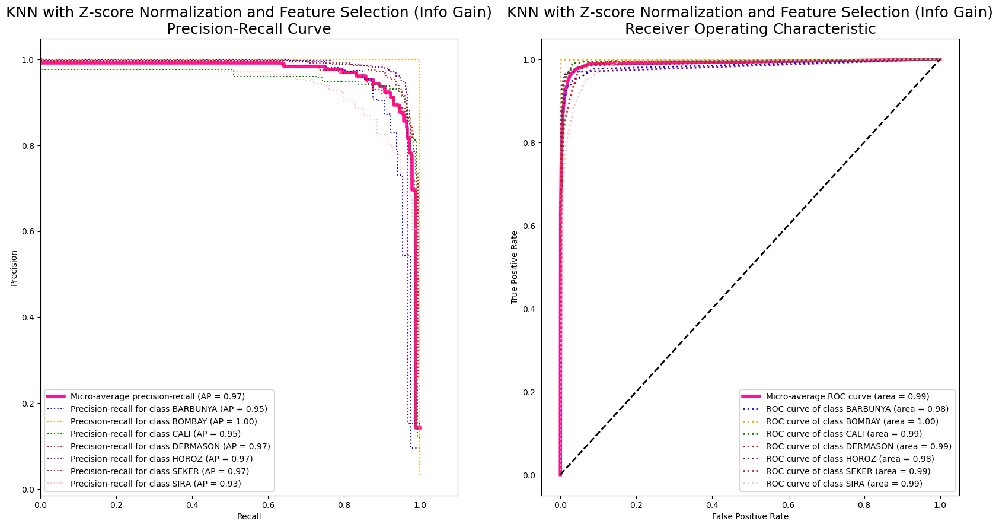

In [40]:
x = data_z_score[feature_sel_info_gain]
y = data_z_score['Class']
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2)
X_test = X_test.to_numpy()
X_train = X_train.to_numpy()
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()

encoder = LabelBinarizer()
y_1hot2 = encoder.fit_transform(y_test)
class_1hot = np.array([[1,0,0,0,0,0,0], 
         [0,1,0,0,0,0,0], 
         [0,0,1,0,0,0,0], 
         [0,0,0,1,0,0,0], 
         [0,0,0,0,1,0,0], 
         [0,0,0,0,0,1,0], 
         [0,0,0,0,0,0,1]])
class_label_order = encoder.inverse_transform(class_1hot)
print(class_label_order)

rf = OneVsRestClassifier(model_selection.GridSearchCV(KNeighborsClassifier(n_jobs=-1),
                                 {"n_neighbors": [2,4,8,16]}, cv=10, n_jobs=-1))
rf.fit(X_train,y_train)
rf.predict(X_test)[0:10]
rf.score(X_test,y_test)
# predict from the model
predY = rf.predict(X_test)

# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))



y_score = rf.predict_proba(X_test)
y = label_binarize(y_test, classes=[0, 1, 2, 3, 4, 5 ,6])
n_classes = y.shape[1]

print("=== Best Parameter ===")
for i in range(len(rf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + rf.estimators_[i].best_params_.__str__())

y_test = y_1hot2
plot_prc_roc_curve(y_score, y_test, class_label_order, "KNN with Z-score Normalization and Feature Selection (Info Gain)")

['BARBUNYA' 'BOMBAY' 'CALI' 'DERMASON' 'HOROZ' 'SEKER' 'SIRA']
              precision    recall  f1-score   support

    BARBUNYA       0.95      0.79      0.86       258
      BOMBAY       1.00      1.00      1.00       120
        CALI       0.87      0.94      0.91       336
    DERMASON       0.91      0.90      0.91       720
       HOROZ       0.96      0.94      0.95       380
       SEKER       0.94      0.96      0.95       427
        SIRA       0.81      0.87      0.84       482

    accuracy                           0.91      2723
   macro avg       0.92      0.91      0.92      2723
weighted avg       0.91      0.91      0.91      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'n_neighbors': 16}
Classifier for class BOMBAY: {'n_neighbors': 2}
Classifier for class CALI: {'n_neighbors': 16}
Classifier for class DERMASON: {'n_neighbors': 16}
Classifier for class HOROZ: {'n_neighbors': 16}
Classifier for class SEKER: {'n_neighbors': 16}
Classifier for class SIR

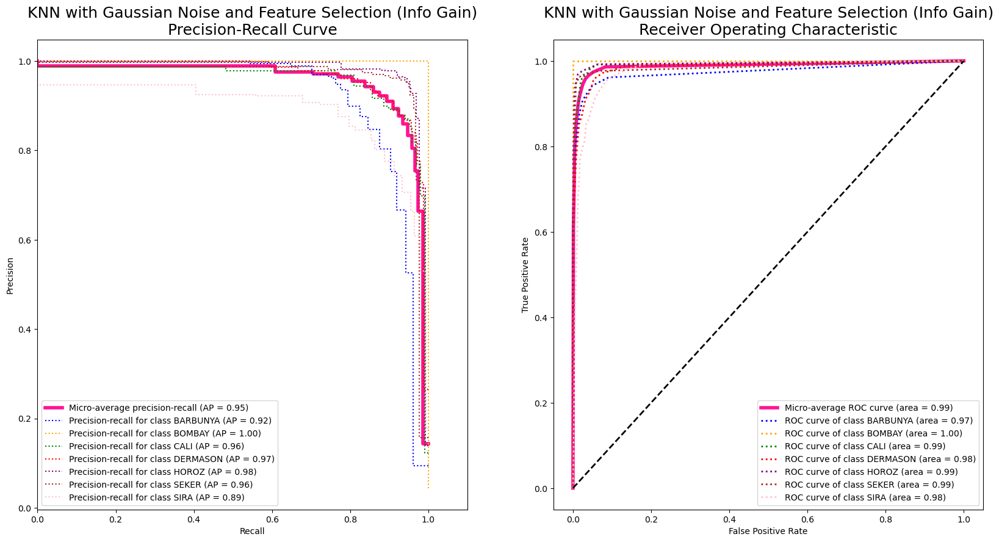

In [42]:
x = data_gaussian[feature_sel_info_gain]
y = data_gaussian['Class']
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2)
X_test = X_test.to_numpy()
X_train = X_train.to_numpy()
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()

encoder = LabelBinarizer()
y_1hot2 = encoder.fit_transform(y_test)
class_1hot = np.array([[1,0,0,0,0,0,0], 
         [0,1,0,0,0,0,0], 
         [0,0,1,0,0,0,0], 
         [0,0,0,1,0,0,0], 
         [0,0,0,0,1,0,0], 
         [0,0,0,0,0,1,0], 
         [0,0,0,0,0,0,1]])
class_label_order = encoder.inverse_transform(class_1hot)
print(class_label_order)

rf = OneVsRestClassifier(model_selection.GridSearchCV(KNeighborsClassifier(n_jobs=-1),
                                 {"n_neighbors": [2,4,8,16]}, cv=10, n_jobs=-1))
rf.fit(X_train,y_train)
rf.predict(X_test)[0:10]
rf.score(X_test,y_test)
# predict from the model
predY = rf.predict(X_test)

# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))



y_score = rf.predict_proba(X_test)
y = label_binarize(y_test, classes=[0, 1, 2, 3, 4, 5 ,6])
n_classes = y.shape[1]

print("=== Best Parameter ===")
for i in range(len(rf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + rf.estimators_[i].best_params_.__str__())

y_test = y_1hot2
plot_prc_roc_curve(y_score, y_test, class_label_order, "KNN with Gaussian Noise and Feature Selection (Info Gain)")

### 2.3.6 Classification with SMOTE and feature selection / z-score

['BARBUNYA' 'BOMBAY' 'CALI' 'DERMASON' 'HOROZ' 'SEKER' 'SIRA']
              precision    recall  f1-score   support

    BARBUNYA       0.98      0.95      0.97       732
      BOMBAY       1.00      1.00      1.00       707
        CALI       0.96      0.98      0.97       694
    DERMASON       0.93      0.89      0.91       743
       HOROZ       0.98      0.97      0.97       685
       SEKER       0.96      0.96      0.96       674
        SIRA       0.87      0.93      0.90       730

    accuracy                           0.95      4965
   macro avg       0.95      0.95      0.95      4965
weighted avg       0.95      0.95      0.95      4965

=== Best Parameter ===
Classifier for class BARBUNYA: {'n_neighbors': 2}
Classifier for class BOMBAY: {'n_neighbors': 2}
Classifier for class CALI: {'n_neighbors': 2}
Classifier for class DERMASON: {'n_neighbors': 16}
Classifier for class HOROZ: {'n_neighbors': 4}
Classifier for class SEKER: {'n_neighbors': 8}
Classifier for class SIRA: {

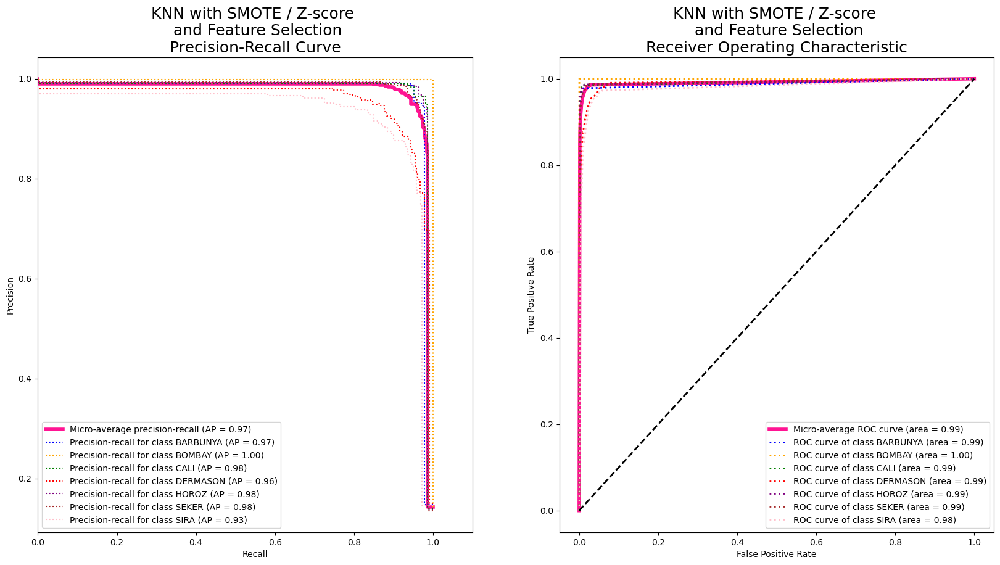

In [43]:
x = data_smote.drop('Class', axis= 1)
y = data_smote['Class']
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2)
X_test = X_test.to_numpy()
X_train = X_train.to_numpy()
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()

encoder = LabelBinarizer()
y_1hot2 = encoder.fit_transform(y_test)
class_1hot = np.array([[1,0,0,0,0,0,0], 
         [0,1,0,0,0,0,0], 
         [0,0,1,0,0,0,0], 
         [0,0,0,1,0,0,0], 
         [0,0,0,0,1,0,0], 
         [0,0,0,0,0,1,0], 
         [0,0,0,0,0,0,1]])
class_label_order = encoder.inverse_transform(class_1hot)
print(class_label_order)

rf = OneVsRestClassifier(model_selection.GridSearchCV(KNeighborsClassifier(n_jobs=-1),
                                 {"n_neighbors": [2,4,8,16]}, cv=10, n_jobs=-1))
rf.fit(X_train,y_train)
rf.predict(X_test)[0:10]
rf.score(X_test,y_test)
# predict from the model
predY = rf.predict(X_test)

# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))



y_score = rf.predict_proba(X_test)
y = label_binarize(y_test, classes=[0, 1, 2, 3, 4, 5 ,6])
n_classes = y.shape[1]

print("=== Best Parameter ===")
for i in range(len(rf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + rf.estimators_[i].best_params_.__str__())

y_test = y_1hot2
plot_prc_roc_curve(y_score, y_test, class_label_order, "KNN with SMOTE / Z-score \n and Feature Selection")

## 2.4. Decision Tree: CART

In [94]:
max_depth = [1, 3, 6, 10, 15, 20]
max_leaf_nodes = [10, 25, 50, 75, 100]

### 2.4.1 Classification with Original Data

In [95]:
x = data.drop('Class', axis= 1)
y = data['Class']
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2)
X_test = X_test.to_numpy()
X_train = X_train.to_numpy()
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()


In [96]:
encoder = LabelBinarizer()
y_1hot2 = encoder.fit_transform(y_test)
class_1hot = np.array([[1,0,0,0,0,0,0], 
         [0,1,0,0,0,0,0], 
         [0,0,1,0,0,0,0], 
         [0,0,0,1,0,0,0], 
         [0,0,0,0,1,0,0], 
         [0,0,0,0,0,1,0], 
         [0,0,0,0,0,0,1]])
class_label_order = encoder.inverse_transform(class_1hot)
print(class_label_order)

['BARBUNYA' 'BOMBAY' 'CALI' 'DERMASON' 'HOROZ' 'SEKER' 'SIRA']


In [97]:
np.seterr(divide='ignore', invalid='ignore')

# max_depth -> may underfit / overfit
rf = OneVsRestClassifier(model_selection.GridSearchCV(tree.DecisionTreeClassifier(random_state=30),
                                 {"max_depth": max_depth, "max_leaf_nodes":max_leaf_nodes,"criterion" : ["entropy", "gini"]}, cv=10, n_jobs=-1))
rf.fit(X_train,y_train)
rf.predict(X_test)
rf.score(X_test,y_test)
# predict from the model
predY = rf.predict(X_test)


# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))



y_score = rf.predict_proba(X_test)
y = label_binarize(y_test, classes=[0, 1, 2, 3, 4, 5 ,6])
n_classes = y.shape[1]

print("=== Best Parameter ===")
for i in range(len(rf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + rf.estimators_[i].best_params_.__str__())

              precision    recall  f1-score   support

    BARBUNYA       0.96      0.92      0.94       269
      BOMBAY       1.00      0.99      1.00       112
        CALI       0.94      0.97      0.95       316
    DERMASON       0.90      0.92      0.91       698
       HOROZ       0.97      0.95      0.96       400
       SEKER       0.96      0.93      0.95       395
        SIRA       0.85      0.87      0.86       533

    accuracy                           0.92      2723
   macro avg       0.94      0.93      0.94      2723
weighted avg       0.92      0.92      0.92      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'criterion': 'entropy', 'max_depth': 15, 'max_leaf_nodes': 75}
Classifier for class BOMBAY: {'criterion': 'entropy', 'max_depth': 1, 'max_leaf_nodes': 10}
Classifier for class CALI: {'criterion': 'entropy', 'max_depth': 15, 'max_leaf_nodes': 50}
Classifier for class DERMASON: {'criterion': 'gini', 'max_depth': 6, 'max_leaf_nodes': 10}
Classifier 

In [98]:
# remove nan result
y_test = y_1hot2
a = np.argwhere(np.isnan(y_score))
new = list(set(a[:, 0]))
new.sort()
new


[]

average: 0.9615900262750875
average2: 0.9880341322431789


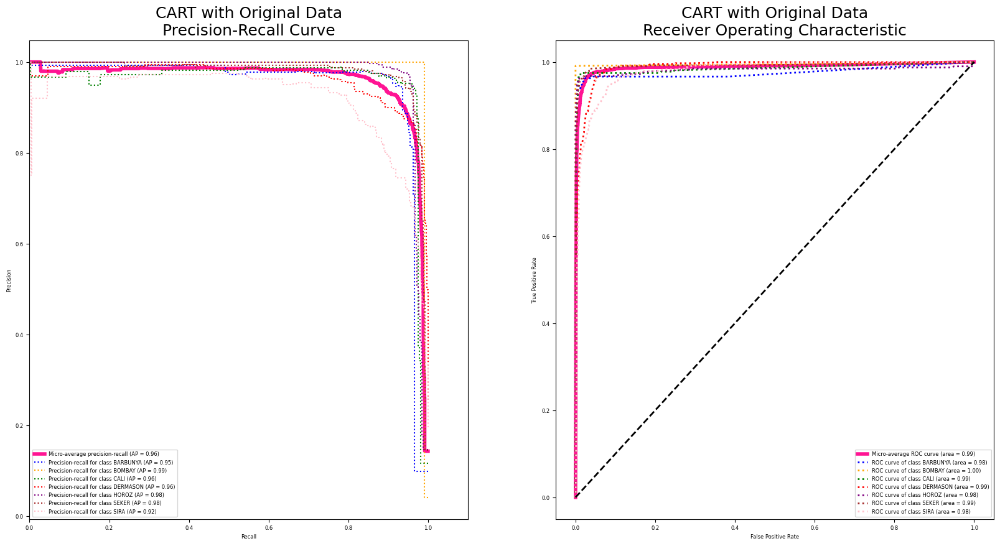

In [99]:
y_score = np.delete(y_score, new, 0)
y_test = np.delete(y_test, new, 0)
X_test= np.delete(X_test, new, 0)


plot_prc_roc_curve(y_score, y_test, class_label_order, "CART with Original Data")

### 2.4.2 Classification with Normalized Data

In [100]:
x = data_norm.drop('Class', axis= 1)
y = data_norm['Class']
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2)
X_test = X_test.to_numpy()
X_train = X_train.to_numpy()
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()

encoder = LabelBinarizer()
y_1hot2 = encoder.fit_transform(y_test)
class_1hot = np.array([[1,0,0,0,0,0,0], 
         [0,1,0,0,0,0,0], 
         [0,0,1,0,0,0,0], 
         [0,0,0,1,0,0,0], 
         [0,0,0,0,1,0,0], 
         [0,0,0,0,0,1,0], 
         [0,0,0,0,0,0,1]])
class_label_order = encoder.inverse_transform(class_1hot)
print(class_label_order)

['BARBUNYA' 'BOMBAY' 'CALI' 'DERMASON' 'HOROZ' 'SEKER' 'SIRA']


In [101]:
np.seterr(divide='ignore', invalid='ignore')

# max_depth -> may underfit / overfit
rf = OneVsRestClassifier(model_selection.GridSearchCV(tree.DecisionTreeClassifier(random_state=30),
                                 {"max_depth": max_depth,"max_leaf_nodes":max_leaf_nodes, "criterion" : ["entropy", "gini"]}, cv=10, n_jobs=-1))
rf.fit(X_train,y_train)
rf.predict(X_test)
rf.score(X_test,y_test)
# predict from the model
predY = rf.predict(X_test)


# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))



y_score = rf.predict_proba(X_test)
y = label_binarize(y_test, classes=[0, 1, 2, 3, 4, 5 ,6])
n_classes = y.shape[1]

print("=== Best Parameter ===")
for i in range(len(rf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + rf.estimators_[i].best_params_.__str__())

              precision    recall  f1-score   support

    BARBUNYA       0.96      0.89      0.93       265
      BOMBAY       0.99      1.00      1.00       111
        CALI       0.93      0.93      0.93       319
    DERMASON       0.91      0.92      0.91       702
       HOROZ       0.96      0.95      0.95       404
       SEKER       0.96      0.93      0.95       406
        SIRA       0.83      0.86      0.84       516

    accuracy                           0.92      2723
   macro avg       0.93      0.93      0.93      2723
weighted avg       0.92      0.92      0.92      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'criterion': 'gini', 'max_depth': 15, 'max_leaf_nodes': 50}
Classifier for class BOMBAY: {'criterion': 'entropy', 'max_depth': 1, 'max_leaf_nodes': 10}
Classifier for class CALI: {'criterion': 'entropy', 'max_depth': 10, 'max_leaf_nodes': 25}
Classifier for class DERMASON: {'criterion': 'gini', 'max_depth': 6, 'max_leaf_nodes': 10}
Classifier for

In [102]:
# remove nan result
y_test = y_1hot2
a = np.argwhere(np.isnan(y_score))
new = list(set(a[:, 0]))
new.sort()

y_score = np.delete(y_score, new, 0)
y_test = np.delete(y_test, new, 0)
X_test= np.delete(X_test, new, 0)



average: 0.961022413716198
average2: 0.9899190404216617


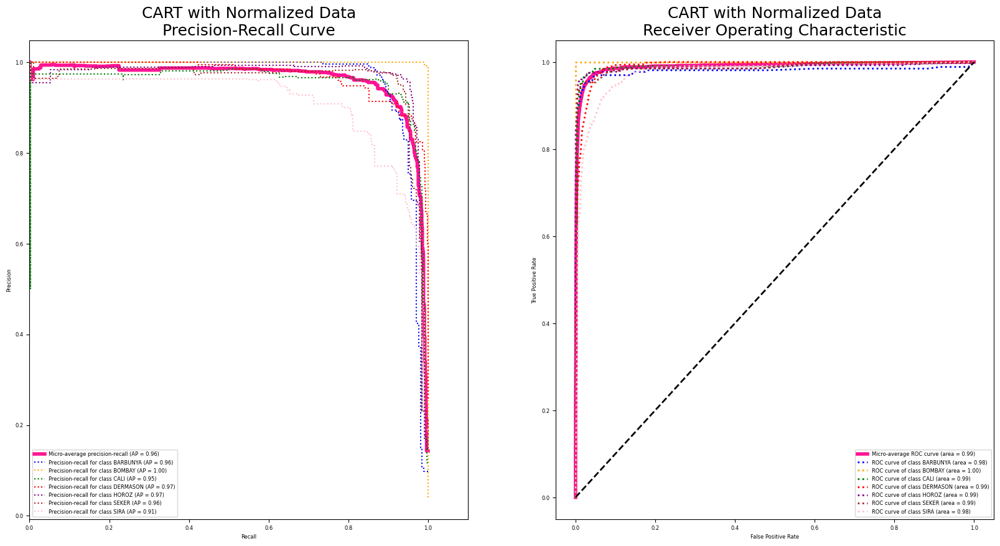

In [103]:
plot_prc_roc_curve(y_score, y_test, class_label_order, "CART with Normalized Data")

#### MinMax

In [105]:
x = data_min_max[feature_sel_cfs]
y = data_min_max['Class']
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2)
X_test = X_test.to_numpy()
X_train = X_train.to_numpy()
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()

encoder = LabelBinarizer()
y_1hot2 = encoder.fit_transform(y_test)
class_1hot = np.array([[1,0,0,0,0,0,0], 
         [0,1,0,0,0,0,0], 
         [0,0,1,0,0,0,0], 
         [0,0,0,1,0,0,0], 
         [0,0,0,0,1,0,0], 
         [0,0,0,0,0,1,0], 
         [0,0,0,0,0,0,1]])
class_label_order = encoder.inverse_transform(class_1hot)
print(class_label_order)

np.seterr(divide='ignore', invalid='ignore')

# max_depth -> may underfit / overfit
rf = OneVsRestClassifier(model_selection.GridSearchCV(tree.DecisionTreeClassifier(random_state=30),
                                 {"max_depth": max_depth, "max_leaf_nodes":max_leaf_nodes,"criterion" : ["entropy", "gini"]}, cv=10, n_jobs=-1))
rf.fit(X_train,y_train)
rf.predict(X_test)
rf.score(X_test,y_test)
# predict from the model
predY = rf.predict(X_test)


# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))



y_score = rf.predict_proba(X_test)
y = label_binarize(y_test, classes=[0, 1, 2, 3, 4, 5 ,6])
n_classes = y.shape[1]

print("=== Best Parameter ===")
for i in range(len(rf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + rf.estimators_[i].best_params_.__str__())

['BARBUNYA' 'BOMBAY' 'CALI' 'DERMASON' 'HOROZ' 'SEKER' 'SIRA']


              precision    recall  f1-score   support

    BARBUNYA       0.91      0.90      0.90       267
      BOMBAY       0.99      0.99      0.99       110
        CALI       0.91      0.92      0.92       335
    DERMASON       0.89      0.95      0.92       722
       HOROZ       0.95      0.95      0.95       379
       SEKER       0.94      0.93      0.94       379
        SIRA       0.91      0.82      0.86       531

    accuracy                           0.92      2723
   macro avg       0.93      0.92      0.93      2723
weighted avg       0.92      0.92      0.92      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'criterion': 'entropy', 'max_depth': 10, 'max_leaf_nodes': 50}
Classifier for class BOMBAY: {'criterion': 'entropy', 'max_depth': 1, 'max_leaf_nodes': 10}
Classifier for class CALI: {'criterion': 'entropy', 'max_depth': 10, 'max_leaf_nodes': 75}
Classifier for class DERMASON: {'criterion': 'gini', 'max_depth': 10, 'max_leaf_nodes': 25}
Classifier

average: 0.9537255049965324
average2: 0.9857015790237693


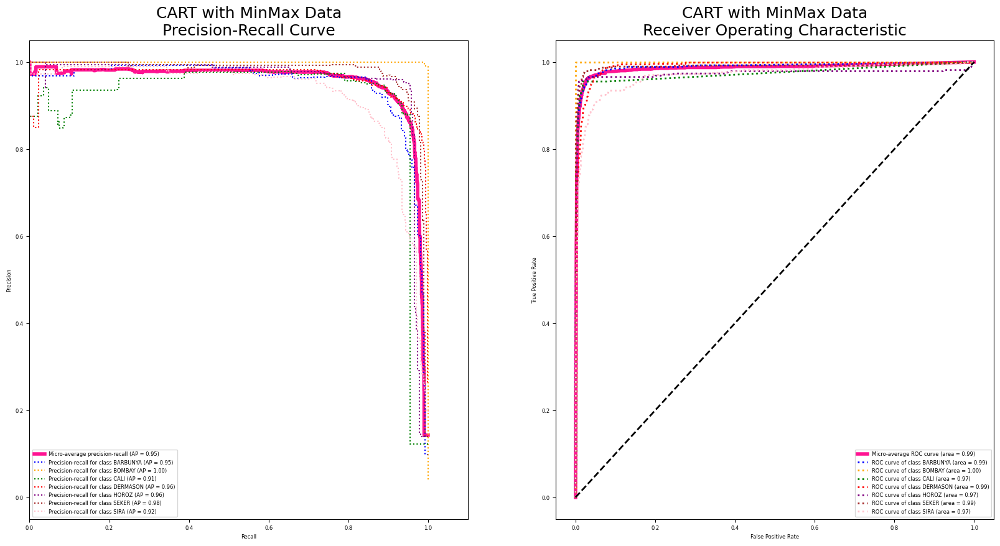

In [106]:
# remove nan result
y_test = y_1hot2
a = np.argwhere(np.isnan(y_score))
new = list(set(a[:, 0]))
new.sort()

y_score = np.delete(y_score, new, 0)
y_test = np.delete(y_test, new, 0)
X_test= np.delete(X_test, new, 0)

plot_prc_roc_curve(y_score, y_test, class_label_order, "CART with MinMax Data")

### 2.4.3 Classification with Feature Selection
- CfsSubsetEval

In [113]:
x = data_norm[feature_sel_cfs]
y = data_norm['Class']
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2)
X_test = X_test.to_numpy()
X_train = X_train.to_numpy()
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()

encoder = LabelBinarizer()
y_1hot2 = encoder.fit_transform(y_test)
class_1hot = np.array([[1,0,0,0,0,0,0], 
         [0,1,0,0,0,0,0], 
         [0,0,1,0,0,0,0], 
         [0,0,0,1,0,0,0], 
         [0,0,0,0,1,0,0], 
         [0,0,0,0,0,1,0], 
         [0,0,0,0,0,0,1]])
class_label_order = encoder.inverse_transform(class_1hot)
print(class_label_order)

['BARBUNYA' 'BOMBAY' 'CALI' 'DERMASON' 'HOROZ' 'SEKER' 'SIRA']


In [114]:
np.seterr(divide='ignore', invalid='ignore')

# max_depth -> may underfit / overfit
rf = OneVsRestClassifier(model_selection.GridSearchCV(tree.DecisionTreeClassifier(random_state=30),
                                 {"max_depth": max_depth,"max_leaf_nodes":max_leaf_nodes, "criterion" : ["entropy", "gini"]}, cv=10, n_jobs=-1))
rf.fit(X_train,y_train)
rf.predict(X_test)
rf.score(X_test,y_test)
# predict from the model
predY = rf.predict(X_test)


# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))



y_score = rf.predict_proba(X_test)
y = label_binarize(y_test, classes=[0, 1, 2, 3, 4, 5 ,6])
n_classes = y.shape[1]

print("=== Best Parameter ===")
for i in range(len(rf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + rf.estimators_[i].best_params_.__str__())

              precision    recall  f1-score   support

    BARBUNYA       0.90      0.91      0.91       239
      BOMBAY       1.00      1.00      1.00        97
        CALI       0.93      0.92      0.92       334
    DERMASON       0.92      0.93      0.93       737
       HOROZ       0.95      0.94      0.95       374
       SEKER       0.95      0.93      0.94       404
        SIRA       0.87      0.88      0.88       538

    accuracy                           0.92      2723
   macro avg       0.93      0.93      0.93      2723
weighted avg       0.92      0.92      0.92      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'criterion': 'entropy', 'max_depth': 15, 'max_leaf_nodes': 75}
Classifier for class BOMBAY: {'criterion': 'entropy', 'max_depth': 1, 'max_leaf_nodes': 10}
Classifier for class CALI: {'criterion': 'entropy', 'max_depth': 10, 'max_leaf_nodes': 50}
Classifier for class DERMASON: {'criterion': 'gini', 'max_depth': 6, 'max_leaf_nodes': 10}
Classifier 

In [115]:
# remove nan result
y_test = y_1hot2
a = np.argwhere(np.isnan(y_score))
new = list(set(a[:, 0]))
new.sort()

y_score = np.delete(y_score, new, 0)
y_test = np.delete(y_test, new, 0)
X_test= np.delete(X_test, new, 0)

average: 0.950480017590673
average2: 0.9804938139568778


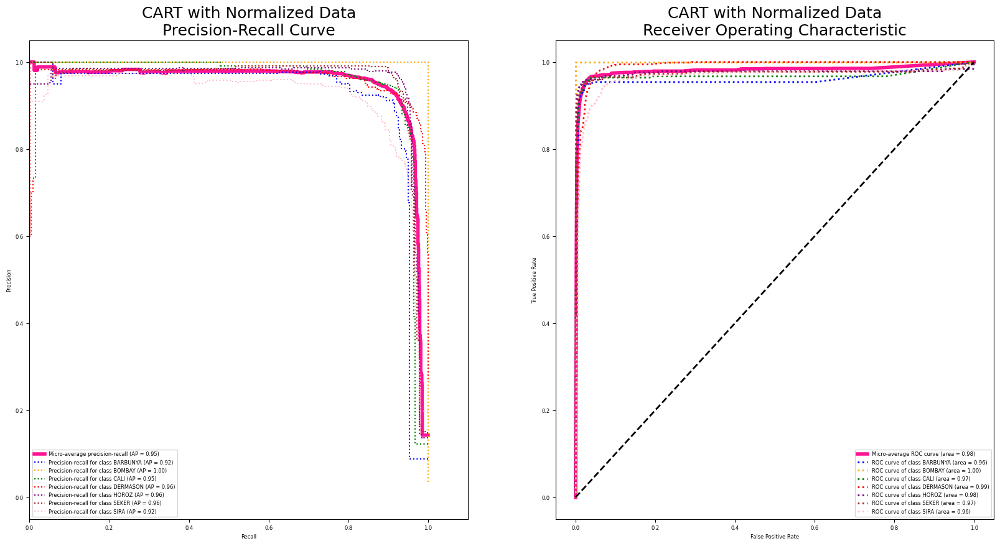

In [116]:
plot_prc_roc_curve(y_score, y_test, class_label_order, "CART with Normalized Data")

- InfoGainAttributeEval

In [117]:
x = data_norm[feature_sel_info_gain]
y = data_norm['Class']
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2)
X_test = X_test.to_numpy()
X_train = X_train.to_numpy()
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()

encoder = LabelBinarizer()
y_1hot2 = encoder.fit_transform(y_test)
class_1hot = np.array([[1,0,0,0,0,0,0], 
         [0,1,0,0,0,0,0], 
         [0,0,1,0,0,0,0], 
         [0,0,0,1,0,0,0], 
         [0,0,0,0,1,0,0], 
         [0,0,0,0,0,1,0], 
         [0,0,0,0,0,0,1]])
class_label_order = encoder.inverse_transform(class_1hot)
print(class_label_order)

['BARBUNYA' 'BOMBAY' 'CALI' 'DERMASON' 'HOROZ' 'SEKER' 'SIRA']


In [118]:
np.seterr(divide='ignore', invalid='ignore')

# max_depth -> may underfit / overfit
rf = OneVsRestClassifier(model_selection.GridSearchCV(tree.DecisionTreeClassifier(random_state=30),
                                 {"max_depth": max_depth,"max_leaf_nodes":max_leaf_nodes, "criterion" : ["entropy", "gini"]}, cv=10, n_jobs=-1))
rf.fit(X_train,y_train)
rf.predict(X_test)
rf.score(X_test,y_test)
# predict from the model
predY = rf.predict(X_test)


# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))



y_score = rf.predict_proba(X_test)
y = label_binarize(y_test, classes=[0, 1, 2, 3, 4, 5 ,6])
n_classes = y.shape[1]

print("=== Best Parameter ===")
for i in range(len(rf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + rf.estimators_[i].best_params_.__str__())

              precision    recall  f1-score   support

    BARBUNYA       0.93      0.89      0.91       267
      BOMBAY       1.00      1.00      1.00       110
        CALI       0.92      0.93      0.93       346
    DERMASON       0.90      0.93      0.92       713
       HOROZ       0.97      0.95      0.96       349
       SEKER       0.93      0.95      0.94       406
        SIRA       0.87      0.84      0.86       532

    accuracy                           0.92      2723
   macro avg       0.93      0.93      0.93      2723
weighted avg       0.92      0.92      0.92      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'criterion': 'gini', 'max_depth': 15, 'max_leaf_nodes': 50}
Classifier for class BOMBAY: {'criterion': 'entropy', 'max_depth': 1, 'max_leaf_nodes': 10}
Classifier for class CALI: {'criterion': 'entropy', 'max_depth': 10, 'max_leaf_nodes': 25}
Classifier for class DERMASON: {'criterion': 'entropy', 'max_depth': 10, 'max_leaf_nodes': 25}
Classifier

In [120]:
# remove nan result
y_test = y_1hot2
a = np.argwhere(np.isnan(y_score))
new = list(set(a[:, 0]))
new.sort()

y_score = np.delete(y_score, new, 0)
y_test = np.delete(y_test, new, 0)
X_test= np.delete(X_test, new, 0)

average: 0.9682170166576595
average2: 0.9920455173299885


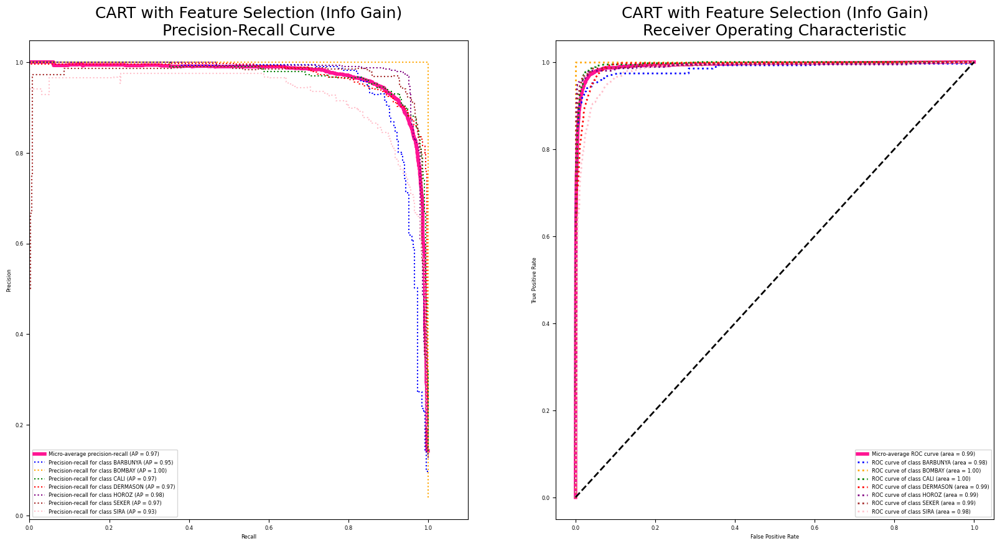

In [121]:
plot_prc_roc_curve(y_score, y_test, class_label_order, "CART with Feature Selection (Info Gain)")

### 2.4.4 Classification with Noisy Data

              precision    recall  f1-score   support

    BARBUNYA       0.92      0.82      0.87       253
      BOMBAY       1.00      0.99      1.00       105
        CALI       0.90      0.91      0.91       322
    DERMASON       0.90      0.90      0.90       723
       HOROZ       0.91      0.95      0.93       379
       SEKER       0.93      0.94      0.93       406
        SIRA       0.81      0.83      0.82       535

    accuracy                           0.89      2723
   macro avg       0.91      0.90      0.91      2723
weighted avg       0.90      0.89      0.89      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'criterion': 'entropy', 'max_depth': 10, 'max_leaf_nodes': 75}
Classifier for class BOMBAY: {'criterion': 'entropy', 'max_depth': 1, 'max_leaf_nodes': 10}
Classifier for class CALI: {'criterion': 'entropy', 'max_depth': 15, 'max_leaf_nodes': 50}
Classifier for class DERMASON: {'criterion': 'gini', 'max_depth': 15, 'max_leaf_nodes': 75}
Classifier

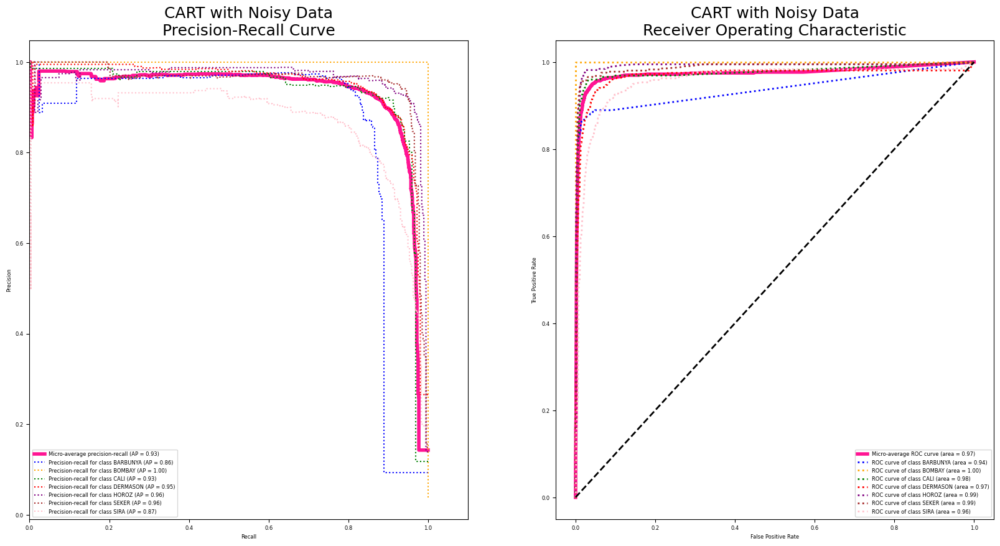

In [122]:
x = data_gaussian[col]
y = data_gaussian['Class']
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2)
X_test = X_test.to_numpy()
X_train = X_train.to_numpy()
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()

encoder = LabelBinarizer()
y_1hot2 = encoder.fit_transform(y_test)
class_1hot = np.array([[1,0,0,0,0,0,0], 
         [0,1,0,0,0,0,0], 
         [0,0,1,0,0,0,0], 
         [0,0,0,1,0,0,0], 
         [0,0,0,0,1,0,0], 
         [0,0,0,0,0,1,0], 
         [0,0,0,0,0,0,1]])
class_label_order = encoder.inverse_transform(class_1hot)

np.seterr(divide='ignore', invalid='ignore')

# max_depth -> may underfit / overfit
rf = OneVsRestClassifier(model_selection.GridSearchCV(tree.DecisionTreeClassifier(random_state=30),
                                 {"max_depth": max_depth,"max_leaf_nodes":max_leaf_nodes, "criterion" : ["entropy", "gini"]}, cv=10, n_jobs=-1))
rf.fit(X_train,y_train)
rf.predict(X_test)
rf.score(X_test,y_test)
# predict from the model
predY = rf.predict(X_test)


# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))



y_score = rf.predict_proba(X_test)
y = label_binarize(y_test, classes=[0, 1, 2, 3, 4, 5 ,6])
n_classes = y.shape[1]

print("=== Best Parameter ===")
for i in range(len(rf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + rf.estimators_[i].best_params_.__str__())

# remove nan result
y_test = y_1hot2
a = np.argwhere(np.isnan(y_score))
new = list(set(a[:, 0]))
new.sort()

y_score = np.delete(y_score, new, 0)
y_test = np.delete(y_test, new, 0)
X_test= np.delete(X_test, new, 0)

plot_prc_roc_curve(y_score, y_test, class_label_order, "CART with Noisy Data")

### 2.4.5 Classification with Combined Data Processing

              precision    recall  f1-score   support

    BARBUNYA       0.93      0.87      0.90       262
      BOMBAY       0.99      1.00      1.00       117
        CALI       0.92      0.93      0.92       343
    DERMASON       0.89      0.94      0.91       730
       HOROZ       0.95      0.95      0.95       377
       SEKER       0.95      0.94      0.94       382
        SIRA       0.86      0.82      0.84       512

    accuracy                           0.91      2723
   macro avg       0.93      0.92      0.92      2723
weighted avg       0.91      0.91      0.91      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'criterion': 'gini', 'max_depth': 10, 'max_leaf_nodes': 75}
Classifier for class BOMBAY: {'criterion': 'entropy', 'max_depth': 1, 'max_leaf_nodes': 10}
Classifier for class CALI: {'criterion': 'entropy', 'max_depth': 15, 'max_leaf_nodes': 75}
Classifier for class DERMASON: {'criterion': 'gini', 'max_depth': 6, 'max_leaf_nodes': 25}
Classifier for

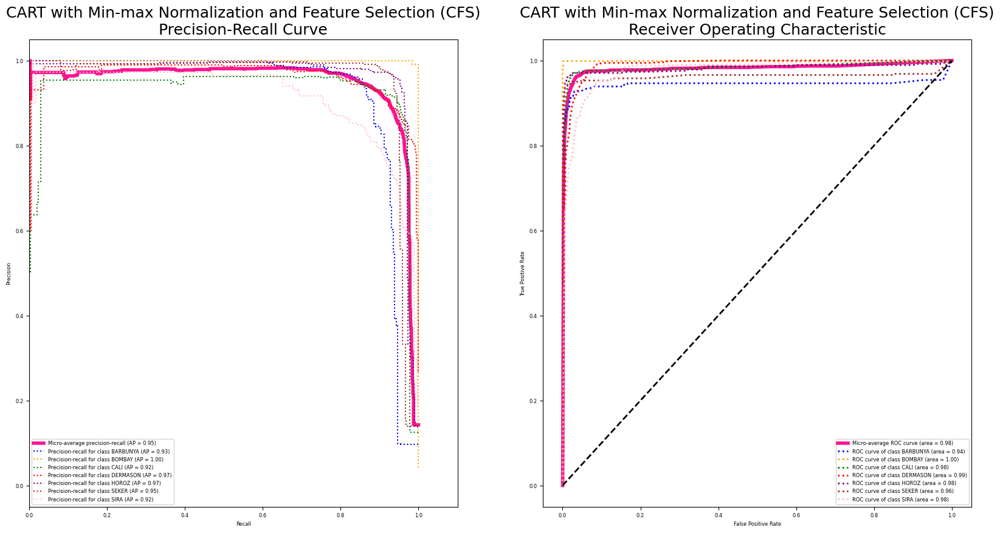

In [123]:
x = data_min_max[feature_sel_cfs]
y = data_min_max['Class']
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2)
X_test = X_test.to_numpy()
X_train = X_train.to_numpy()
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()

encoder = LabelBinarizer()
y_1hot2 = encoder.fit_transform(y_test)
class_1hot = np.array([[1,0,0,0,0,0,0], 
         [0,1,0,0,0,0,0], 
         [0,0,1,0,0,0,0], 
         [0,0,0,1,0,0,0], 
         [0,0,0,0,1,0,0], 
         [0,0,0,0,0,1,0], 
         [0,0,0,0,0,0,1]])
class_label_order = encoder.inverse_transform(class_1hot)

np.seterr(divide='ignore', invalid='ignore')

# max_depth -> may underfit / overfit
rf = OneVsRestClassifier(model_selection.GridSearchCV(tree.DecisionTreeClassifier(random_state=30),
                                 {"max_depth": max_depth,"max_leaf_nodes":max_leaf_nodes, "criterion" : ["entropy", "gini"]}, cv=10, n_jobs=-1))
rf.fit(X_train,y_train)
rf.predict(X_test)
rf.score(X_test,y_test)
# predict from the model
predY = rf.predict(X_test)


# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))



y_score = rf.predict_proba(X_test)
y = label_binarize(y_test, classes=[0, 1, 2, 3, 4, 5 ,6])
n_classes = y.shape[1]

print("=== Best Parameter ===")
for i in range(len(rf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + rf.estimators_[i].best_params_.__str__())

# remove nan result
y_test = y_1hot2
a = np.argwhere(np.isnan(y_score))
new = list(set(a[:, 0]))
new.sort()

y_score = np.delete(y_score, new, 0)
y_test = np.delete(y_test, new, 0)
X_test= np.delete(X_test, new, 0)

plot_prc_roc_curve(y_score, y_test, class_label_order, "CART with Min-max Normalization and Feature Selection (CFS)")

              precision    recall  f1-score   support

    BARBUNYA       0.89      0.88      0.89       296
      BOMBAY       0.99      0.99      0.99        97
        CALI       0.93      0.89      0.91       340
    DERMASON       0.90      0.92      0.91       658
       HOROZ       0.92      0.95      0.94       404
       SEKER       0.95      0.92      0.93       382
        SIRA       0.85      0.86      0.86       546

    accuracy                           0.91      2723
   macro avg       0.92      0.92      0.92      2723
weighted avg       0.91      0.91      0.91      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'criterion': 'entropy', 'max_depth': 15, 'max_leaf_nodes': 75}
Classifier for class BOMBAY: {'criterion': 'entropy', 'max_depth': 1, 'max_leaf_nodes': 10}
Classifier for class CALI: {'criterion': 'entropy', 'max_depth': 15, 'max_leaf_nodes': 50}
Classifier for class DERMASON: {'criterion': 'gini', 'max_depth': 10, 'max_leaf_nodes': 25}
Classifier

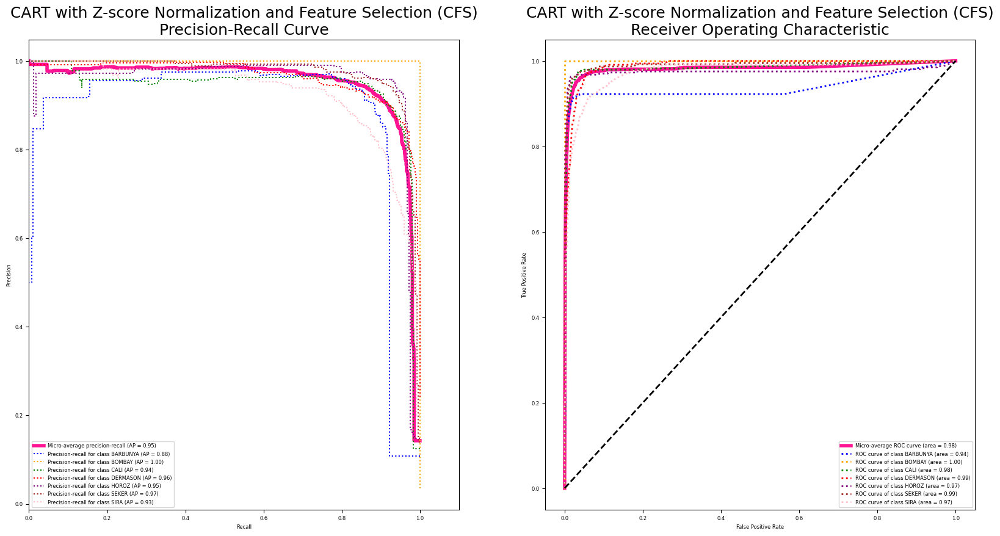

In [124]:
x = data_z_score[feature_sel_cfs]
y = data_z_score['Class']
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2)
X_test = X_test.to_numpy()
X_train = X_train.to_numpy()
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()

encoder = LabelBinarizer()
y_1hot2 = encoder.fit_transform(y_test)
class_1hot = np.array([[1,0,0,0,0,0,0], 
         [0,1,0,0,0,0,0], 
         [0,0,1,0,0,0,0], 
         [0,0,0,1,0,0,0], 
         [0,0,0,0,1,0,0], 
         [0,0,0,0,0,1,0], 
         [0,0,0,0,0,0,1]])
class_label_order = encoder.inverse_transform(class_1hot)

np.seterr(divide='ignore', invalid='ignore')

# max_depth -> may underfit / overfit
rf = OneVsRestClassifier(model_selection.GridSearchCV(tree.DecisionTreeClassifier(random_state=30),
                                 {"max_depth": max_depth,"max_leaf_nodes":max_leaf_nodes, "criterion" : ["entropy", "gini"]}, cv=10, n_jobs=-1))
rf.fit(X_train,y_train)
rf.predict(X_test)
rf.score(X_test,y_test)
# predict from the model
predY = rf.predict(X_test)


# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))



y_score = rf.predict_proba(X_test)
y = label_binarize(y_test, classes=[0, 1, 2, 3, 4, 5 ,6])
n_classes = y.shape[1]

print("=== Best Parameter ===")
for i in range(len(rf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + rf.estimators_[i].best_params_.__str__())

# remove nan result
y_test = y_1hot2
a = np.argwhere(np.isnan(y_score))
new = list(set(a[:, 0]))
new.sort()

y_score = np.delete(y_score, new, 0)
y_test = np.delete(y_test, new, 0)
X_test= np.delete(X_test, new, 0)

plot_prc_roc_curve(y_score, y_test, class_label_order, "CART with Z-score Normalization and Feature Selection (CFS)")

              precision    recall  f1-score   support

    BARBUNYA       0.89      0.84      0.86       273
      BOMBAY       1.00      1.00      1.00        97
        CALI       0.89      0.90      0.90       315
    DERMASON       0.89      0.92      0.91       722
       HOROZ       0.94      0.93      0.93       377
       SEKER       0.94      0.94      0.94       412
        SIRA       0.83      0.82      0.83       527

    accuracy                           0.90      2723
   macro avg       0.91      0.91      0.91      2723
weighted avg       0.90      0.90      0.90      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'criterion': 'gini', 'max_depth': 15, 'max_leaf_nodes': 50}
Classifier for class BOMBAY: {'criterion': 'entropy', 'max_depth': 1, 'max_leaf_nodes': 10}
Classifier for class CALI: {'criterion': 'entropy', 'max_depth': 10, 'max_leaf_nodes': 50}
Classifier for class DERMASON: {'criterion': 'gini', 'max_depth': 10, 'max_leaf_nodes': 25}
Classifier fo

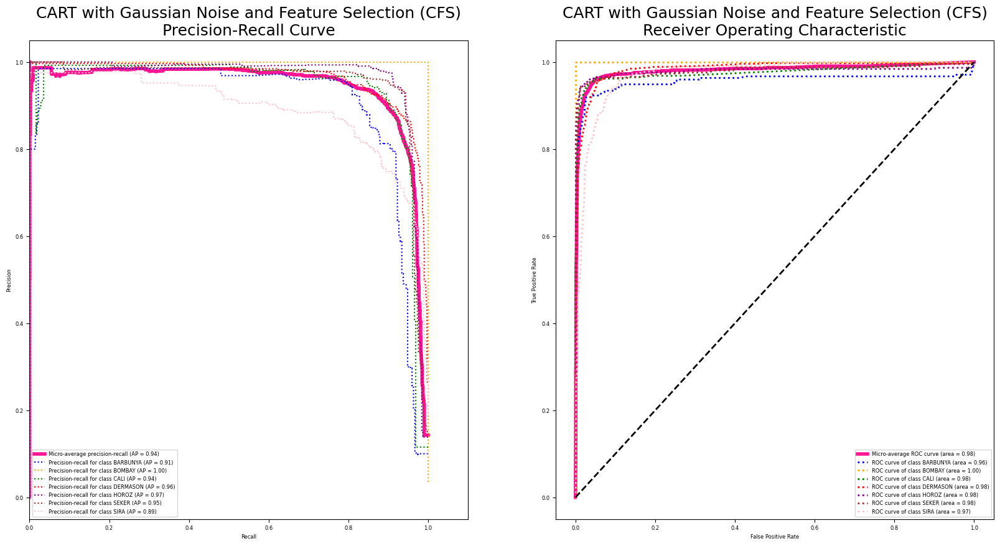

In [125]:
x = data_gaussian[feature_sel_cfs]
y = data_gaussian['Class']
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2)
X_test = X_test.to_numpy()
X_train = X_train.to_numpy()
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()

encoder = LabelBinarizer()
y_1hot2 = encoder.fit_transform(y_test)
class_1hot = np.array([[1,0,0,0,0,0,0], 
         [0,1,0,0,0,0,0], 
         [0,0,1,0,0,0,0], 
         [0,0,0,1,0,0,0], 
         [0,0,0,0,1,0,0], 
         [0,0,0,0,0,1,0], 
         [0,0,0,0,0,0,1]])
class_label_order = encoder.inverse_transform(class_1hot)

np.seterr(divide='ignore', invalid='ignore')

# max_depth -> may underfit / overfit
rf = OneVsRestClassifier(model_selection.GridSearchCV(tree.DecisionTreeClassifier(random_state=30),
                                 {"max_depth": max_depth,"max_leaf_nodes":max_leaf_nodes, "criterion" : ["entropy", "gini"]}, cv=10, n_jobs=-1))
rf.fit(X_train,y_train)
rf.predict(X_test)
rf.score(X_test,y_test)
# predict from the model
predY = rf.predict(X_test)


# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))



y_score = rf.predict_proba(X_test)
y = label_binarize(y_test, classes=[0, 1, 2, 3, 4, 5 ,6])
n_classes = y.shape[1]

print("=== Best Parameter ===")
for i in range(len(rf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + rf.estimators_[i].best_params_.__str__())

# remove nan result
y_test = y_1hot2
a = np.argwhere(np.isnan(y_score))
new = list(set(a[:, 0]))
new.sort()

y_score = np.delete(y_score, new, 0)
y_test = np.delete(y_test, new, 0)
X_test= np.delete(X_test, new, 0)

plot_prc_roc_curve(y_score, y_test, class_label_order, "CART with Gaussian Noise and Feature Selection (CFS)")

              precision    recall  f1-score   support

    BARBUNYA       0.86      0.83      0.85       251
      BOMBAY       1.00      1.00      1.00        95
        CALI       0.88      0.87      0.87       313
    DERMASON       0.89      0.93      0.91       698
       HOROZ       0.95      0.94      0.94       418
       SEKER       0.93      0.93      0.93       428
        SIRA       0.85      0.83      0.84       520

    accuracy                           0.90      2723
   macro avg       0.91      0.90      0.91      2723
weighted avg       0.90      0.90      0.90      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'criterion': 'gini', 'max_depth': 10, 'max_leaf_nodes': 25}
Classifier for class BOMBAY: {'criterion': 'entropy', 'max_depth': 1, 'max_leaf_nodes': 10}
Classifier for class CALI: {'criterion': 'entropy', 'max_depth': 10, 'max_leaf_nodes': 50}
Classifier for class DERMASON: {'criterion': 'entropy', 'max_depth': 10, 'max_leaf_nodes': 50}
Classifier

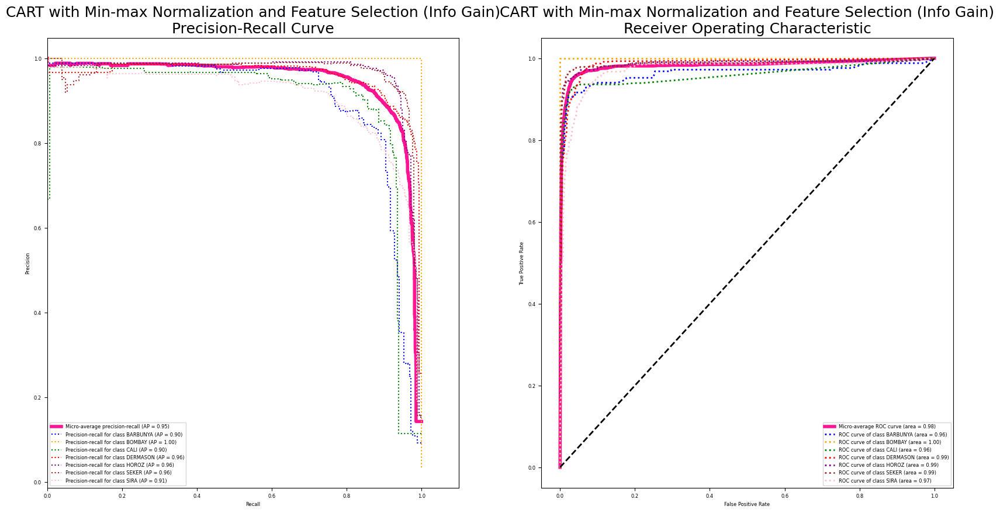

In [126]:
x = data_min_max[feature_sel_info_gain]
y = data_min_max['Class']
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2)
X_test = X_test.to_numpy()
X_train = X_train.to_numpy()
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()

encoder = LabelBinarizer()
y_1hot2 = encoder.fit_transform(y_test)
class_1hot = np.array([[1,0,0,0,0,0,0], 
         [0,1,0,0,0,0,0], 
         [0,0,1,0,0,0,0], 
         [0,0,0,1,0,0,0], 
         [0,0,0,0,1,0,0], 
         [0,0,0,0,0,1,0], 
         [0,0,0,0,0,0,1]])
class_label_order = encoder.inverse_transform(class_1hot)

np.seterr(divide='ignore', invalid='ignore')

# max_depth -> may underfit / overfit
rf = OneVsRestClassifier(model_selection.GridSearchCV(tree.DecisionTreeClassifier(random_state=30),
                                 {"max_depth": max_depth,"max_leaf_nodes":max_leaf_nodes, "criterion" : ["entropy", "gini"]}, cv=10, n_jobs=-1))
rf.fit(X_train,y_train)
rf.predict(X_test)
rf.score(X_test,y_test)
# predict from the model
predY = rf.predict(X_test)


# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))



y_score = rf.predict_proba(X_test)
y = label_binarize(y_test, classes=[0, 1, 2, 3, 4, 5 ,6])
n_classes = y.shape[1]

print("=== Best Parameter ===")
for i in range(len(rf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + rf.estimators_[i].best_params_.__str__())

# remove nan result
y_test = y_1hot2
a = np.argwhere(np.isnan(y_score))
new = list(set(a[:, 0]))
new.sort()

y_score = np.delete(y_score, new, 0)
y_test = np.delete(y_test, new, 0)
X_test= np.delete(X_test, new, 0)

plot_prc_roc_curve(y_score, y_test, class_label_order, "CART with Min-max Normalization and Feature Selection (Info Gain)")

              precision    recall  f1-score   support

    BARBUNYA       0.89      0.86      0.87       285
      BOMBAY       1.00      1.00      1.00       106
        CALI       0.91      0.91      0.91       351
    DERMASON       0.93      0.91      0.92       721
       HOROZ       0.95      0.92      0.94       374
       SEKER       0.94      0.97      0.96       401
        SIRA       0.85      0.87      0.86       485

    accuracy                           0.91      2723
   macro avg       0.92      0.92      0.92      2723
weighted avg       0.91      0.91      0.91      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'criterion': 'entropy', 'max_depth': 6, 'max_leaf_nodes': 25}
Classifier for class BOMBAY: {'criterion': 'entropy', 'max_depth': 1, 'max_leaf_nodes': 10}
Classifier for class CALI: {'criterion': 'entropy', 'max_depth': 10, 'max_leaf_nodes': 25}
Classifier for class DERMASON: {'criterion': 'gini', 'max_depth': 6, 'max_leaf_nodes': 10}
Classifier f

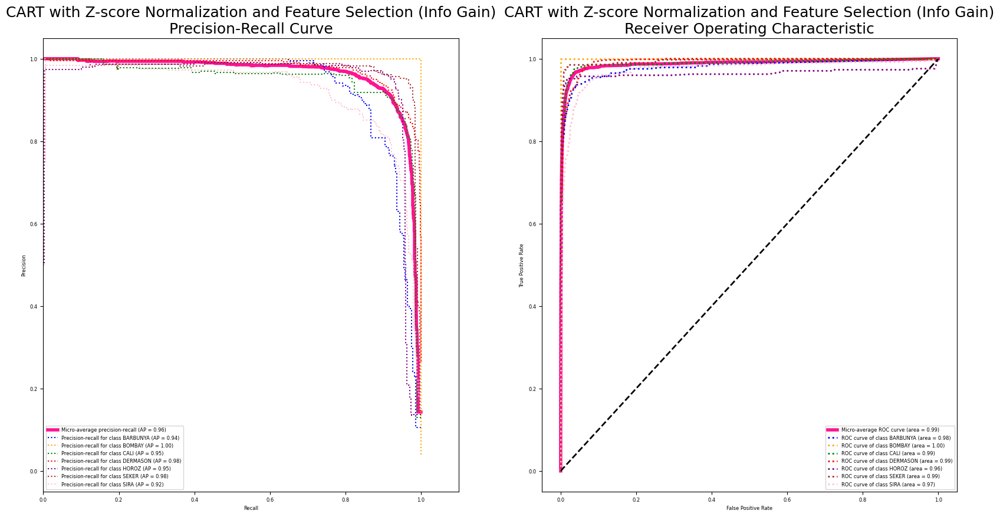

In [127]:
x = data_z_score[feature_sel_info_gain]
y = data_z_score['Class']
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2)
X_test = X_test.to_numpy()
X_train = X_train.to_numpy()
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()

encoder = LabelBinarizer()
y_1hot2 = encoder.fit_transform(y_test)
class_1hot = np.array([[1,0,0,0,0,0,0], 
         [0,1,0,0,0,0,0], 
         [0,0,1,0,0,0,0], 
         [0,0,0,1,0,0,0], 
         [0,0,0,0,1,0,0], 
         [0,0,0,0,0,1,0], 
         [0,0,0,0,0,0,1]])
class_label_order = encoder.inverse_transform(class_1hot)

np.seterr(divide='ignore', invalid='ignore')

# max_depth -> may underfit / overfit
rf = OneVsRestClassifier(model_selection.GridSearchCV(tree.DecisionTreeClassifier(random_state=30),
                                 {"max_depth": max_depth,"max_leaf_nodes":max_leaf_nodes, "criterion" : ["entropy", "gini"]}, cv=10, n_jobs=-1))
rf.fit(X_train,y_train)
rf.predict(X_test)
rf.score(X_test,y_test)
# predict from the model
predY = rf.predict(X_test)


# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))



y_score = rf.predict_proba(X_test)
y = label_binarize(y_test, classes=[0, 1, 2, 3, 4, 5 ,6])
n_classes = y.shape[1]

print("=== Best Parameter ===")
for i in range(len(rf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + rf.estimators_[i].best_params_.__str__())

# remove nan result
y_test = y_1hot2
a = np.argwhere(np.isnan(y_score))
new = list(set(a[:, 0]))
new.sort()

y_score = np.delete(y_score, new, 0)
y_test = np.delete(y_test, new, 0)
X_test= np.delete(X_test, new, 0)

plot_prc_roc_curve(y_score, y_test, class_label_order, "CART with Z-score Normalization and Feature Selection (Info Gain)")

              precision    recall  f1-score   support

    BARBUNYA       0.90      0.80      0.85       284
      BOMBAY       1.00      1.00      1.00       120
        CALI       0.88      0.90      0.89       329
    DERMASON       0.91      0.90      0.91       705
       HOROZ       0.93      0.93      0.93       366
       SEKER       0.94      0.94      0.94       385
        SIRA       0.81      0.85      0.83       534

    accuracy                           0.90      2723
   macro avg       0.91      0.90      0.91      2723
weighted avg       0.90      0.90      0.90      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'criterion': 'gini', 'max_depth': 10, 'max_leaf_nodes': 25}
Classifier for class BOMBAY: {'criterion': 'entropy', 'max_depth': 1, 'max_leaf_nodes': 10}
Classifier for class CALI: {'criterion': 'gini', 'max_depth': 10, 'max_leaf_nodes': 25}
Classifier for class DERMASON: {'criterion': 'gini', 'max_depth': 10, 'max_leaf_nodes': 25}
Classifier for c

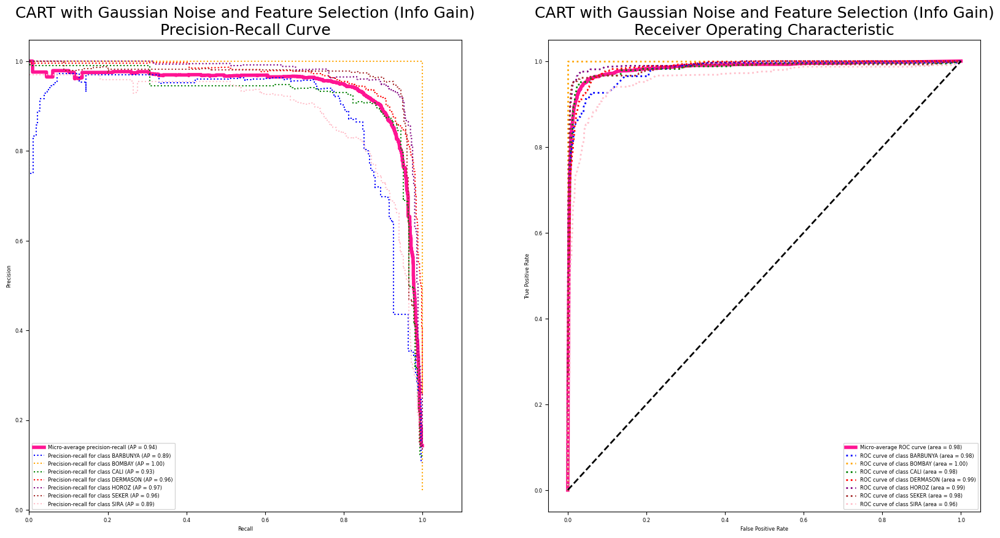

In [129]:
x = data_gaussian[feature_sel_info_gain]
y = data_gaussian['Class']
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2)
X_test = X_test.to_numpy()
X_train = X_train.to_numpy()
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()

encoder = LabelBinarizer()
y_1hot2 = encoder.fit_transform(y_test)
class_1hot = np.array([[1,0,0,0,0,0,0], 
         [0,1,0,0,0,0,0], 
         [0,0,1,0,0,0,0], 
         [0,0,0,1,0,0,0], 
         [0,0,0,0,1,0,0], 
         [0,0,0,0,0,1,0], 
         [0,0,0,0,0,0,1]])
class_label_order = encoder.inverse_transform(class_1hot)

np.seterr(divide='ignore', invalid='ignore')

# max_depth -> may underfit / overfit
rf = OneVsRestClassifier(model_selection.GridSearchCV(tree.DecisionTreeClassifier(random_state=30),
                                 {"max_depth": max_depth,"max_leaf_nodes":max_leaf_nodes, "criterion" : ["entropy", "gini"]}, cv=10, n_jobs=-1))
rf.fit(X_train,y_train)
rf.predict(X_test)
rf.score(X_test,y_test)
# predict from the model
predY = rf.predict(X_test)


# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))



y_score = rf.predict_proba(X_test)
y = label_binarize(y_test, classes=[0, 1, 2, 3, 4, 5 ,6])
n_classes = y.shape[1]

print("=== Best Parameter ===")
for i in range(len(rf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + rf.estimators_[i].best_params_.__str__())

# remove nan result
y_test = y_1hot2
a = np.argwhere(np.isnan(y_score))
new = list(set(a[:, 0]))
new.sort()

y_score = np.delete(y_score, new, 0)
y_test = np.delete(y_test, new, 0)
X_test= np.delete(X_test, new, 0)

plot_prc_roc_curve(y_score, y_test, class_label_order, "CART with Gaussian Noise and Feature Selection (Info Gain)")

### 2.4.6 Classification with SMOTE and feature selection / z-score

              precision    recall  f1-score   support

    BARBUNYA       0.96      0.93      0.95       711
      BOMBAY       1.00      1.00      1.00       725
        CALI       0.94      0.96      0.95       697
    DERMASON       0.92      0.91      0.92       730
       HOROZ       0.98      0.96      0.97       747
       SEKER       0.94      0.96      0.95       669
        SIRA       0.86      0.89      0.87       686

    accuracy                           0.94      4965
   macro avg       0.94      0.94      0.94      4965
weighted avg       0.94      0.94      0.94      4965

=== Best Parameter ===
Classifier for class BARBUNYA: {'criterion': 'entropy', 'max_depth': 15, 'max_leaf_nodes': 100}
Classifier for class BOMBAY: {'criterion': 'entropy', 'max_depth': 1, 'max_leaf_nodes': 10}
Classifier for class CALI: {'criterion': 'gini', 'max_depth': 10, 'max_leaf_nodes': 100}
Classifier for class DERMASON: {'criterion': 'gini', 'max_depth': 10, 'max_leaf_nodes': 50}
Classifier 

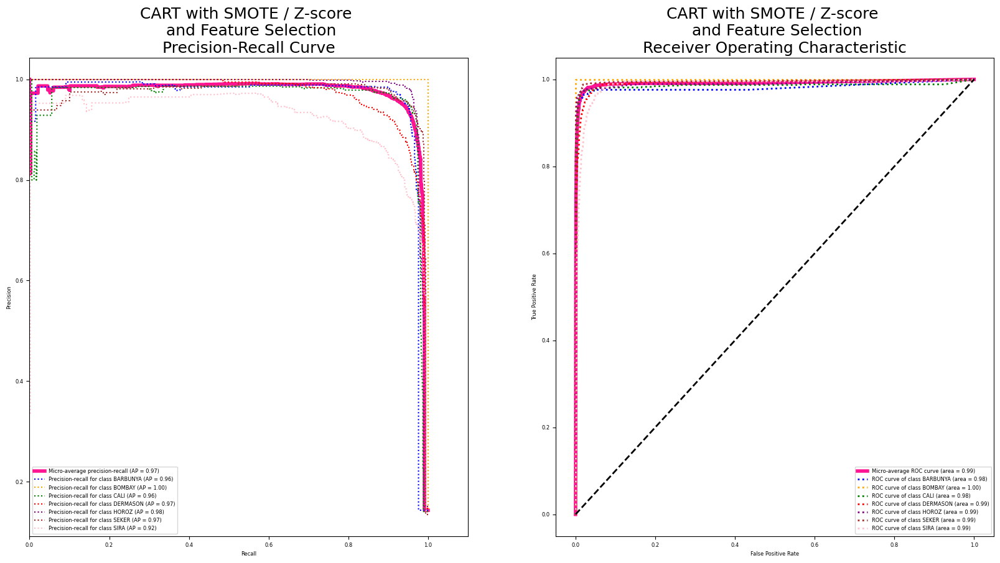

In [130]:
x = data_smote.drop('Class', axis= 1)
y = data_smote['Class']
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2)
X_test = X_test.to_numpy()
X_train = X_train.to_numpy()
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()

encoder = LabelBinarizer()
y_1hot2 = encoder.fit_transform(y_test)
class_1hot = np.array([[1,0,0,0,0,0,0], 
         [0,1,0,0,0,0,0], 
         [0,0,1,0,0,0,0], 
         [0,0,0,1,0,0,0], 
         [0,0,0,0,1,0,0], 
         [0,0,0,0,0,1,0], 
         [0,0,0,0,0,0,1]])
class_label_order = encoder.inverse_transform(class_1hot)

np.seterr(divide='ignore', invalid='ignore')

# max_depth -> may underfit / overfit
rf = OneVsRestClassifier(model_selection.GridSearchCV(tree.DecisionTreeClassifier(random_state=30),
                                 {"max_depth": max_depth,"max_leaf_nodes":max_leaf_nodes, "criterion" : ["entropy", "gini"]}, cv=10, n_jobs=-1))
rf.fit(X_train,y_train)
rf.predict(X_test)
rf.score(X_test,y_test)
# predict from the model
predY = rf.predict(X_test)


# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))



y_score = rf.predict_proba(X_test)
y = label_binarize(y_test, classes=[0, 1, 2, 3, 4, 5 ,6])
n_classes = y.shape[1]

print("=== Best Parameter ===")
for i in range(len(rf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + rf.estimators_[i].best_params_.__str__())

# remove nan result
y_test = y_1hot2
a = np.argwhere(np.isnan(y_score))
new = list(set(a[:, 0]))
new.sort()

y_score = np.delete(y_score, new, 0)
y_test = np.delete(y_test, new, 0)
X_test= np.delete(X_test, new, 0)

plot_prc_roc_curve(y_score, y_test, class_label_order, "CART with SMOTE / Z-score \n and Feature Selection")

## 2.5. Support Vector Machine

In [8]:
params = {'C': [0.01, 0.1, 1],
          'gamma': [0.01, 0.1]}

X_train, X_test, y_train, y_test = train_test_split(data[col], y_1hot,test_size=0.2)
clf = OneVsRestClassifier(model_selection.GridSearchCV(svm.SVC(random_state=9909), params, cv=5, n_jobs=-1))
clf.fit(X_train, y_train)

# predict from the model
predY = clf.predict(X_test)

# calculate accuracy
acc = metrics.accuracy_score(y_test, predY)
print(classification_report(y_test, predY))
y_score = clf.decision_function(X_test)

print("=== Best Parameter ===")
for i in range(len(clf.estimators_)):
    print("Classifier for class "+ class_label_order[i]+ ": " + clf.estimators_[i].best_params_.__str__())


/Users/nomoney/opt/anaconda3/envs/tf/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/nomoney/opt/anaconda3/envs/tf/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.00      0.00      0.00       268
           1       0.00      0.00      0.00       100
           2       0.00      0.00      0.00       340
           3       0.91      0.03      0.06       723
           4       1.00      0.04      0.08       375
           5       1.00      0.01      0.02       410
           6       0.50      0.00      0.01       507

   micro avg       0.92      0.02      0.03      2723
   macro avg       0.49      0.01      0.02      2723
weighted avg       0.62      0.02      0.03      2723
 samples avg       0.02      0.02      0.02      2723

=== Best Parameter ===
Classifier for class BARBUNYA: {'C': 0.01, 'gamma': 0.01}
Classifier for class BOMBAY: {'C': 0.01, 'gamma': 0.01}
Classifier for class CALI: {'C': 0.01, 'gamma': 0.01}
Classifier for class DERMASON: {'C': 1, 'gamma': 0.01}
Classifier for class HOROZ: {'C': 1, 'gamma': 0.01}
Classifier for class SEKER: {'C': 1, 'gamma': 0.01}

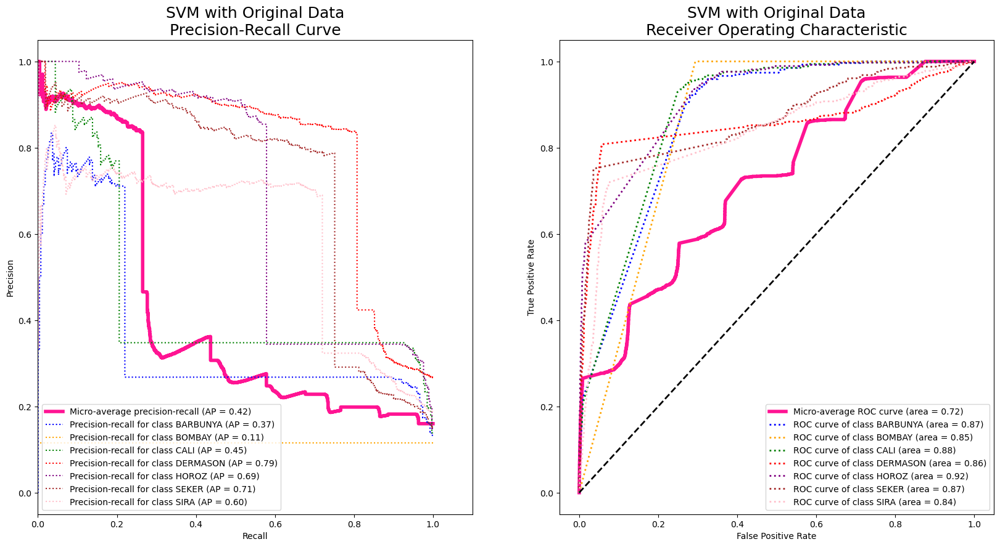

In [9]:
plot_prc_roc_curve(y_score, y_test, class_label_order, "SVM with Original Data")

# 3 Extra Visualization

## 3.1 helper function

In [21]:
plotData = pd.read_csv("dataset/plotdata_prc.csv")

In [78]:
from matplotlib.pyplot import figure
def plotCompare(data, title):
    plt.tight_layout()
    objects = range(13)
    label = ["Original", "Z-score", "MinMax", "CFS", "Infogain", "Noisy", "MinMax&CFS", "Zscore&CFS", "Noise&CFS", "MinMax&Infogain", "Score&Infogain", "Noise&Infogain", "SMOTE, zscore \nand feature selection"]
    y_pos = np.arange(len(objects))
    performance = data
    max_y_lim = max(performance) + .003
    min_y_lim = min(performance)
    plt.ylim(min_y_lim, max_y_lim)
    plt.bar(y_pos, performance, align='center', alpha=0.5, width=0.5)
    plt.xticks(y_pos, label)
    plt.xticks(rotation=70)
    y = performance.to_numpy().tolist()
    for i in range(len(performance)):
        plt.text(i,round(y[i],4) ,round(y[i], 4), ha = 'center')
    plt.ylabel('PRC')
    plt.title(title, {'size':'16'})
    # plt.rcParams['font.size'] = 12
    # plt.rcParams.update({'font.size': 6})
    figure(figsize=(10, 6), dpi=300)


    plt.show()

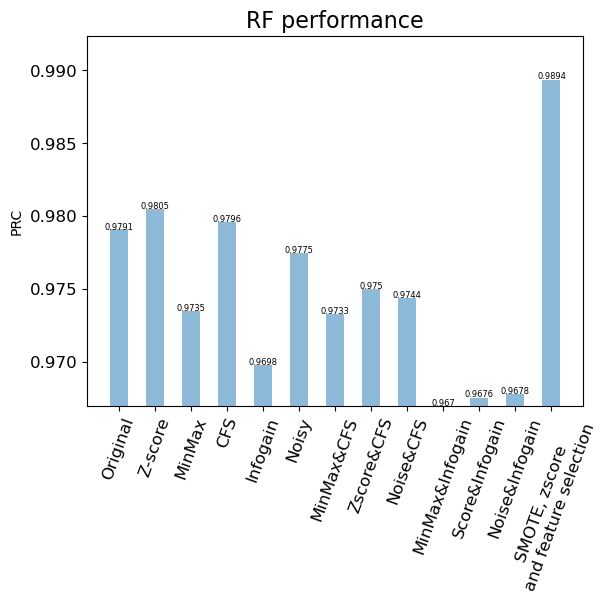

<Figure size 3000x1800 with 0 Axes>

In [79]:
plotCompare(plotData["rf"], 'RF performance')

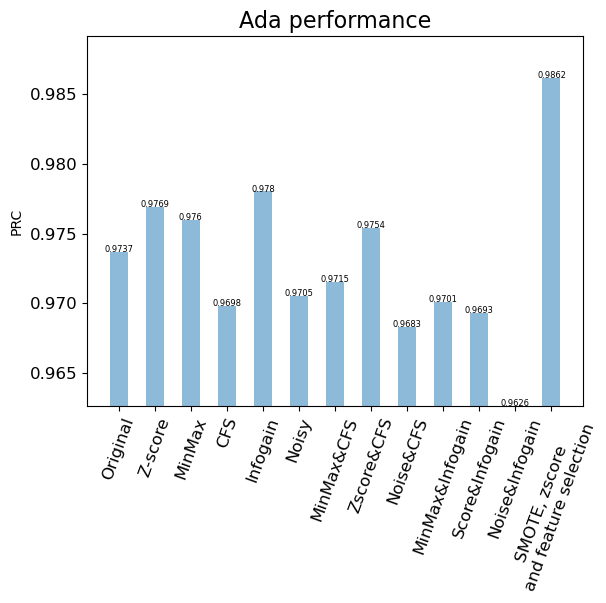

<Figure size 3000x1800 with 0 Axes>

In [80]:
plotCompare(plotData["ada"], 'Ada performance')

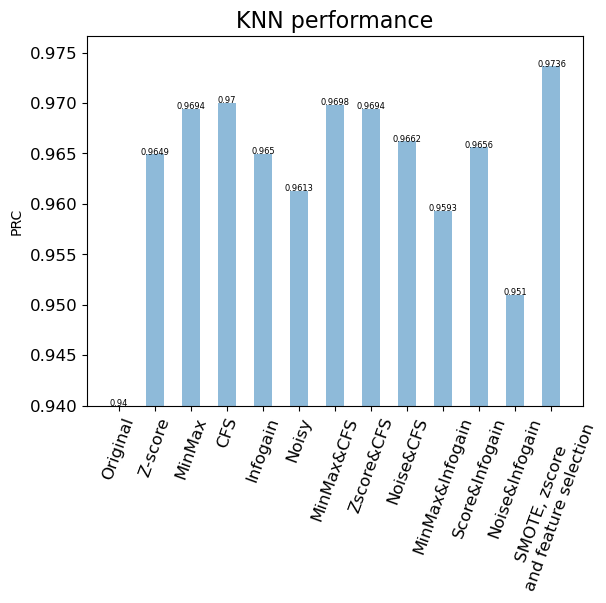

<Figure size 3000x1800 with 0 Axes>

In [81]:
min(plotData["knn"])
plotData["knn"][0] = 0.94
plotCompare(plotData["knn"], 'KNN performance')

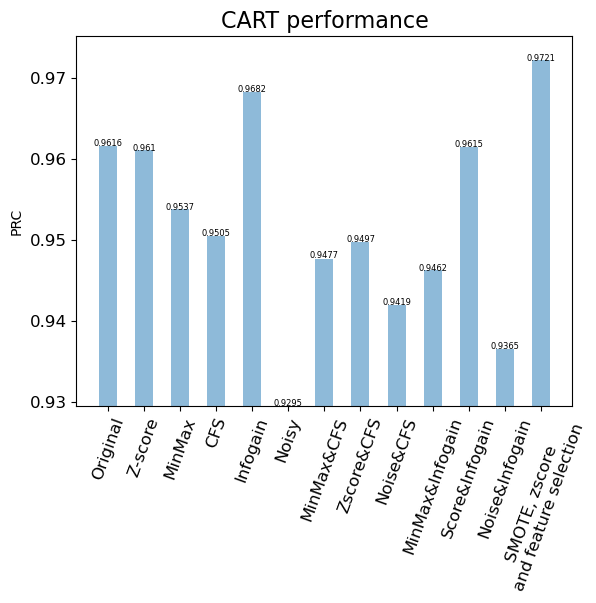

<Figure size 3000x1800 with 0 Axes>

In [82]:
#min(plotData["knn"])
#plotData["knn"][0] = 0.94
plotCompare(plotData["cart"], 'CART performance')